# **Exploratory Data Analysis of the Global Terrorism Database**
### 1. **Introduction**
This report presents a comprehensive Exploratory Data Analysis (EDA) of the Global Terrorism Database (GTD). The primary objective is to uncover and visualize key patterns, trends, and hotspots in global terrorism from 1970 to 2020.

### 2. **About the Dataset**
The Global Terrorism Database (GTD) is a comprehensive open-source database of terrorist incidents worldwide, maintained by the National Consortium for the Study of Terrorism and Responses to Terrorism (START). Each record in the dataset represents a single terrorist event and contains detailed attributes, including:

- ***Year, Month:*** Temporal data indicating when the incident occurred.
- ***Country, Region:*** Geographical data specifying the location of the incident.
- ***Latitude, Longitude:*** Coordinates for precise location mapping.
- ***AttackType:*** Type of attack (e.g., Bombing/Explosion, Armed Assault).
- ***TargetType:*** Target of the attack (e.g., Civilians, Military).
- ***WeaponType:*** Weapon used (e.g., Explosives, Firearms).
- ***suicide:*** Binary indicator (1 for suicide attacks, 0 otherwise).
- ***GroupName:*** Terrorist group responsible (or "Unknown").

#
 This dataset is critical for understanding global terrorism trends, identifying hotspots, and informing counter-terrorism strategies.
#### **Purpose of EDA**
Exploratory Data Analysis (EDA) is the process of summarizing and visualizing data to uncover patterns, trends, and anomalies. For this dataset, EDA helps:
- Identify temporal trends in terrorism incidents.
- Highlight geographical hotspots (countries and regions).
- Analyze the distribution of attack types, targets, and responsible groups.
- Assess the prevalence of suicide attacks.
- Prepare the data for machine learning by identifying missing values and feature engineering opportunities.

EDA is essential before building machine learning models to ensure data quality and inform feature selection.


In [2]:
# --- 1. SETUP LIBRARIES ---
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

# Set a clean and modern plot style
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams['figure.figsize'] = (14, 8) # Set default figure size
plt.rcParams['font.size'] = 12 # Set default font size


### **3. Data Preparation and Feature Engineering**
#
Before visualizing the data, we clean and preprocess it to ensure accuracy:
- **Data Cleaning**: Convert suicide to an integer (0/1), ensure Latitude and Longitude are numeric, and handle "Unknown" in GroupName by renaming it to "Unknown_Group" to treat it as a distinct category.
- **Missing Values**: Impute missing Latitude and Longitude with their medians to preserve geographical data.
- **Feature Engineering**: Create a Decade column from Year to analyze trends over larger time periods, which helps reveal long-term patterns (e.g., shifts in terrorism activity across decades).

This step ensures the data is ready for visualization and future machine learning tasks by addressing inconsistencies and adding meaningful features

In [3]:
# =============================================================================
# --- 2. LOAD AND INSPECT THE CLEANED DATA ---
# =============================================================================
print("--- Loading and verifying the cleaned dataset ---")

# Load the cleaned CSV file
df = pd.read_csv('Cleaned Dataset/globalterrorismdb_cleaned.csv')
print("Cleaned dataset loaded successfully.")

# Print the dimensions (rows, columns)
print(f"\nThe cleaned dataset has {df.shape[0]:,} rows and {df.shape[1]} columns.")

# Display the first 5 rows to see the format
print("\nFirst 5 rows of the cleaned dataset:")
print(df.head())

# Display a concise summary to confirm data types and non-null counts
print("\nData types and non-null counts:")
df.info()

--- Loading and verifying the cleaned dataset ---
Cleaned dataset loaded successfully.

The cleaned dataset has 209,706 rows and 11 columns.

First 5 rows of the cleaned dataset:
   Year  Month             Country                       Region   Latitude  \
0  1970      7  Dominican Republic  Central America & Caribbean  18.456792   
1  1970      0              Mexico                North America  19.371887   
2  1970      1         Philippines               Southeast Asia  15.478598   
3  1970      1              Greece               Western Europe  37.997490   
4  1970      1               Japan                    East Asia  33.580412   

    Longitude                      AttackType                   TargetType  \
0  -69.951164                   Assassination  Private Citizens & Property   
1  -99.086624     Hostage Taking (Kidnapping)      Government (Diplomatic)   
2  120.599741                   Assassination          Journalists & Media   
3   23.762728               Bombing/Expl

In [ ]:
# =============================================================================
# --- 3. DATA PREPARATION & FEATURE ENGINEERING ---
# =============================================================================
print("\n--- Preparing Data for Analysis ---")
# Ensure data types are correct and handle minor inconsistencies
df['suicide'] = df['suicide'].astype(int)
df['Latitude'] = pd.to_numeric(df['Latitude'], errors='coerce')
df['Longitude'] = pd.to_numeric(df['Longitude'], errors='coerce')
df['GroupName'] = df['GroupName'].replace('Unknown', 'Unknown_Group')

# Handle any remaining missing values in key columns
df['Latitude'].fillna(df['Latitude'].median(), inplace=True)
df['Longitude'].fillna(df['Longitude'].median(), inplace=True)

# Feature engineering: Create a 'Decade' column
df['Decade'] = (df['Year'] // 10) * 10
print("Data preparation and feature engineering complete.")


--- Preparing Data for Analysis ---
Data preparation and feature engineering complete.


C:\Users\Ayush Gupte\AppData\Local\Temp\ipykernel_17640\4147919800.py:12: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Latitude'].fillna(df['Latitude'].median(), inplace=True)
C:\Users\Ayush Gupte\AppData\Local\Temp\ipykernel_17640\4147919800.py:13: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always b

### **4. Summary Statistics**
#
Summary statistics provide a quick overview of the dataset's numerical and categorical features:
- **Numerical Columns (Year, Month, Latitude, Longitude, suicide)**: Show central tendencies (mean, median) and ranges to understand the spread of incidents over time and geography.
- **Categorical Columns (Country, Region, AttackType, TargetType, WeaponType, GroupName)**: Display unique values and frequencies to identify dominant categories (e.g., most common countries or attack types).
- **Missing Values**: Check for any remaining null values to ensure data quality.
#
This step helps confirm the dataset's structure and identify any anomalies before visualization.

In [27]:
# =============================================================================
# --- 4. SUMMARY STATISTICS ---
# =============================================================================
print("\n--- Dataset Summary Statistics ---")
print(df.describe(include='all'))

print("\n--- Final Check for Missing Values ---")
missing_vals = df.isnull().sum()
print(missing_vals[missing_vals > 0])



--- Dataset Summary Statistics ---
                 Year          Month Country                      Region  \
count   209706.000000  209706.000000  209706                      209706   
unique            NaN            NaN     204                          12   
top               NaN            NaN    Iraq  Middle East & North Africa   
freq              NaN            NaN   27521                       58252   
mean      2004.800993       6.455285     NaN                         NaN   
std         13.519321       3.387098     NaN                         NaN   
min       1970.000000       0.000000     NaN                         NaN   
25%       1992.000000       4.000000     NaN                         NaN   
50%       2012.000000       6.000000     NaN                         NaN   
75%       2015.000000       9.000000     NaN                         NaN   
max       2020.000000      12.000000     NaN                         NaN   

             Latitude      Longitude         Attack

### **5. Visualization and Insights**
A series of visualizations were created to explore the data from different perspectives.

**a. Terrorism Incidents by Year (Line Plot)**
- ***Justification:*** A line plot is the ideal choice for visualizing trends over a continuous time interval, clearly showing peaks, troughs, and long-term patterns.

- ***Key Insights:***

   - The data reveals a dramatic spike in terrorist incidents starting after 2001, reaching an unprecedented peak around 2014.

   - Following this peak, there has been a notable decline in the number of annual incidents, though levels remain significantly higher than in the 20th century.


--- Generating Visualizations ---
Generating plot 1: Incidents by Year...


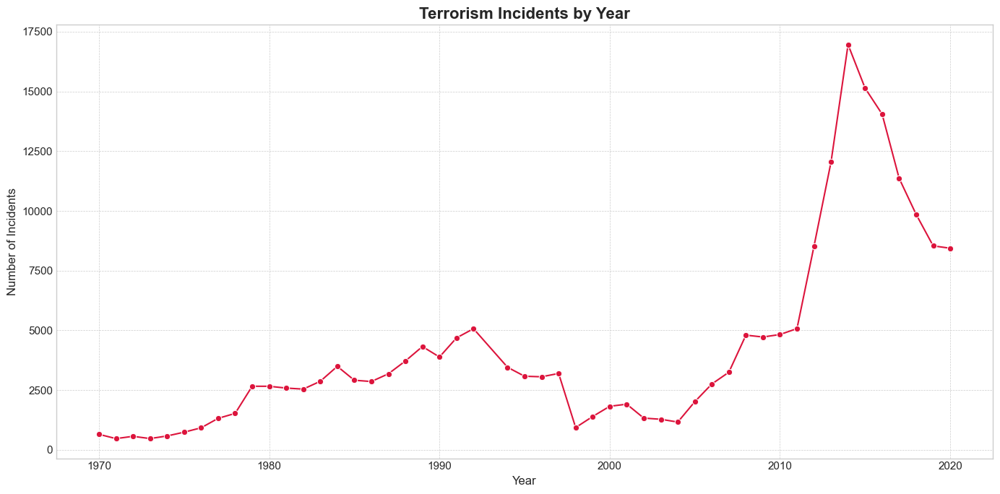

In [35]:
# =============================================================================
# --- 5. EXPLORATORY DATA VISUALIZATION ---
# =============================================================================
print("\n--- Generating Visualizations ---")

# 1. Line Plot: Incidents per Year
print("Generating plot 1: Incidents by Year...")
yearly_counts = df['Year'].value_counts().sort_index()
plt.figure(figsize=(14, 7))
sns.lineplot(x=yearly_counts.index, y=yearly_counts.values, marker='o', color='crimson')
plt.title('Terrorism Incidents by Year', fontsize=16, fontweight='bold')
plt.xlabel('Year', fontsize=12)
plt.ylabel('Number of Incidents', fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

**b. Top 10 Countries by Incidents (Bar Plot)**
- ***Justification:*** A horizontal bar chart is excellent for comparing the magnitude of different categories, making it easy to rank countries by the number of attacks.

- ***Key Insights:***

   - Iraq stands out as the country most affected by terrorism by a significant margin.

   - The top countries most affected—Iraq, Pakistan, Afghanistan, and India—are all located in the Middle East and South Asia, highlighting these regions as the primary epicenters of modern terrorist activity.

Generating plot 2: Top 10 Countries...


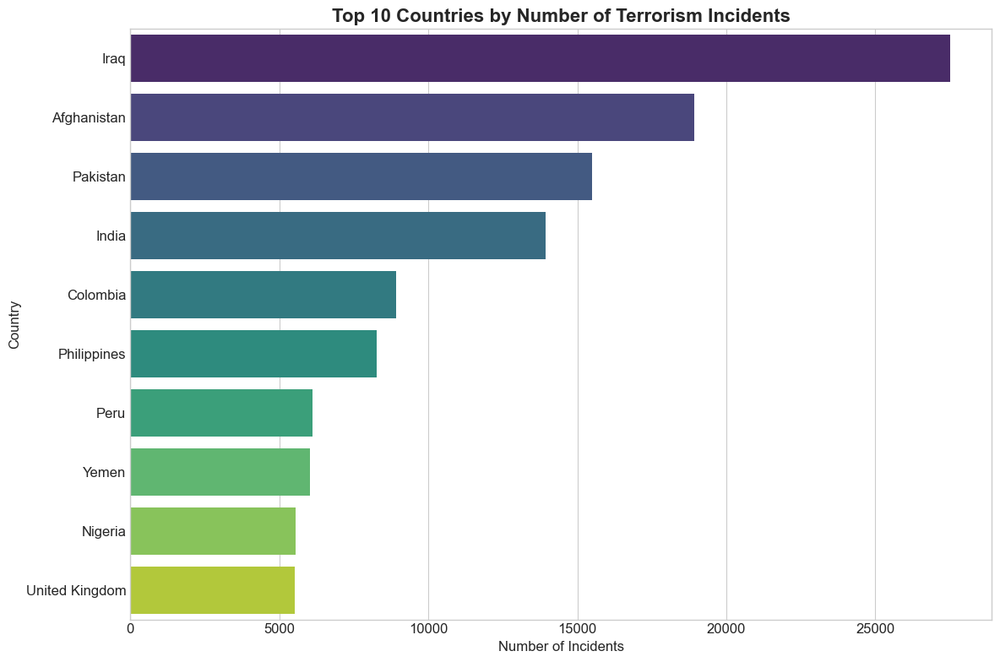

In [5]:
# 2. Bar Plot: Top 10 Countries by Incidents
print("Generating plot 2: Top 10 Countries...")
plt.figure(figsize=(12, 8))
top_countries = df['Country'].value_counts().head(10)
sns.barplot(y=top_countries.index, x=top_countries.values, hue=top_countries.index, palette='viridis', legend=False)
plt.title('Top 10 Countries by Number of Terrorism Incidents', fontsize=16, fontweight='bold')
plt.xlabel('Number of Incidents', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()

**c. Distribution of Attack Types (Bar Plot)**
- ***Justification:*** A bar chart effectively compares the frequencies of different attack methods, clearly showing which tactics are most common.

- ***Key Insights:***

  - Bombings and Explosions are, by a large margin, the most prevalent terrorist tactic.

  - Armed Assaults are the second most frequent method but occur at less than half the rate of bombings.

Generating plot 3: Attack Type Distribution...


C:\Users\Ayush Gupte\AppData\Local\Temp\ipykernel_15616\1465794879.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(y=attack_type_counts.index, x=attack_type_counts.values, palette='rocket')


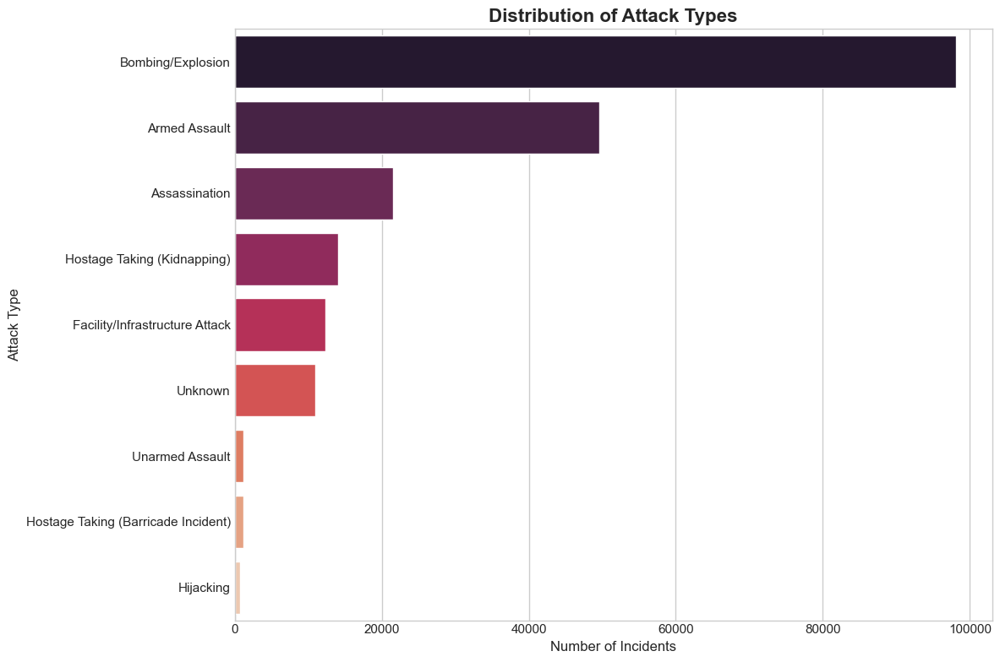

In [45]:
# 3. Bar Plot: Attack Type Distribution
print("Generating plot 3: Attack Type Distribution...")
plt.figure(figsize=(12, 8))
attack_type_counts = df['AttackType'].value_counts()
sns.barplot(y=attack_type_counts.index, x=attack_type_counts.values, palette='rocket')
plt.title('Distribution of Attack Types', fontsize=16, fontweight='bold')
plt.xlabel('Number of Incidents', fontsize=12)
plt.ylabel('Attack Type', fontsize=12)
plt.tight_layout()
plt.show()

**d. Top 10 Deadliest Groups by Casualties (Bar Plot)**
- ***Justification:*** This bar plot ranks groups not by frequency of attacks, but by their total human impact (Casualties). This gives a different and crucial perspective on which groups have been the most destructive.

- ***Key Insights:***

  - The Taliban and the Islamic State of Iraq and the Levant (ISIL) are responsible for an exceptionally high number of casualties, far surpassing other groups.

  - This highlights that the "deadliest" groups are not always the same as the most "active" groups in terms of incident count.

Generating plot 4: Top 10 Terrorist Groups...


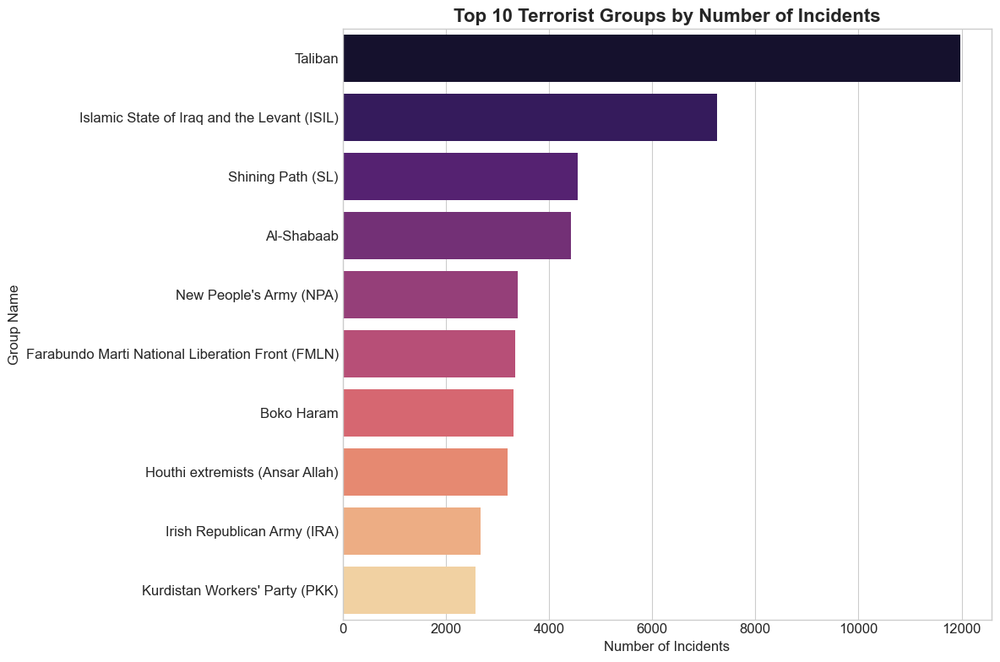

In [ ]:
# 4. Bar Plot: Top 10 Terrorist Groups
print("Generating plot 4: Top 10 Terrorist Groups...")
# Increased figure height to accommodate more bars
plt.figure(figsize=(12, 8)) 
group_counts = df[df['GroupName'] != 'Unknown_Group']['GroupName'].value_counts().head(10)
sns.barplot(y=group_counts.index, x=group_counts.values, hue=group_counts.index, palette='magma', legend=False)
plt.title('Top 10 Terrorist Groups by Number of Incidents', fontsize=16, fontweight='bold')
plt.xlabel('Number of Incidents', fontsize=12)
plt.ylabel('Group Name', fontsize=12)
plt.tight_layout()
plt.show()

**e. Heatmap of Attack Types vs. Region**
- ***Justification:*** A heatmap is perfect for visualizing the relationship and frequency between two categorical variables (Region and AttackType). Color intensity makes it easy to spot "hotspots" (frequent combinations) and "coldspots" (rare combinations).

- ***Key Insights:***

  - The dark blue cells clearly show that Bombing/Explosion is the dominant tactic in the most active regions: the Middle East & North Africa and South Asia.

  - While Armed Assault is a common secondary tactic globally, the raw numbers are exceptionally high in the same two hotspot regions.

  - Specialized tactics like Hijacking are very rare across all regions, as indicated by the very light-colored cells.

Generating plot 5: Heatmap of Attack Types vs. Region...


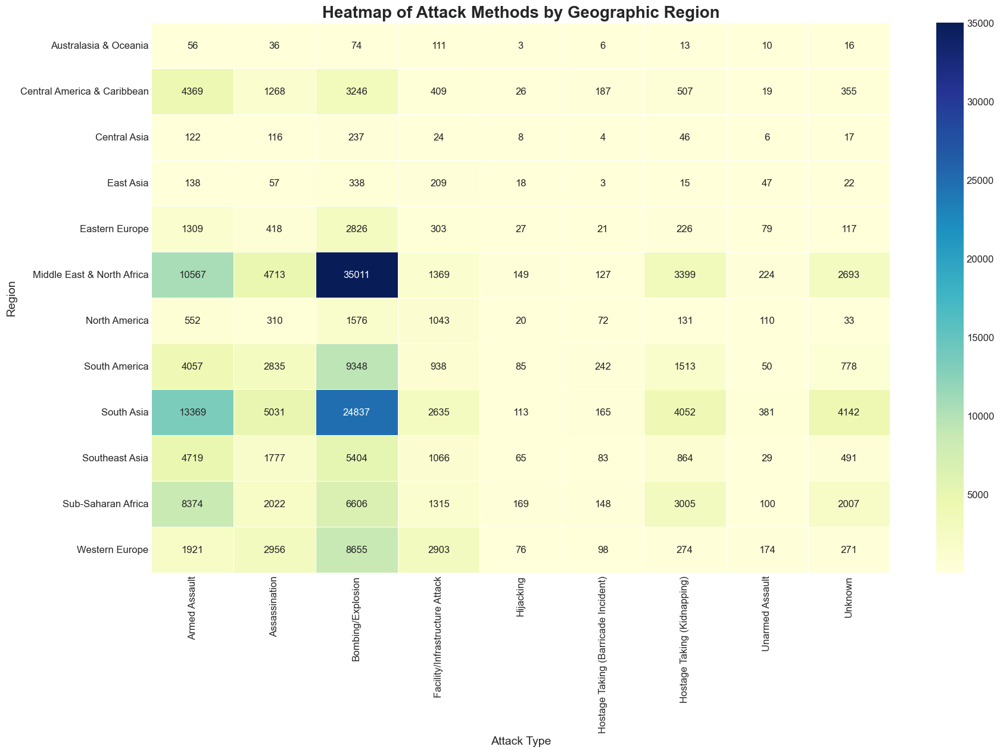

In [6]:
# 5. Heatmap of Attack Types vs. Region 🔥
print("Generating plot 5: Heatmap of Attack Types vs. Region...")
# Create a crosstab to count combinations of Attack Type and Region
attack_region_ct = pd.crosstab(df['Region'], df['AttackType'])
plt.figure(figsize=(20, 12))
sns.heatmap(attack_region_ct, annot=True, fmt='d', cmap='YlGnBu', linewidths=.5)
plt.title('Heatmap of Attack Methods by Geographic Region', fontsize=20, fontweight='bold')
plt.xlabel('Attack Type', fontsize=14)
plt.ylabel('Region', fontsize=14)
plt.show()

**f. Incidents by Region Over Decades (Stacked Bar Plot)**
- ***Justification:*** A stacked bar chart is used to show how the composition of a total changes over time. It allows us to see both the total number of attacks per decade and which regions contributed to that total.

- ***Key Insights:***

  - This plot clearly illustrates a major geographic shift in terrorism. In the 1970s and 1980s, Latin America and Western Europe were significant hotspots.

  - In the 2000s and especially the 2010s, activity became overwhelmingly concentrated in the Middle East & North Africa and South Asia.

Generating plot 6: Incidents by Region Over Decades...


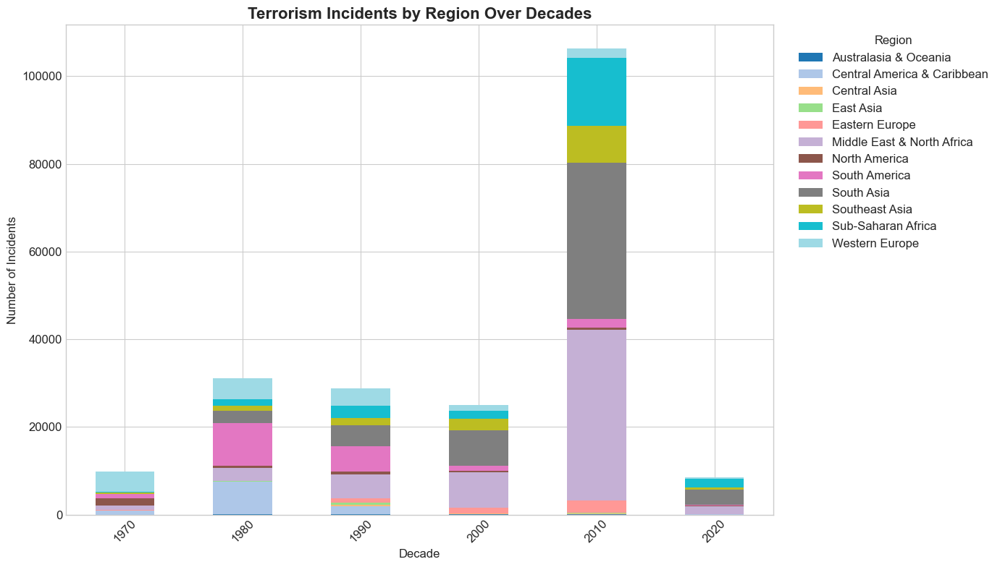

In [9]:
# 6. Stacked Bar Plot: Incidents by Region Over Decades
print("Generating plot 6: Incidents by Region Over Decades...")
decade_region = pd.crosstab(df['Decade'], df['Region'])
fig, ax = plt.subplots(figsize=(14, 8))
decade_region.plot(kind='bar', stacked=True, ax=ax, colormap='tab20')
ax.set_title('Terrorism Incidents by Region Over Decades', fontsize=16, fontweight='bold')
ax.set_xlabel('Decade', fontsize=12)
ax.set_ylabel('Number of Incidents', fontsize=12)
ax.tick_params(axis='x', rotation=45)
ax.legend(title='Region', bbox_to_anchor=(1.02, 1), loc='upper left')
plt.tight_layout()
plt.show()


**g. Proportion of Suicide Attacks (Donut Plot)**
- ***Justification:*** A donut chart is a visually appealing way to show the proportional breakdown of a binary category.

- ***Key Insights:***

  - Despite their high media profile, suicide attacks represent a small fraction of all incidents, accounting for only 3.5% of the total in the dataset.

Generating plot 6: Suicide vs. Non-Suicide Attacks...


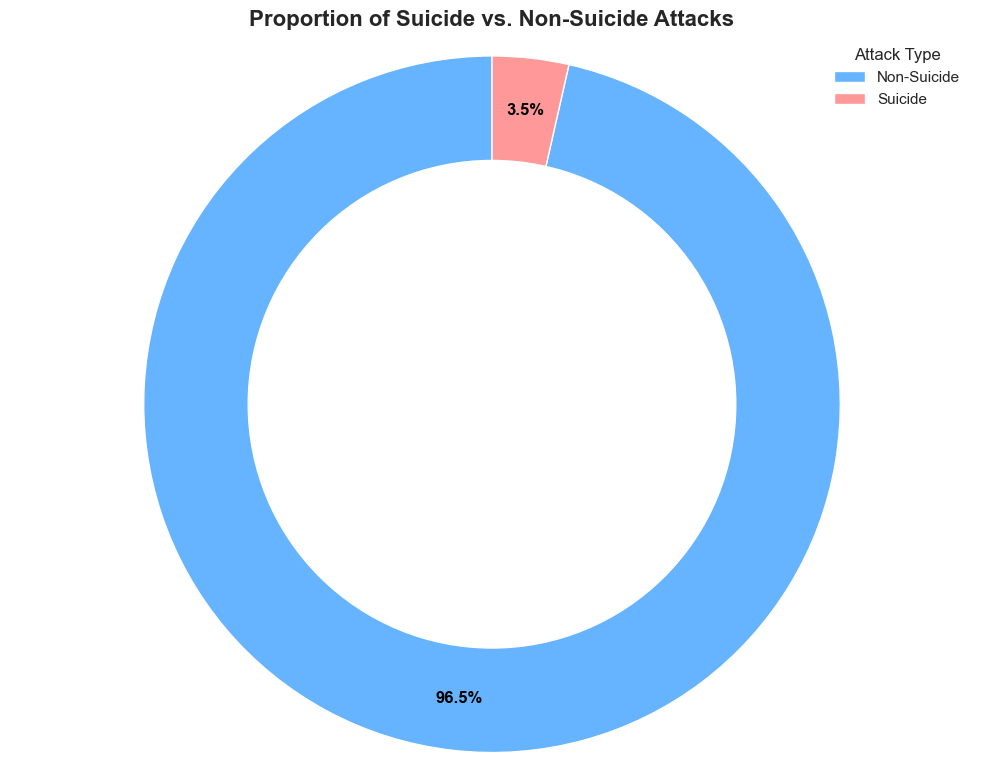

In [ ]:
# 7. Proportion of Suicide vs Non-Suicide
print("Generating plot 6: Suicide vs. Non-Suicide Attacks...")
suicide_counts = df['suicide'].value_counts()  
labels = ['Non-Suicide', 'Suicide']
plt.figure(figsize=(8, 8))
plt.pie(suicide_counts, autopct='%.1f%%', startangle=90, colors=['#66c2a5', '#fc8d62'], wedgeprops={'edgecolor': 'white', 'width': 0.4})
plt.gca().add_artist(plt.Circle((0, 0), 0.6, fc='white'))  # Create donut hole
plt.title('Proportion of Suicide vs. Non-Suicide Attacks', fontsize=16, fontweight='bold')
plt.legend(labels, title='Attack Type', loc='best')
plt.axis('equal')
plt.tight_layout()
plt.show()

**h. Correlation Matrix of Numerical Features (Heatmap)**
- ***Justification:*** A heatmap is the standard and most effective way to visualize a correlation matrix, using color to represent the strength and direction of relationships between numerical variables.

- ***Key Insights:***

  - There is a moderate positive correlation between Killed and Wounded, which is expected.

  - Most other features show very weak correlations, indicating that they represent largely independent dimensions of the data.

Generating plot 8: Correlation Matrix...


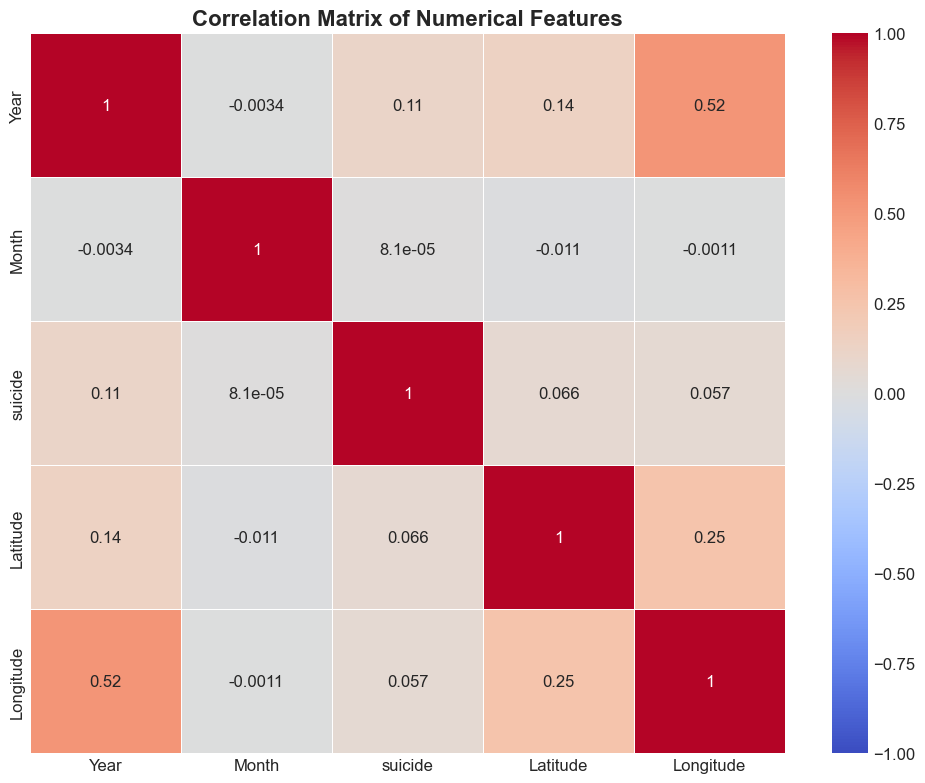

In [10]:
# 8. Heatmap: Correlation Matrix for Numerical Features
print("Generating plot 8: Correlation Matrix...")
plt.figure(figsize=(10, 8))
numeric_cols = ['Year', 'Month', 'suicide', 'Latitude', 'Longitude']
corr_matrix = df[numeric_cols].corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0, linewidths=0.5)
plt.title('Correlation Matrix of Numerical Features', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

**i. Annual Activity of Top Terrorist Groups (Heatmap)**
- ***Justification:*** This heatmap effectively visualizes time-series data for multiple categories (groups) simultaneously, making it much cleaner than an overlapping line chart. Color intensity reveals periods of high and low activity for each group.

- ***Key Insights:***

  - It powerfully illustrates different eras of terrorism. Groups like the IRA and Shining Path were highly active in the late 20th century.

  - Groups like ISIL, the Taliban, and Boko Haram dominate the post-2010 landscape, showing intense periods of activity in recent years.

Generating improved plot 9: Heatmap of Top Group Activity...


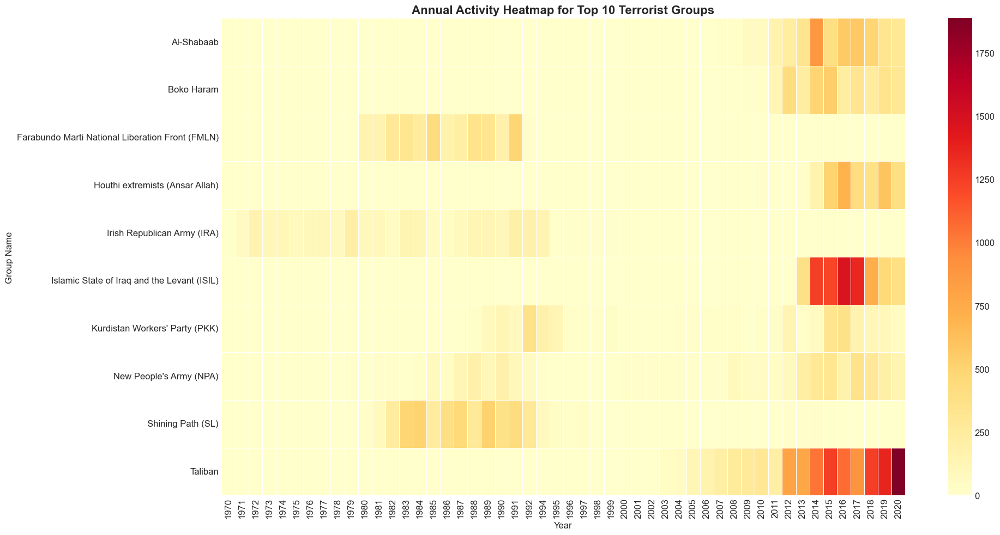

In [ ]:
# 9. Heatmap: Top Group Activity by Year (Improved with Linear Scale)
print("Generating improved plot 9: Heatmap of Top Group Activity...")

# Prepare the data (same as before)
top_10_groups = df[df['GroupName'] != 'Unknown_Group']['GroupName'].value_counts().index[:10]
df_top_10 = df[df['GroupName'].isin(top_10_groups)]
group_activity_year = df_top_10.groupby(['Year', 'GroupName']).size().unstack().fillna(0)

# Create the plot
plt.figure(figsize=(20, 10))

# --- Use a vibrant colormap and grid lines but remove the LogNorm ---
sns.heatmap(
    group_activity_year.T,    
    cmap='YlOrRd',              
    linewidths=0.5,            
    annot=False               
)

# Set titles and labels
plt.title('Annual Activity Heatmap for Top 10 Terrorist Groups', fontsize=16, fontweight='bold')
plt.xlabel('Year', fontsize=12)
plt.ylabel('Group Name', fontsize=12)
plt.tight_layout()
plt.show()

**j. Interactive Map of Incident Locations (Optimized)**
- ***Justification:*** An interactive scatter map allows for a dynamic exploration of the geographic distribution of attacks. To ensure performance, this map plots a random sample of incidents. This technique preserves the overall distribution and density patterns while allowing for a smooth, responsive user experience.

- ***Key Insights:***

  - The map visually confirms the extreme concentration of attacks in hotspots like Iraq, Afghanistan, and Pakistan.

  - By zooming in, users can identify smaller, localized clusters of activity in other regions, such as in parts of Africa and Southeast Asia.

  - The color-coding by attack type allows for the identification of geographic patterns in tactics, such as the prevalence of bombings in urban centers.

In [18]:
import plotly.express as px
import plotly.io as pio

# Set renderer for local display
pio.renderers.default = 'notebook'  # or 'browser' if preferred

print("Generating plot 10: Interactive Incident Locations Map...")
print("To see this interactive map png is given or open this in html as code is given for this...")

# Take a random sample of 30,000 rows for performance
sample_size = 30000
df_sample = df.sample(n=sample_size, random_state=42)

# Create the interactive map
fig = px.scatter_geo(
    df_sample,
    lat='Latitude',
    lon='Longitude',
    color='AttackType',
    hover_name='Country',
    hover_data=['Region', 'Year', 'AttackType'],
    projection='natural earth',
    title='Global Terrorism Incidents',
)

# Customize the map's appearance
fig.update_layout(
    title_font_size=20,
    title_font=dict(weight='bold'),
    geo=dict(
        showframe=False,
        showcoastlines=True,
        landcolor='rgb(243, 243, 243)',
        countrycolor='rgb(204, 204, 204)'
    ),
    legend_title_text='<b>Attack Type</b>'
)

# Save as static image for GitHub
fig.write_image('global_terrorism_map.png', width=1200, height=800)

# Save as HTML for interactivity
fig.write_html('global_terrorism_map.html')

# Display the map locally
fig.show()

Generating plot 10: Interactive Incident Locations Map...
To see this interactive map png is given or open this in html as code is given for this...


Cleaned dataset loaded successfully.

Dataset columns: ['Year', 'Month', 'Country', 'Region', 'Latitude', 'Longitude', 'AttackType', 'TargetType', 'WeaponType', 'suicide', 'GroupName']
Missing values in key columns:
Latitude      0
Longitude     0
AttackType    0
dtype: int64


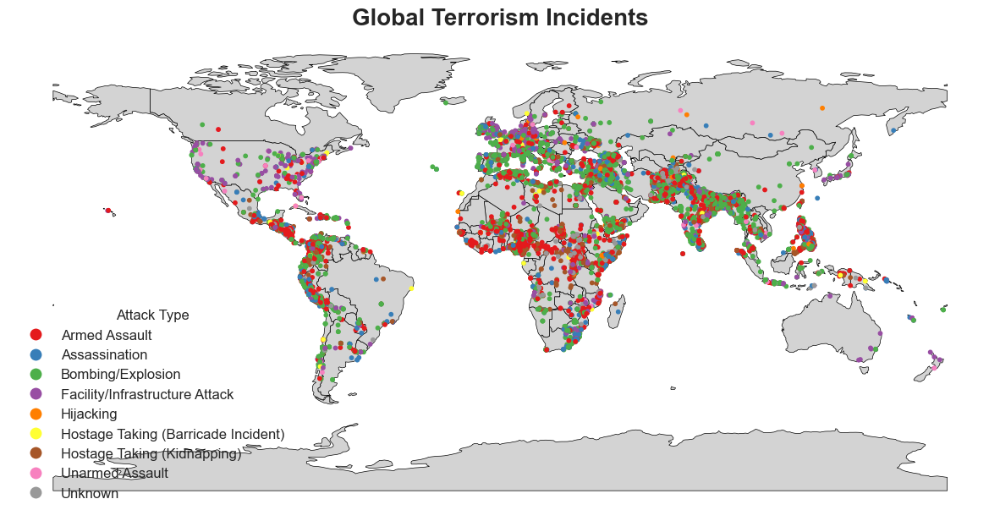

In [15]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

# Load the cleaned CSV file
df = pd.read_csv(r'Cleaned Dataset\globalterrorismdb_cleaned.csv')
print("Cleaned dataset loaded successfully.")

# Validate dataset
print("\nDataset columns:", df.columns.tolist())
print("Missing values in key columns:")
print(df[['Latitude', 'Longitude', 'AttackType']].isna().sum())

# Take a random sample of 30,000 rows for performance
sample_size = 30000
df_sample = df.sample(n=sample_size, random_state=42)

# Filter out rows with missing Latitude or Longitude
df_sample = df_sample.dropna(subset=['Latitude', 'Longitude'])

# Create a GeoDataFrame from the sampled data
gdf = gpd.GeoDataFrame(
    df_sample,
    geometry=gpd.points_from_xy(df_sample['Longitude'], df_sample['Latitude']),
    crs="EPSG:4326"  # Standard coordinate system for lat/lon
)

# Load the world map from the local shapefile
world = gpd.read_file(r'Cleaned Dataset\naturalearth_lowres\ne_110m_admin_0_countries.shp')

# Create the plot
fig, ax = plt.subplots(figsize=(15, 10))

# Plot the world map as the background
world.plot(ax=ax, color='lightgray', edgecolor='black', linewidth=0.5)

# Plot the terrorism incidents, colored by AttackType
gdf.plot(
    ax=ax,
    column='AttackType',  # Color points by AttackType
    categorical=True,
    legend=True,
    legend_kwds={'title': 'Attack Type', 'loc': 'lower left'},
    markersize=10,  # Adjust point size
    cmap='Set1'  # Categorical colormap
)

# Customize the plot
plt.title('Global Terrorism Incidents', fontsize=20, fontweight='bold')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Remove the axis for a cleaner map look
ax.set_axis_off()

# Save the plot as a PNG for GitHub compatibility
plt.savefig('global_terrorism_map.png', dpi=300, bbox_inches='tight')

# Display the plot locally
plt.show()

# Close the plot to free memory
plt.close()

### **6. Conclusion**
This exploratory data analysis of the Global Terrorism Database has successfully illuminated significant trends and patterns in global terrorism over the past 50 years. The rigorous data cleaning and preparation process was foundational to this analysis, transforming a vast and incomplete raw dataset into a reliable tool for generating insights.

The visualizations have effectively translated raw data into a clear narrative. The line plot of incidents over time revealed a dramatic escalation of activity in the 21st century, peaking around 2014. The geographic analysis, through both the bar charts and the static map, confirmed that this surge was not uniform, but rather concentrated in hotspots within the Middle East and South Asia, particularly Iraq. Furthermore, the stacked bar plot of regional activity by decade powerfully illustrated the historical shift of terrorism's epicenter away from Latin America and Western Europe.

Tactically, the analysis showed that Bombing/Explosion remains the most common method, while the analysis of casualties underscored the disproportionate impact of groups like the Taliban and ISIL, who are not just active but exceptionally lethal.

Ultimately, this report provides a robust, data-driven understanding of the GTD dataset. The cleaned data and the insights derived from this EDA serve as a solid foundation for the next logical step: the development and training of predictive machine learning models to further understand and potentially anticipate future trends in global terrorism.

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Logistic Regression script started.")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. Preprocessing ---
log_message("Preprocessing data...")

# Filter out groups with only one attack record
group_counts = df['GroupName'].value_counts()
groups_to_keep = group_counts[group_counts > 1].index
df = df[df['GroupName'].isin(groups_to_keep)]
log_message(f"Filtered out rare classes. Remaining records: {len(df)}")

X = df.drop('GroupName', axis=1)
y = df['GroupName']

# One-Hot Encode categorical features - THIS IS THE SLOWEST STEP
log_message("Applying one-hot encoding... This may take a very long time.")
X = pd.get_dummies(X, columns=['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType'], drop_first=True)
log_message("One-hot encoding complete.")

# --- 3. Split Data ---
log_message("Splitting data into training and testing sets...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
log_message("Data split successfully.")

# --- 4. Model Training ---
log_message("Training Logistic Regression model...")
model = LogisticRegression(class_weight='balanced', max_iter=1000, random_state=42, n_jobs=-1)
model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 5. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)

log_message(f"Accuracy: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 6. Visualization (Confusion Matrix) ---
log_message("Generating confusion matrix...")
top_groups = y.value_counts().nlargest(15).index
mask = y_test.isin(top_groups)
cm = confusion_matrix(y_test[mask], pd.Series(y_pred)[mask], labels=top_groups)

plt.figure(figsize=(12, 10))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=top_groups, yticklabels=top_groups)
plt.title('Confusion Matrix for Top 15 Terrorist Groups (Logistic Regression)')
plt.ylabel('Actual Group')
plt.xlabel('Predicted Group')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_logistic_regression.png')
log_message("Confusion matrix saved as confusion_matrix_logistic_regression.png")

# --- 7. Save Model and Report ---
log_message("Saving model and classification report...")
joblib.dump(model, 'logistic_regression_model.pkl')
with open('classification_report_logistic_regression.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\n")
    f.write("Classification Report:\n")
    f.write(report)
log_message("Logistic Regression script finished.")



[2025-10-09 08:30:51] Logistic Regression script started.
[2025-10-09 08:30:51] Loading data...
[2025-10-09 08:30:52] Data loaded successfully with 209706 records.
[2025-10-09 08:30:52] Preprocessing data...
[2025-10-09 08:30:52] Filtered out rare classes. Remaining records: 207929
[2025-10-09 08:30:52] Applying one-hot encoding... This may take a very long time.
[2025-10-09 08:30:52] One-hot encoding complete.
[2025-10-09 08:30:52] Splitting data into training and testing sets...
[2025-10-09 08:30:53] Data split successfully.
[2025-10-09 08:30:53] Training Logistic Regression model...


In [4]:
pip install lightgbm

   ---------------------------------------- 0.0/1.5 MB ? eta -:--:--
   ------------------------------------ --- 1.3/1.5 MB 6.7 MB/s eta 0:00:01
   ---------------------------------------- 1.5/1.5 MB 6.9 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("LightGBM script started (Optimized for Speed).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. Preprocessing ---
log_message("Preprocessing data...")
# Filter out groups with only one attack record to prevent errors during splitting.
group_counts = df['GroupName'].value_counts()
groups_to_keep = group_counts[group_counts > 1].index
df = df[df['GroupName'].isin(groups_to_keep)]
log_message(f"Filtered out rare classes. Remaining records: {len(df)}")

X = df.drop('GroupName', axis=1)
y = df['GroupName']

# **THE FAST WAY**: LightGBM handles categorical features natively.
# We just convert them to the 'category' dtype, which is extremely fast and memory-efficient.
categorical_features = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
for col in categorical_features:
    X[col] = X[col].astype('category')
log_message("Fast preprocessing complete using native category handling.")


# LightGBM requires integer labels for the target variable.
le = LabelEncoder()
y_encoded = le.fit_transform(y)
log_message("Target variable 'GroupName' encoded successfully.")

# --- 3. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
log_message("Data split successfully.")

# --- 4. Model Training ---
log_message("Training LightGBM model with GPU acceleration...")
# **GPU ENABLED**: The `device='gpu'` parameter tells LightGBM to use the GPU.
# If a compatible GPU is not found, it will automatically fall back to the CPU.
model = lgb.LGBMClassifier(
    objective='multiclass',
    random_state=42,
    n_jobs=-1,
    class_weight='balanced',
    device='gpu'  # Use GPU for training
)

model.fit(X_train, y_train_encoded, categorical_feature=categorical_features)
log_message("Model training complete.")

# --- 5. Evaluation ---
log_message("Evaluating model performance...")
y_pred_encoded = model.predict(X_test)
# Decode predictions and test labels back to their original string format for the report.
y_pred = le.inverse_transform(y_pred_encoded)
y_test = le.inverse_transform(y_test_encoded)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 6. Visualization ---
log_message("Generating confusion matrix...")
top_groups = pd.Series(y).value_counts().nlargest(15).index
mask = pd.Series(y_test).isin(top_groups)
cm = confusion_matrix(pd.Series(y_test)[mask], pd.Series(y_pred)[mask], labels=top_groups)

plt.figure(figsize=(12, 10))
sns.heatmap(cm, annot=True, fmt='d', cmap='Purples', xticklabels=top_groups, yticklabels=top_groups)
plt.title('Confusion Matrix for Top 15 Terrorist Groups (LightGBM)')
plt.ylabel('Actual Group')
plt.xlabel('Predicted Group')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_lightgbm.png')
log_message("Confusion matrix saved as confusion_matrix_lightgbm.png")

# --- 7. Save Model and Report ---
log_message("Saving model, label encoder, and report...")
joblib.dump(model, 'lightgbm_model.pkl')
joblib.dump(le, 'label_encoder.pkl') # Save the encoder for future use
with open('classification_report_lightgbm.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\n")
    f.write("Classification Report:\n")
    f.write(report)
log_message("LightGBM script finished.")

[2025-10-12 06:45:14] LightGBM script started (Optimized for Speed).
[2025-10-12 06:45:14] Loading data...
[2025-10-12 06:45:14] Data loaded successfully with 209706 records.
[2025-10-12 06:45:14] Preprocessing data...
[2025-10-12 06:45:14] Filtered out rare classes. Remaining records: 207929
[2025-10-12 06:45:15] Fast preprocessing complete using native category handling.
[2025-10-12 06:45:15] Target variable 'GroupName' encoded successfully.
[2025-10-12 06:45:15] Splitting data...
[2025-10-12 06:45:15] Data split successfully.
[2025-10-12 06:45:15] Training LightGBM model with GPU acceleration...
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 817
[LightGBM] [Info] Number of data points in the train set: 166343, number of used features: 10
[LightGBM] [Info] Using GPU Device: Tesla T4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entr

[2025-10-12 07:20:30] Generating feature importance plot...
[2025-10-12 07:20:30] Feature importance plot saved as feature_importance_lightgbm.png
[2025-10-12 07:20:30] Generating prediction distribution plot...
[2025-10-12 07:20:31] Prediction distribution plot saved as prediction_distribution_lightgbm.png


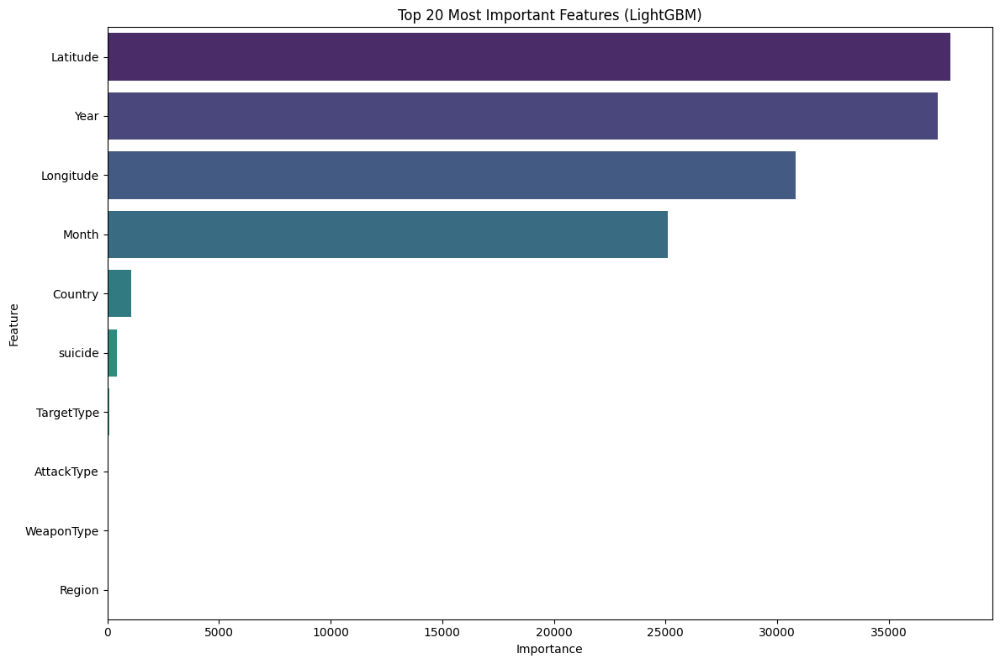

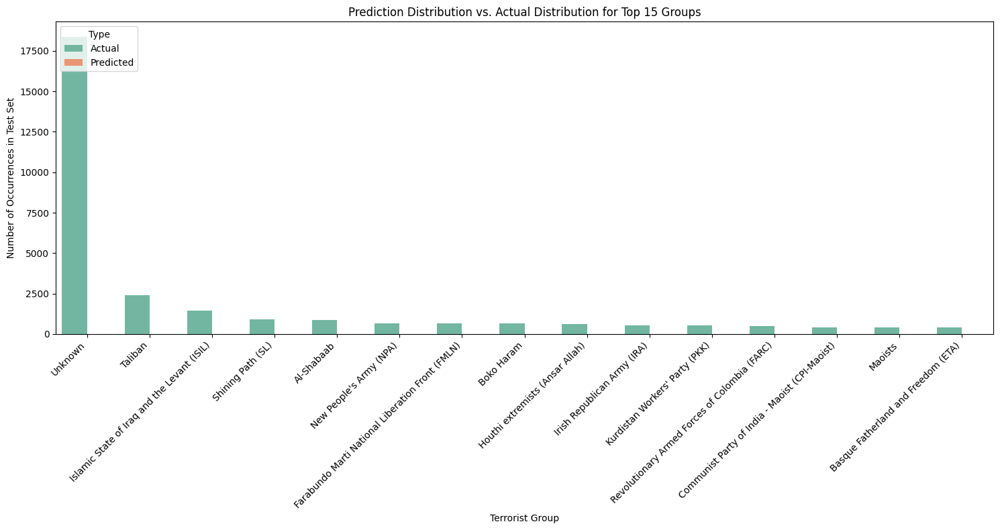

In [29]:
# --- NEW VISUALIZATION 1: Feature Importance ---
log_message("Generating feature importance plot...")
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_})
feature_importances = feature_importances.sort_values('importance', ascending=False).head(20)

plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=feature_importances, palette='viridis')
plt.title('Top 20 Most Important Features (LightGBM)')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.tight_layout()
plt.savefig('feature_importance_lightgbm.png')
log_message("Feature importance plot saved as feature_importance_lightgbm.png")


# --- NEW VISUALIZATION 2: Prediction Distribution ---
log_message("Generating prediction distribution plot...")
top_groups_dist = pd.Series(y).value_counts().nlargest(15).index
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)

actual_counts = y_test_series[y_test_series.isin(top_groups_dist)].value_counts().reset_index()
actual_counts.columns = ['Group', 'Count']
actual_counts['Type'] = 'Actual'

predicted_counts = y_pred_series[y_pred_series.isin(top_groups_dist)].value_counts().reset_index()
predicted_counts.columns = ['Group', 'Count']
predicted_counts['Type'] = 'Predicted'

comparison_df = pd.concat([actual_counts, predicted_counts])

plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df, palette='Set2')
plt.title('Prediction Distribution vs. Actual Distribution for Top 15 Groups')
plt.xlabel('Terrorist Group')
plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('prediction_distribution_lightgbm.png')
log_message("Prediction distribution plot saved as prediction_distribution_lightgbm.png")


[2025-10-12 04:25:21] CatBoost script started (Optimized for Accuracy).
[2025-10-12 04:25:21] Loading data...
[2025-10-12 04:25:22] Data loaded successfully with 209706 records.
[2025-10-12 04:25:22] Refining the dataset for a more meaningful problem.
[2025-10-12 04:25:22] Identified the top 20 most active named groups.
[2025-10-12 04:25:22] Dataset filtered to 63673 records, focusing on the top 20 groups.
[2025-10-12 04:25:22] Preprocessing the refined data...
[2025-10-12 04:25:22] Identified categorical feature indices: [2, 3, 6, 7, 8]
[2025-10-12 04:25:22] Splitting data...
[2025-10-12 04:25:22] Data split successfully.
[2025-10-12 04:25:22] Training CatBoost model with GPU acceleration...
0:	learn: 1.6550104	total: 326ms	remaining: 2m 42s
100:	learn: 0.0818037	total: 11.7s	remaining: 46.4s
200:	learn: 0.0625792	total: 23.3s	remaining: 34.6s
300:	learn: 0.0508508	total: 35.3s	remaining: 23.4s
400:	learn: 0.0429279	total: 47.7s	remaining: 11.8s
499:	learn: 0.0367967	total: 1m	remaini

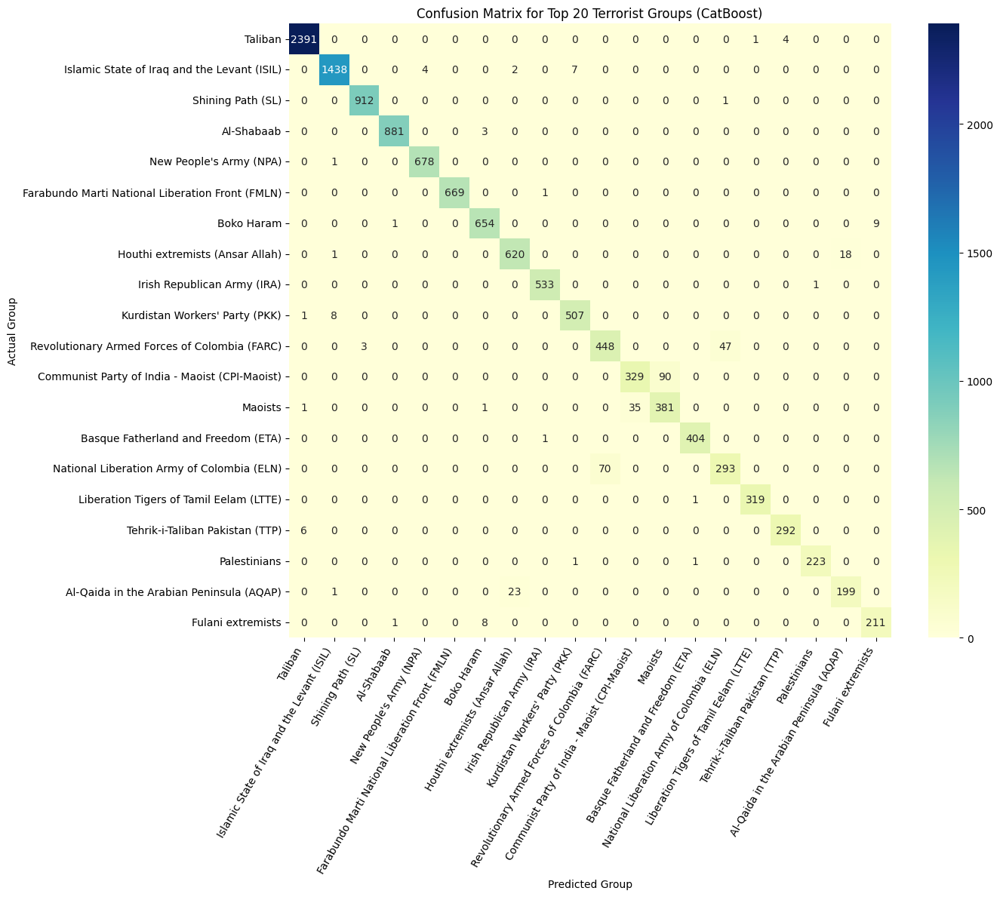

In [6]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("CatBoost script started (Optimized for Accuracy).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION ---
log_message("Refining the dataset for a more meaningful problem.")

# First, remove the dominant 'Unknown' group
df = df[df['GroupName'] != 'Unknown']

# Identify the top 20 most frequent NAMED groups
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
log_message(f"Identified the top {top_n_groups} most active named groups.")

# Filter the dataset to only include records from these top groups
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records, focusing on the top {top_n_groups} groups.")


# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Identify categorical features for CatBoost
categorical_features_indices = [X.columns.get_loc(col) for col in ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']]
log_message(f"Identified categorical feature indices: {categorical_features_indices}")


# --- 4. Split Data ---
log_message("Splitting data...")
# We still stratify to maintain the new, more balanced proportions
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
log_message("Data split successfully.")

# --- 5. Model Training with CatBoost ---
log_message("Training CatBoost model with GPU acceleration...")

# **GPU ENABLED**: task_type='GPU' tells CatBoost to use the GPU.
model = CatBoostClassifier(
    iterations=500,  # Number of trees to build
    learning_rate=0.1,
    depth=10,
    loss_function='MultiClass',
    verbose=100,  # Print progress every 100 iterations
    cat_features=categorical_features_indices,
    task_type='GPU', # Use GPU
    random_seed=42
)

model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test).flatten()

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualization ---
log_message("Generating confusion matrix...")
# The labels for the matrix are now our top groups
cm = confusion_matrix(y_test, y_pred, labels=top_groups)

plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Terrorist Groups (CatBoost)')
plt.ylabel('Actual Group')
plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_catboost.png')
log_message("Confusion matrix saved as confusion_matrix_catboost.png")

# --- 8. Save Model and Report ---
log_message("Saving model and report...")
model.save_model('catboost_model.cbm')
with open('classification_report_catboost.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\n")
    f.write("Classification Report:\n")
    f.write(report)
log_message("CatBoost script finished.")

[2025-10-12 04:29:37] Generating feature importance plot...
[2025-10-12 04:29:38] Feature importance plot saved as feature_importance_catboost.png
[2025-10-12 04:29:38] Generating prediction distribution plot...
[2025-10-12 04:29:38] Prediction distribution plot saved as prediction_distribution_catboost.png
[2025-10-12 04:29:38] Saving model and report...
[2025-10-12 04:29:39] CatBoost script finished.


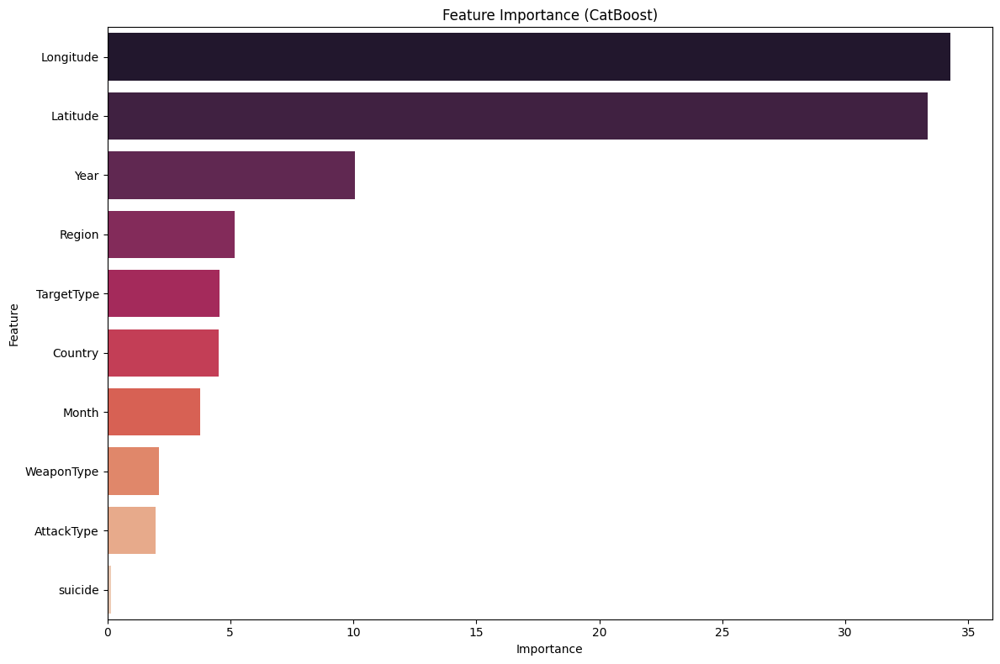

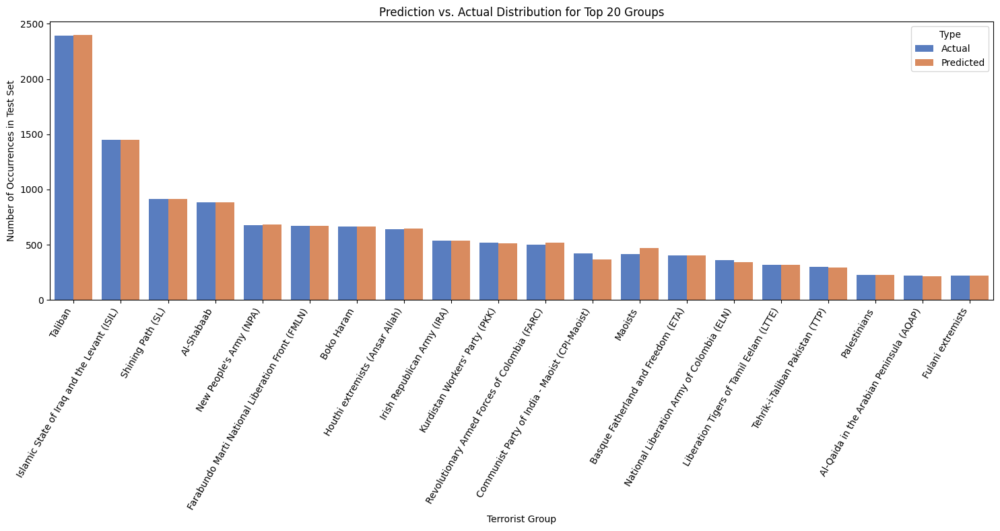

In [7]:

# --- NEW VISUALIZATION 1: Feature Importance ---
log_message("Generating feature importance plot...")
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': model.get_feature_importance()})
feature_importances = feature_importances.sort_values('importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=feature_importances, palette='rocket')
plt.title('Feature Importance (CatBoost)')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.tight_layout()
plt.savefig('feature_importance_catboost.png')
log_message("Feature importance plot saved as feature_importance_catboost.png")


# --- NEW VISUALIZATION 2: Prediction Distribution ---
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)

actual_counts = y_test_series.value_counts().reset_index()
actual_counts.columns = ['Group', 'Count']
actual_counts['Type'] = 'Actual'

predicted_counts = y_pred_series.value_counts().reset_index()
predicted_counts.columns = ['Group', 'Count']
predicted_counts['Type'] = 'Predicted'

comparison_df = pd.concat([actual_counts, predicted_counts])

plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df, palette='muted')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups')
plt.xlabel('Terrorist Group')
plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout()
plt.savefig('prediction_distribution_catboost.png')
log_message("Prediction distribution plot saved as prediction_distribution_catboost.png")


# --- 8. Save Model and Report ---
log_message("Saving model and report...")
model.save_model('catboost_model.cbm')
with open('classification_report_catboost.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\n")
    f.write("Classification Report:\n")
    f.write(report)
log_message("CatBoost script finished.")

[2025-10-12 04:42:07] XGBoost script started (Optimized for Accuracy on Top 20 Groups).
[2025-10-12 04:42:07] Loading data...
[2025-10-12 04:42:07] Data loaded successfully with 209706 records.
[2025-10-12 04:42:07] Refining the dataset to focus on the most active groups.
[2025-10-12 04:42:07] Identified the top 20 most active named groups.
[2025-10-12 04:42:07] Dataset filtered to 63673 records, focusing on the top 20 groups.
[2025-10-12 04:42:07] Preprocessing the refined data...
[2025-10-12 04:42:07] Target variable 'GroupName' encoded successfully.
[2025-10-12 04:42:07] Applying one-hot encoding on the filtered dataset...
[2025-10-12 04:42:07] One-hot encoding complete.
[2025-10-12 04:42:07] Splitting data...
[2025-10-12 04:42:08] Data split successfully.
[2025-10-12 04:42:08] Training XGBoost model with GPU acceleration...
[2025-10-12 04:42:32] Model training complete.
[2025-10-12 04:42:32] Evaluating model performance...
[2025-10-12 04:42:33] Accuracy on Top 20 Groups: 0.9734

Cl

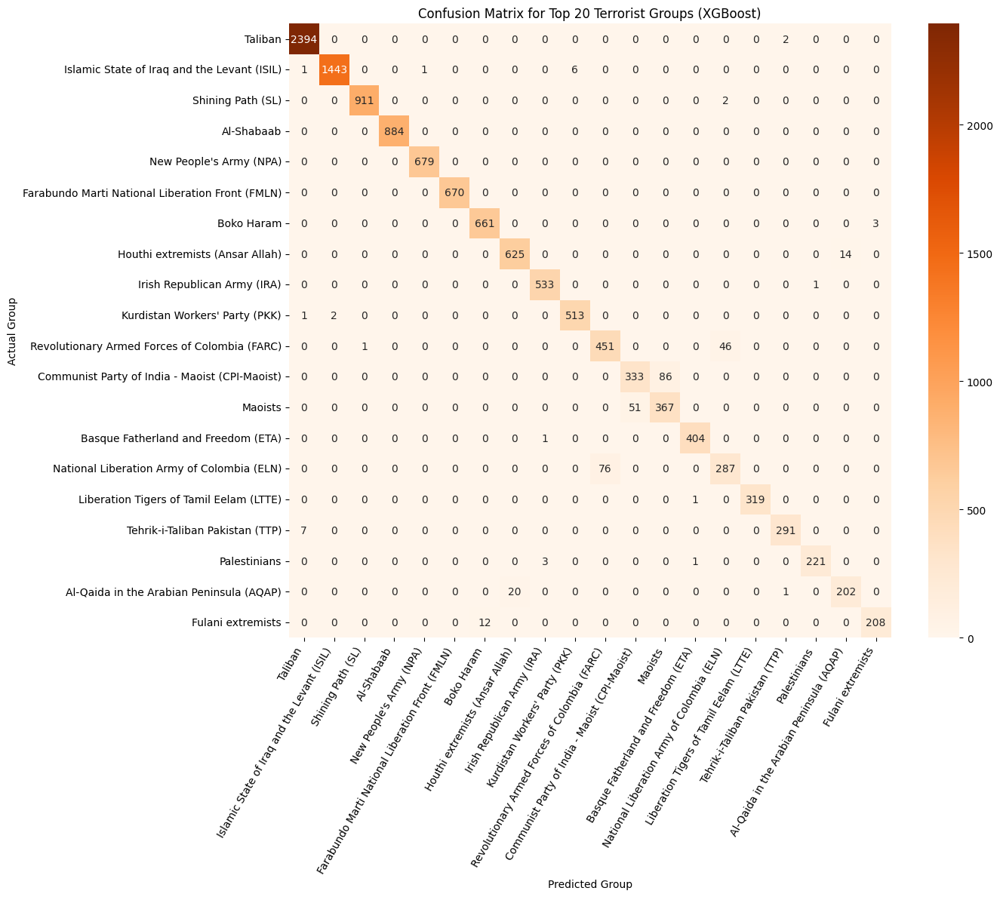

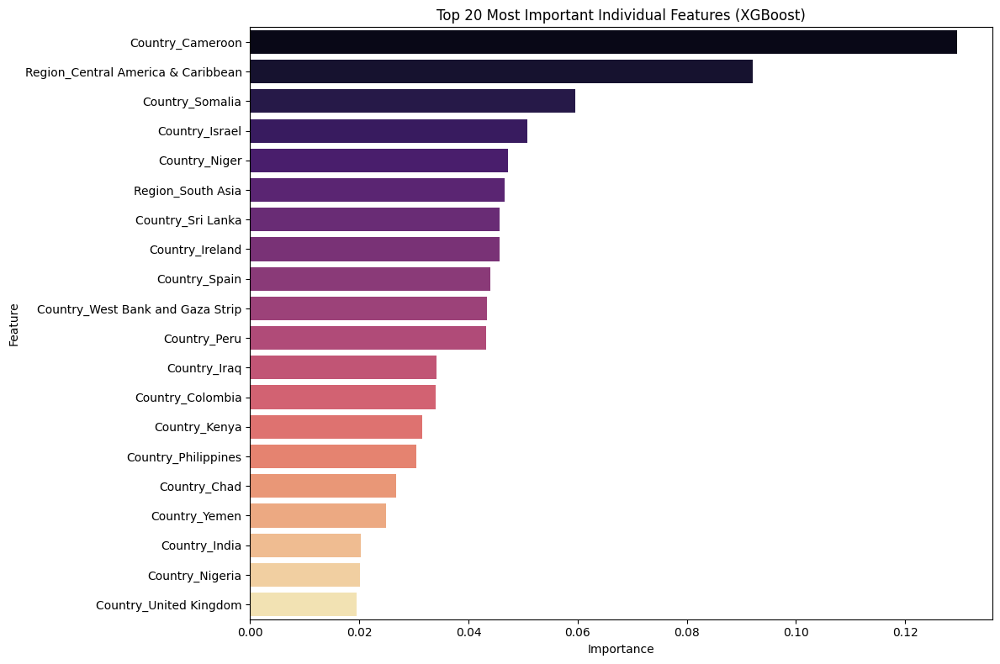

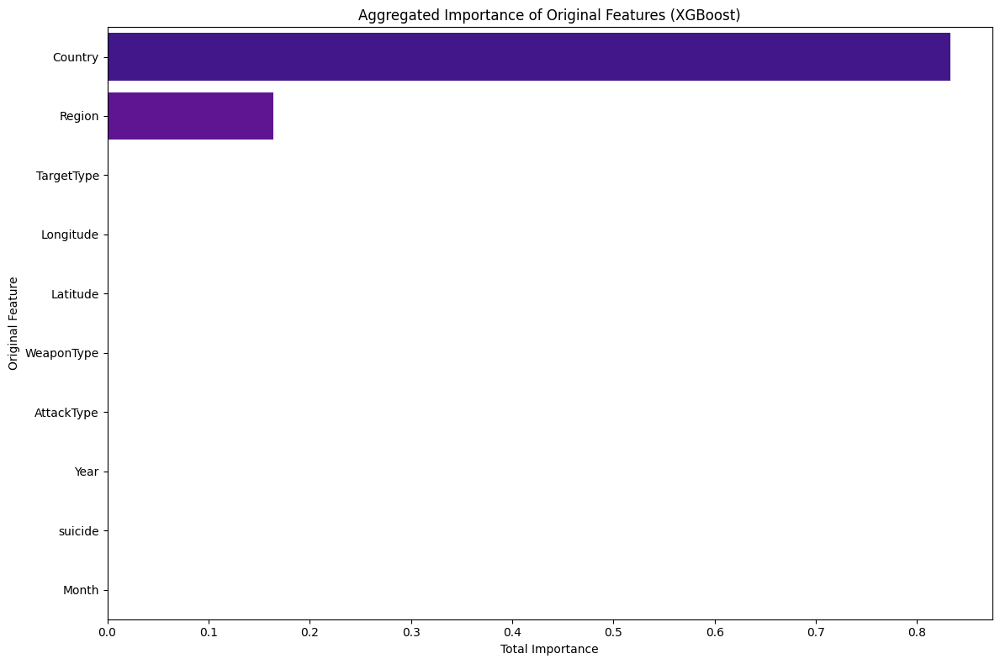

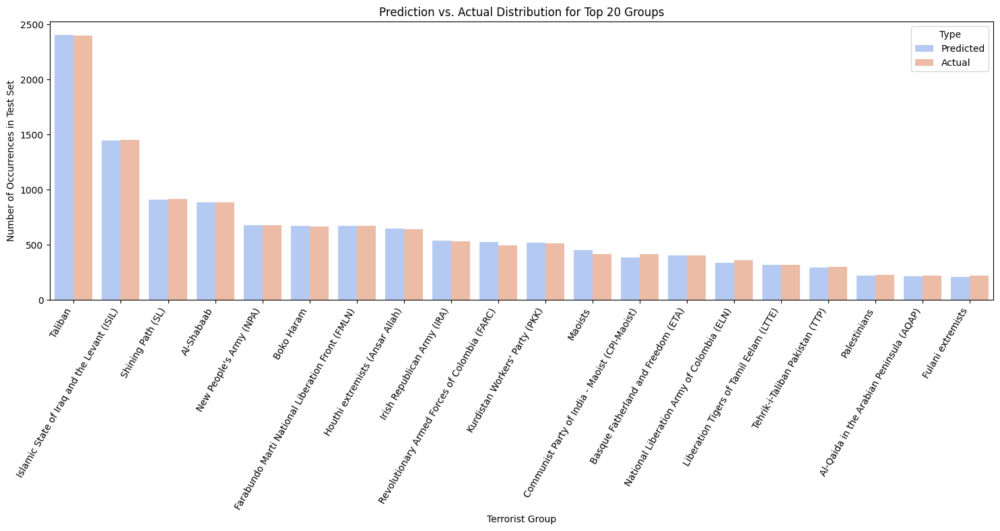

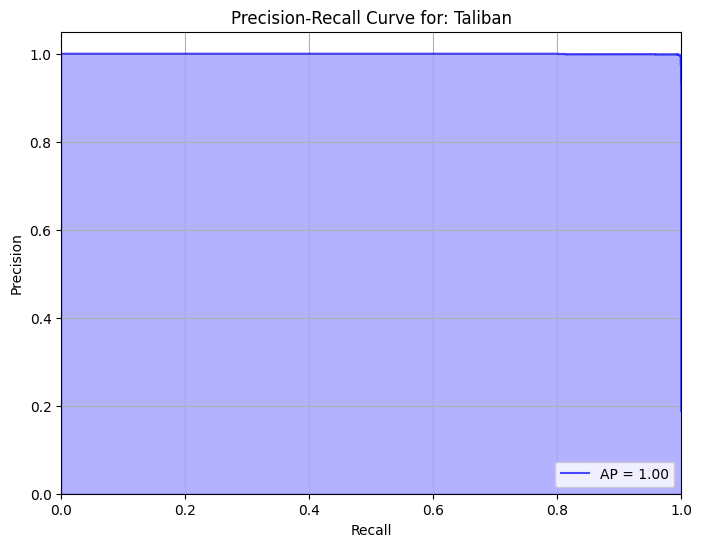

In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_curve, average_precision_score
from sklearn.preprocessing import LabelEncoder, label_binarize
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("XGBoost script started (Optimized for Accuracy on Top 20 Groups).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION (The Successful Strategy) ---
log_message("Refining the dataset to focus on the most active groups.")

# First, remove the dominant 'Unknown' group
df = df[df['GroupName'] != 'Unknown']

# Identify the top 20 most frequent NAMED groups
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
log_message(f"Identified the top {top_n_groups} most active named groups.")

# Filter the dataset to only include records from these top groups
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records, focusing on the top {top_n_groups} groups.")


# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# XGBoost requires numeric labels, so we encode the target variable.
le = LabelEncoder()
y_encoded = le.fit_transform(y)
log_message("Target variable 'GroupName' encoded successfully.")

# **CORRECTED**: Define original column lists here, before they are used.
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()


# One-hot encoding is now fast and manageable because we filtered the data first.
log_message("Applying one-hot encoding on the filtered dataset...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")


# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
log_message("Data split successfully.")

# --- 5. Model Training with XGBoost ---
log_message("Training XGBoost model with GPU acceleration...")
# **GPU ENABLED**: tree_method='gpu_hist' tells XGBoost to use the GPU.
model = XGBClassifier(
    objective='multi:softmax',
    use_label_encoder=False,
    eval_metric='mlogloss',
    n_estimators=500, # Increased estimators for better performance
    learning_rate=0.1,
    random_state=42,
    n_jobs=-1,
    tree_method='gpu_hist' # Use GPU
)

model.fit(X_train, y_train_encoded)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred_encoded = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test) # Get probabilities for PR curve
y_pred = le.inverse_transform(y_pred_encoded)
y_test = le.inverse_transform(y_test_encoded)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='Oranges', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Terrorist Groups (XGBoost)')
plt.ylabel('Actual Group')
plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_xgboost.png')
log_message("Confusion matrix saved as confusion_matrix_xgboost.png")

# Visualization 2: Top 20 Individual Feature Importance
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_})
feature_importances_top20 = feature_importances.sort_values('importance', ascending=False).head(20)
plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=feature_importances_top20, palette='magma')
plt.title('Top 20 Most Important Individual Features (XGBoost)')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.tight_layout()
plt.savefig('feature_importance_top20_xgboost.png')
log_message("Top 20 individual feature importance plot saved as feature_importance_top20_xgboost.png")

# Visualization 3: Aggregated Feature Importance
log_message("Generating aggregated feature importance plot...")
# Create a dictionary to hold the aggregated scores
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}

# Sum importances for each original feature
for feature, importance in zip(feature_importances['feature'], feature_importances['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True
            break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance

# Convert to DataFrame for plotting
aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'})
aggregated_df = aggregated_df.sort_values('importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='plasma')
plt.title('Aggregated Importance of Original Features (XGBoost)')
plt.xlabel('Total Importance')
plt.ylabel('Original Feature')
plt.tight_layout()
plt.savefig('feature_importance_aggregated_xgboost.png')
log_message("Aggregated feature importance plot saved as feature_importance_aggregated_xgboost.png")


# Visualization 4: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='coolwarm')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups')
plt.xlabel('Terrorist Group')
plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout()
plt.savefig('prediction_distribution_xgboost.png')
log_message("Prediction distribution plot saved as prediction_distribution_xgboost.png")

# Visualization 5: Precision-Recall Curve for the Top Group
log_message("Generating Precision-Recall curve for the top group...")
# Binarize the labels for the top class vs. rest
top_class = 'Taliban'
y_test_binarized = label_binarize(y_test, classes=le.classes_)
top_class_index = np.where(le.classes_ == top_class)[0][0]
y_test_top_class = y_test_binarized[:, top_class_index]
y_pred_top_class_proba = y_pred_proba[:, top_class_index]

precision, recall, _ = precision_recall_curve(y_test_top_class, y_pred_top_class_proba)
avg_precision = average_precision_score(y_test_top_class, y_pred_top_class_proba)

plt.figure(figsize=(8, 6))
plt.step(recall, precision, where='post', color='b', alpha=0.7, label=f'AP = {avg_precision:0.2f}')
plt.fill_between(recall, precision, step='post', alpha=0.3, color='b')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title(f'Precision-Recall Curve for: {top_class}')
plt.legend(loc="lower right")
plt.grid(True)
plt.savefig('precision_recall_curve_xgboost.png')
log_message("Precision-Recall curve saved as precision_recall_curve_xgboost.png")


# --- 8. Save Model and Report ---
log_message("Saving model, label encoder, and report...")
joblib.dump(model, 'xgboost_model.pkl')
joblib.dump(le, 'label_encoder.pkl') # Save the encoder
with open('classification_report_xgboost.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\n")
    f.write("Classification Report:\n")
    f.write(report)
log_message("XGBoost script finished.")

[2025-10-12 04:50:13] Random Forest script started (Applying the Top 20 Groups strategy).
[2025-10-12 04:50:13] Loading data...
[2025-10-12 04:50:13] Data loaded successfully with 209706 records.
[2025-10-12 04:50:13] Refining the dataset to focus on the most active groups.
[2025-10-12 04:50:13] Identified the top 20 most active named groups.
[2025-10-12 04:50:13] Dataset filtered to 63673 records, preventing MemoryError.
[2025-10-12 04:50:13] Preprocessing the refined data...
[2025-10-12 04:50:13] Applying one-hot encoding on the filtered dataset...
[2025-10-12 04:50:13] One-hot encoding complete.
[2025-10-12 04:50:13] Splitting data...
[2025-10-12 04:50:13] Data split successfully.
[2025-10-12 04:50:13] Training Random Forest model... This will use all available CPU cores.
[2025-10-12 04:50:15] Model training complete.
[2025-10-12 04:50:15] Evaluating model performance...
[2025-10-12 04:50:16] Accuracy on Top 20 Groups: 0.9706

Classification Report:
                                 

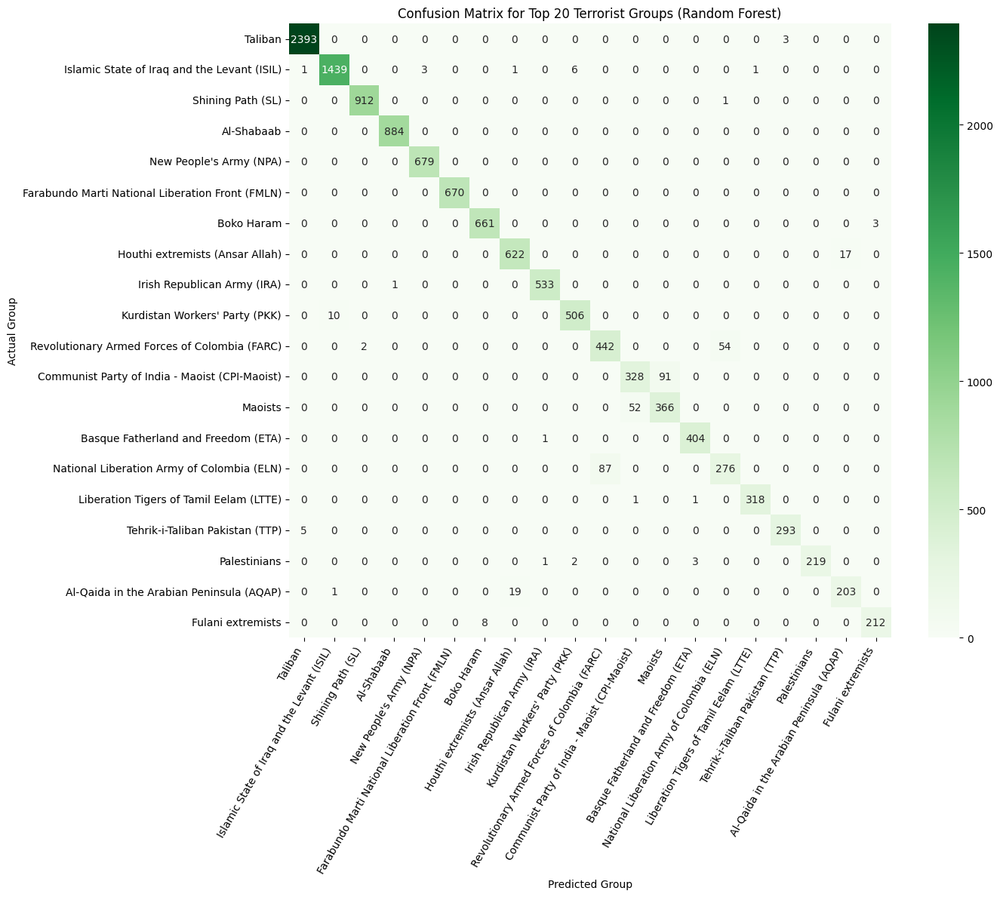

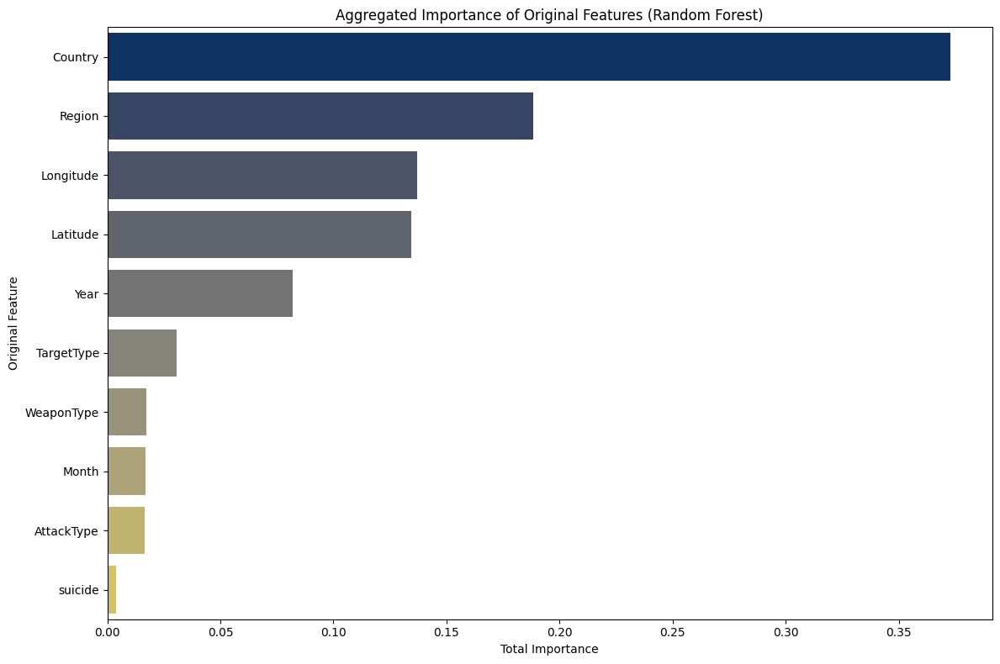

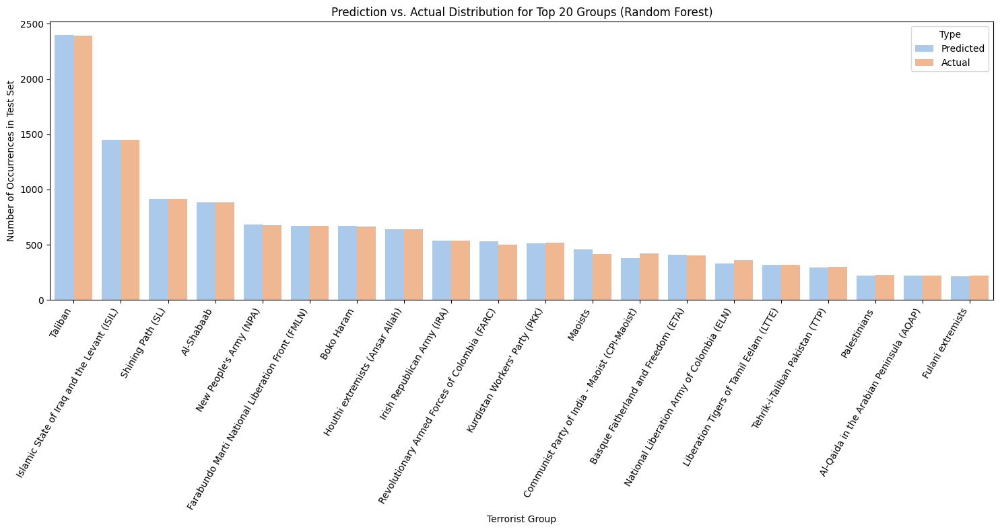

In [15]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Random Forest script started (Applying the Top 20 Groups strategy).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION (The Successful Strategy) ---
log_message("Refining the dataset to focus on the most active groups.")

# First, remove the dominant 'Unknown' group
df = df[df['GroupName'] != 'Unknown']

# Identify the top 20 most frequent NAMED groups
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
log_message(f"Identified the top {top_n_groups} most active named groups.")

# Filter the dataset to only include records from these top groups
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records, preventing MemoryError.")


# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names before encoding for the aggregated plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

# One-hot encoding is now fast and manageable because we filtered the data first.
log_message("Applying one-hot encoding on the filtered dataset...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")


# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
log_message("Data split successfully.")

# --- 5. Model Training with Random Forest ---
log_message("Training Random Forest model... This will use all available CPU cores.")
# n_jobs=-1 uses all CPU cores to speed up training as much as possible.
model = RandomForestClassifier(
    n_estimators=100, # A good default number of trees
    random_state=42,
    n_jobs=-1,
    class_weight='balanced'
)

model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='Greens', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Terrorist Groups (Random Forest)')
plt.ylabel('Actual Group')
plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_random_forest.png')
log_message("Confusion matrix saved as confusion_matrix_random_forest.png")

# Visualization 2: Aggregated Feature Importance
log_message("Generating aggregated feature importance plot...")
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}

for feature, importance in zip(feature_importances['feature'], feature_importances['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True
            break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance

aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='cividis')
plt.title('Aggregated Importance of Original Features (Random Forest)')
plt.xlabel('Total Importance')
plt.ylabel('Original Feature')
plt.tight_layout()
plt.savefig('feature_importance_aggregated_rf.png')
log_message("Aggregated feature importance plot saved as feature_importance_aggregated_rf.png")


# Visualization 3: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])

plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='pastel')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups (Random Forest)')
plt.xlabel('Terrorist Group')
plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout()
plt.savefig('prediction_distribution_rf.png')
log_message("Prediction distribution plot saved as prediction_distribution_rf.png")


# --- 8. Save Model and Report ---
log_message("Saving model and report...")
joblib.dump(model, 'random_forest_model.pkl')
with open('classification_report_random_forest.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\n")
    f.write("Classification Report:\n")
    f.write(report)
log_message("Random Forest script finished.")

[2025-10-12 04:53:42] Neural Network (MLP) script started.
[2025-10-12 04:53:42] Loading data...
[2025-10-12 04:53:42] Data loaded successfully with 209706 records.
[2025-10-12 04:53:42] Refining the dataset to focus on the most active groups.
[2025-10-12 04:53:42] Dataset filtered to 63673 records for the top 20 groups.
[2025-10-12 04:53:42] Preprocessing the refined data...
[2025-10-12 04:53:42] Applying one-hot encoding...
[2025-10-12 04:53:42] One-hot encoding complete.
[2025-10-12 04:53:42] Scaling features...
[2025-10-12 04:53:42] Feature scaling complete.
[2025-10-12 04:53:42] Splitting data...
[2025-10-12 04:53:42] Data split successfully.
[2025-10-12 04:53:42] Training MLP model... This will run on the CPU.
Iteration 1, loss = 0.69716741
Validation score: 0.924617
Iteration 2, loss = 0.18529926
Validation score: 0.926188
Iteration 3, loss = 0.16838647
Validation score: 0.936592
Iteration 4, loss = 0.15775388
Validation score: 0.938751
Iteration 5, loss = 0.14911014
Validation 

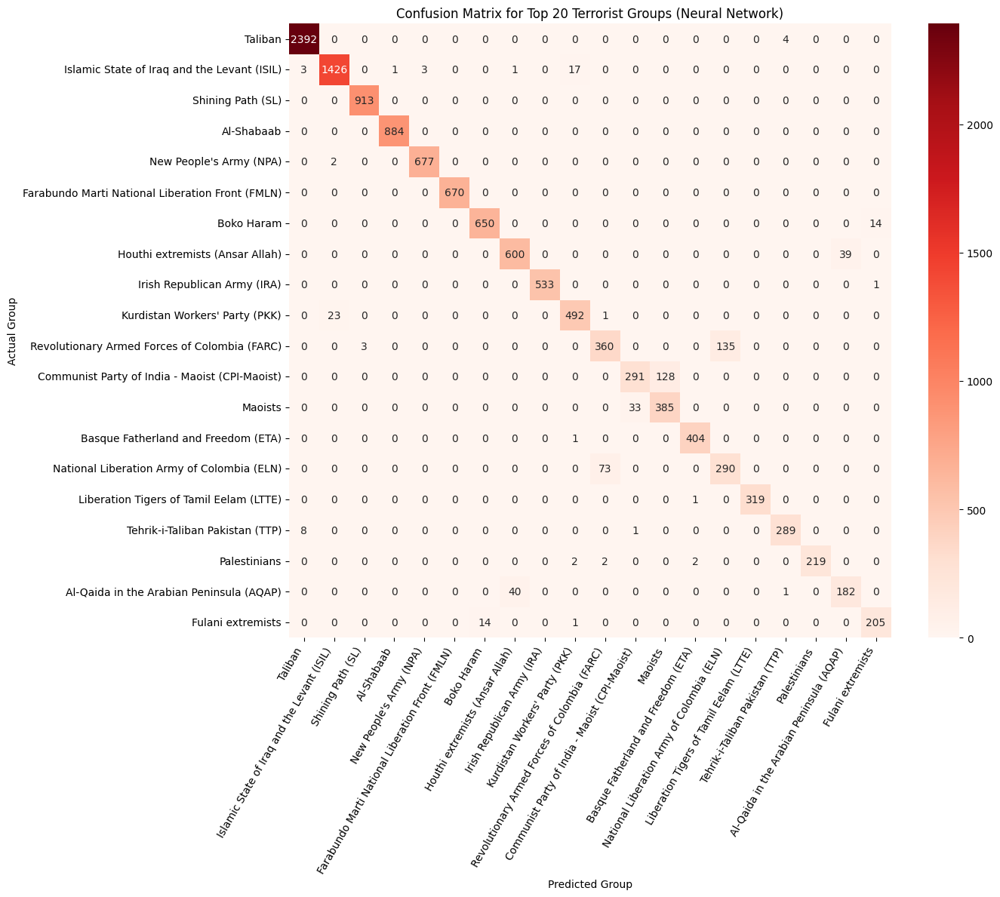

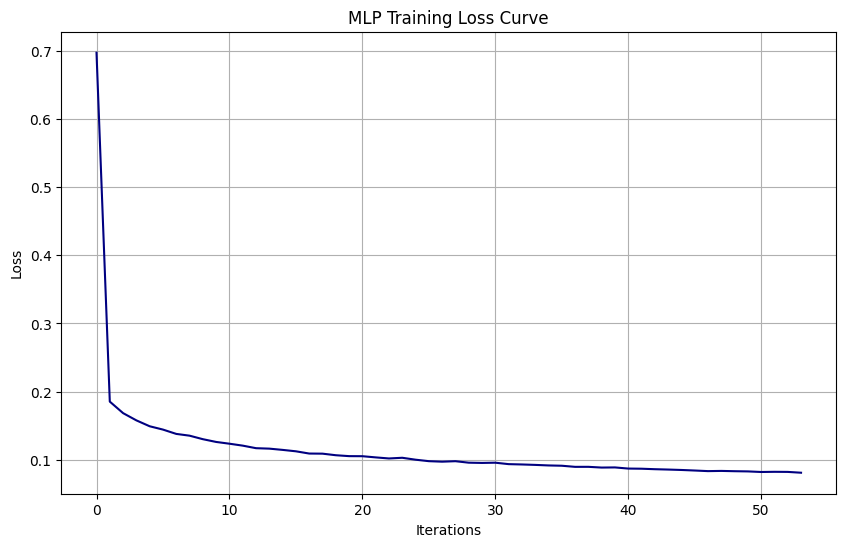

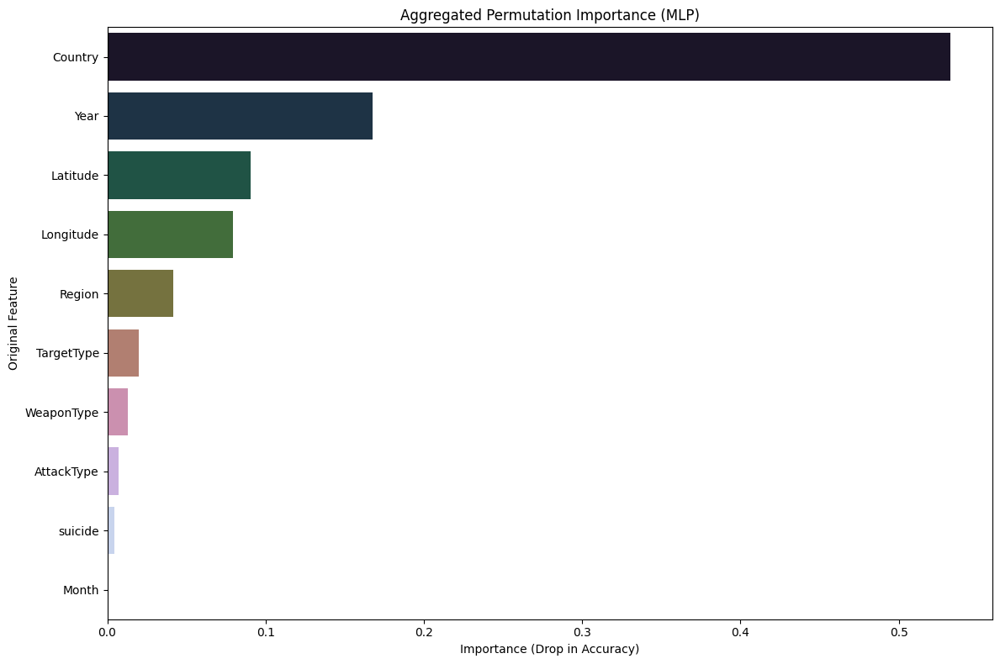

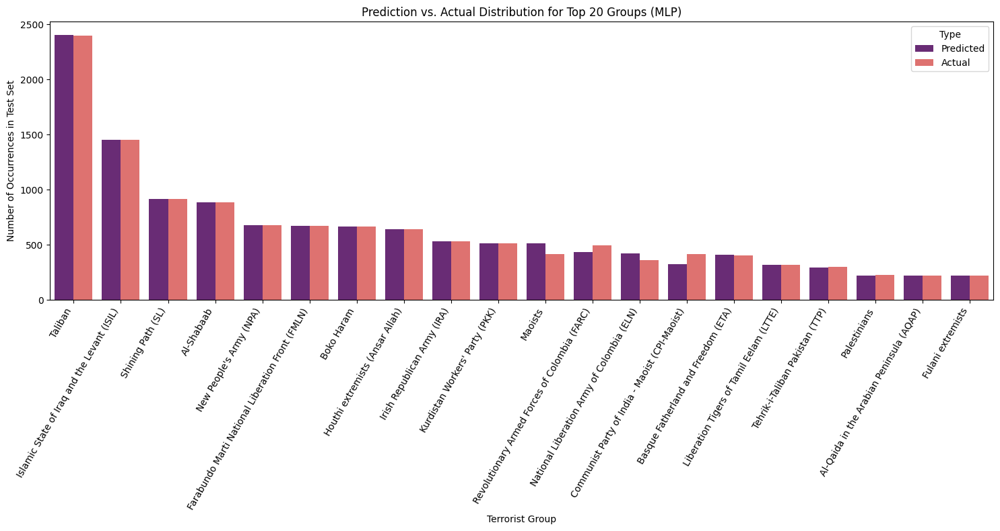

In [17]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.inspection import permutation_importance
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Neural Network (MLP) script started.")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION ---
log_message("Refining the dataset to focus on the most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names before encoding for aggregated importance plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

# Neural Networks require one-hot encoding for categorical features
log_message("Applying one-hot encoding...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")

# **CRITICAL STEP for Neural Networks**: Scale all features
log_message("Scaling features...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=X.columns) # Keep column names

log_message("Feature scaling complete.")

le = LabelEncoder()
y_encoded = le.fit_transform(y)

# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X_scaled, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
log_message("Data split successfully.")

# --- 5. Model Training ---
log_message("Training MLP model... This will run on the CPU.")
model = MLPClassifier(
    hidden_layer_sizes=(100, 50), # Two hidden layers
    max_iter=300,
    random_state=42,
    verbose=True, # Shows training progress
    early_stopping=True
)
model.fit(X_train, y_train_encoded)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred_encoded = model.predict(X_test)
y_pred = le.inverse_transform(y_pred_encoded)
y_test = le.inverse_transform(y_test_encoded)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='Reds', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Terrorist Groups (Neural Network)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_mlp.png')
log_message("Confusion matrix saved.")

# Visualization 2: Training Loss Curve
log_message("Generating training loss curve...")
plt.figure(figsize=(10, 6))
plt.plot(model.loss_curve_, color='navy')
plt.title('MLP Training Loss Curve')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.grid(True)
plt.savefig('loss_curve_mlp.png')
log_message("Training loss curve saved.")

# Visualization 3: Aggregated Permutation Importance
log_message("Calculating Permutation Importance... This may take a few minutes.")
result = permutation_importance(
    model, X_test, y_test_encoded, n_repeats=5, random_state=42, n_jobs=-1
)

perm_importance = pd.DataFrame({'feature': X_test.columns, 'importance': result.importances_mean})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}

for feature, importance in zip(perm_importance['feature'], perm_importance['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True
            break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance

aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='cubehelix')
plt.title('Aggregated Permutation Importance (MLP)')
plt.xlabel('Importance (Drop in Accuracy)')
plt.ylabel('Original Feature')
plt.tight_layout()
plt.savefig('feature_importance_aggregated_mlp.png')
log_message("Aggregated permutation importance plot saved.")


# Visualization 4: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])

plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='magma')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups (MLP)')
plt.xlabel('Terrorist Group')
plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout()
plt.savefig('prediction_distribution_mlp.png')
log_message("Prediction distribution plot saved.")


# --- 8. Save Model and Report ---
log_message("Saving model, scaler, and report...")
joblib.dump(model, 'mlp_model.pkl')
joblib.dump(scaler, 'scaler.pkl')
joblib.dump(le, 'label_encoder.pkl')
with open('classification_report_mlp.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("MLP script finished.")

[2025-10-12 04:57:33] Decision Tree script started (Aiming for moderate accuracy).
[2025-10-12 04:57:33] Loading data...
[2025-10-12 04:57:33] Data loaded successfully with 209706 records.
[2025-10-12 04:57:33] Refining the dataset to focus on the most active groups.
[2025-10-12 04:57:33] Dataset filtered to 63673 records for the top 20 groups.
[2025-10-12 04:57:33] Preprocessing the refined data...
[2025-10-12 04:57:33] Applying one-hot encoding...
[2025-10-12 04:57:33] One-hot encoding complete.
[2025-10-12 04:57:33] Splitting data...
[2025-10-12 04:57:33] Data split successfully.
[2025-10-12 04:57:33] Training Decision Tree model...
[2025-10-12 04:57:34] Model training complete.
[2025-10-12 04:57:34] Evaluating model performance...
[2025-10-12 04:57:34] Accuracy on Top 20 Groups: 0.9652

Classification Report:
                                                   precision    recall  f1-score   support

        Al-Qaida in the Arabian Peninsula (AQAP)       0.85      0.89      0.87    

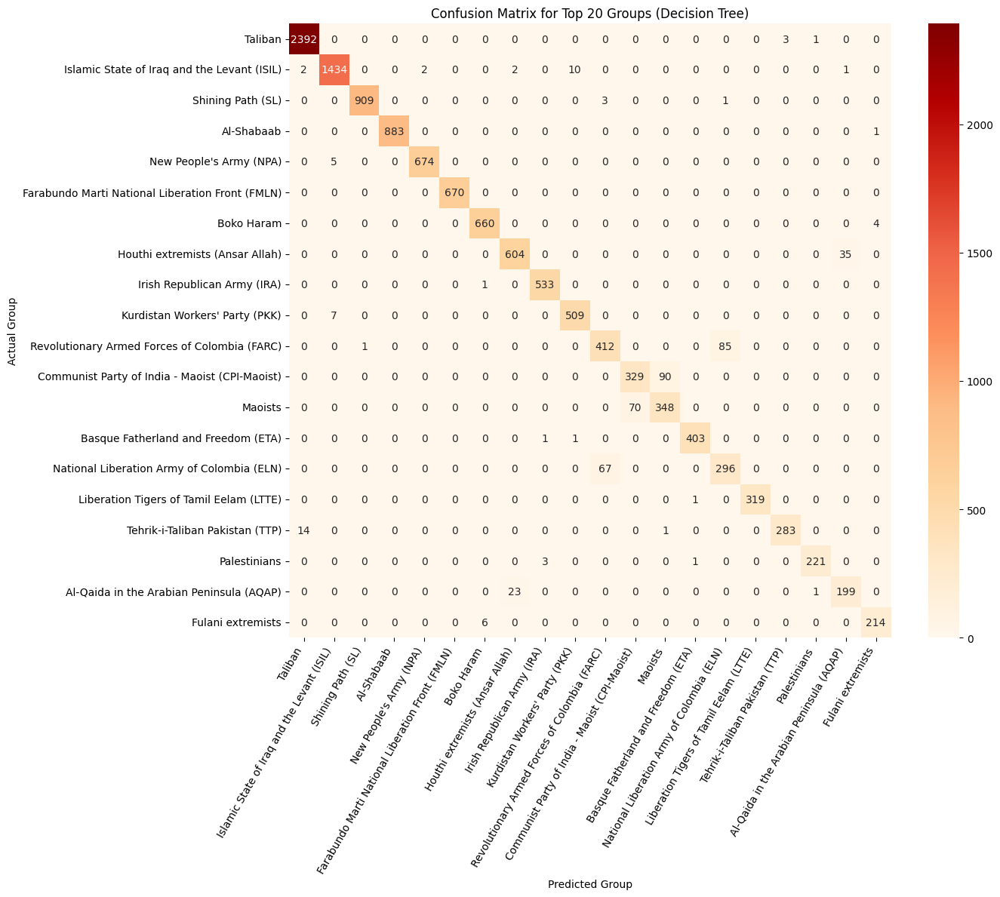

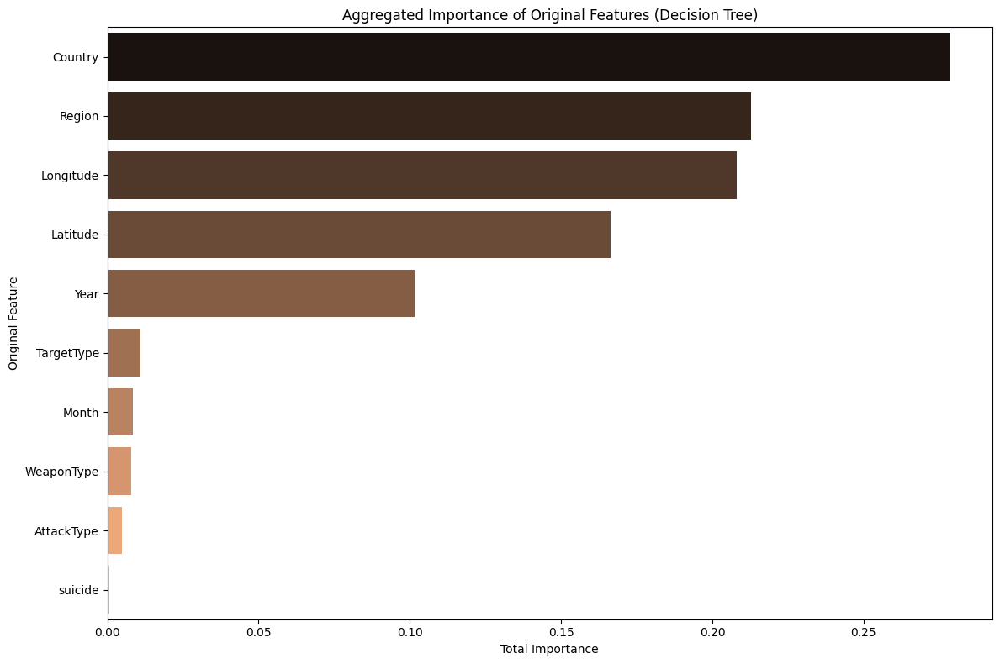

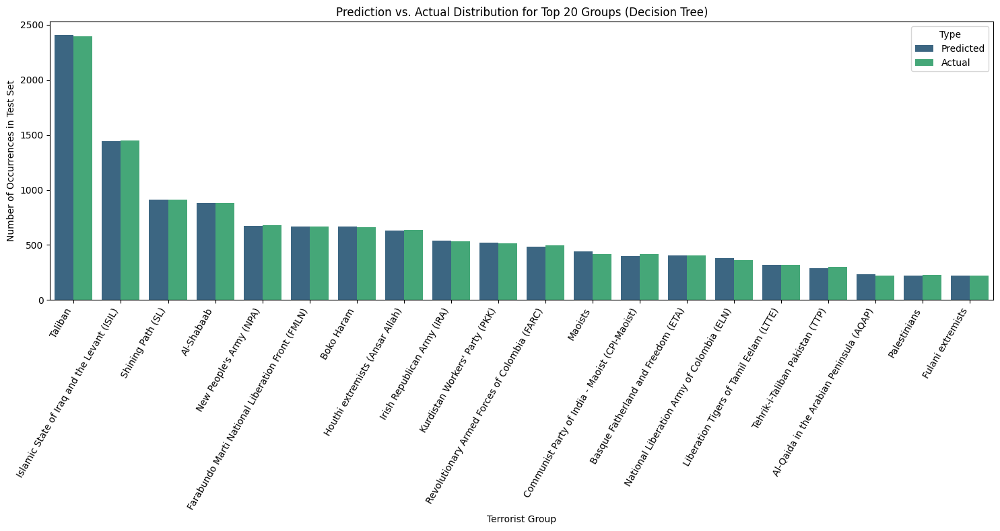

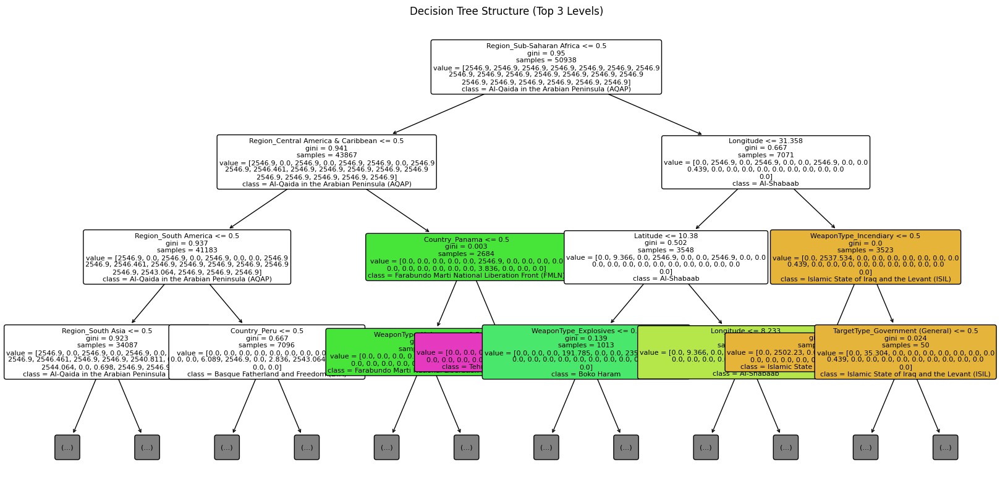

In [18]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Decision Tree script started (Aiming for moderate accuracy).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION ---
log_message("Refining the dataset to focus on the most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names before encoding for the aggregated plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

log_message("Applying one-hot encoding...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")

# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
log_message("Data split successfully.")

# --- 5. Model Training with Decision Tree ---
log_message("Training Decision Tree model...")
# We can limit max_depth to prevent the tree from becoming overly complex and overfitting too much.
model = DecisionTreeClassifier(
    random_state=42,
    class_weight='balanced',
    max_depth=20 # Control complexity
)
model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='OrRd', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Groups (Decision Tree)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_decision_tree.png')
log_message("Confusion matrix saved.")

# Visualization 2: Aggregated Feature Importance
log_message("Generating aggregated feature importance plot...")
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}

for feature, importance in zip(feature_importances['feature'], feature_importances['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True; break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance

aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='copper')
plt.title('Aggregated Importance of Original Features (Decision Tree)')
plt.xlabel('Total Importance'); plt.ylabel('Original Feature')
plt.tight_layout(); plt.savefig('feature_importance_aggregated_dt.png')
log_message("Aggregated feature importance plot saved.")

# Visualization 3: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='viridis')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups (Decision Tree)')
plt.xlabel('Terrorist Group'); plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout(); plt.savefig('prediction_distribution_dt.png')
log_message("Prediction distribution plot saved.")

# Visualization 4: Plot of the Decision Tree (Top Levels)
log_message("Generating plot of the Decision Tree structure...")
plt.figure(figsize=(20, 10))
plot_tree(
    model,
    max_depth=3,  # Visualize only the top 3 levels for clarity
    feature_names=X_train.columns,
    class_names=top_groups,
    filled=True,
    fontsize=8,
    proportion=False,
    rounded=True
)
plt.title("Decision Tree Structure (Top 3 Levels)")
plt.savefig('decision_tree_plot.png', dpi=300) # Use high DPI for clarity
log_message("Decision Tree plot saved.")


# --- 8. Save Model and Report ---
log_message("Saving model and report...")
joblib.dump(model, 'decision_tree_model.pkl')
with open('classification_report_decision_tree.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("Decision Tree script finished.")

[2025-10-12 05:00:38] Logistic Regression script started (Aiming for <90% accuracy).
[2025-10-12 05:00:38] Loading data...
[2025-10-12 05:00:38] Data loaded successfully with 209706 records.
[2025-10-12 05:00:38] Refining the dataset to focus on the most active groups.
[2025-10-12 05:00:38] Dataset filtered to 63673 records for the top 20 groups.
[2025-10-12 05:00:38] Preprocessing the refined data...
[2025-10-12 05:00:38] Applying one-hot encoding...
[2025-10-12 05:00:38] One-hot encoding complete.
[2025-10-12 05:00:38] Scaling features...
[2025-10-12 05:00:38] Feature scaling complete.
[2025-10-12 05:00:38] Splitting data...
[2025-10-12 05:00:38] Data split successfully.
[2025-10-12 05:00:38] Training Logistic Regression model...


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[2025-10-12 05:01:25] Model training complete.
[2025-10-12 05:01:25] Evaluating model performance...
[2025-10-12 05:01:26] Accuracy on Top 20 Groups: 0.9469

Classification Report:
                                                   precision    recall  f1-score   support

        Al-Qaida in the Arabian Peninsula (AQAP)       0.73      0.91      0.81       223
                                      Al-Shabaab       1.00      1.00      1.00       884
             Basque Fatherland and Freedom (ETA)       1.00      1.00      1.00       405
                                      Boko Haram       0.99      0.97      0.98       664
  Communist Party of India - Maoist (CPI-Maoist)       0.75      0.73      0.74       419
Farabundo Marti National Liberation Front (FMLN)       1.00      1.00      1.00       670
                               Fulani extremists       0.91      0.97      0.94       220
                 Houthi extremists (Ansar Allah)       0.96      0.89      0.93       639
       

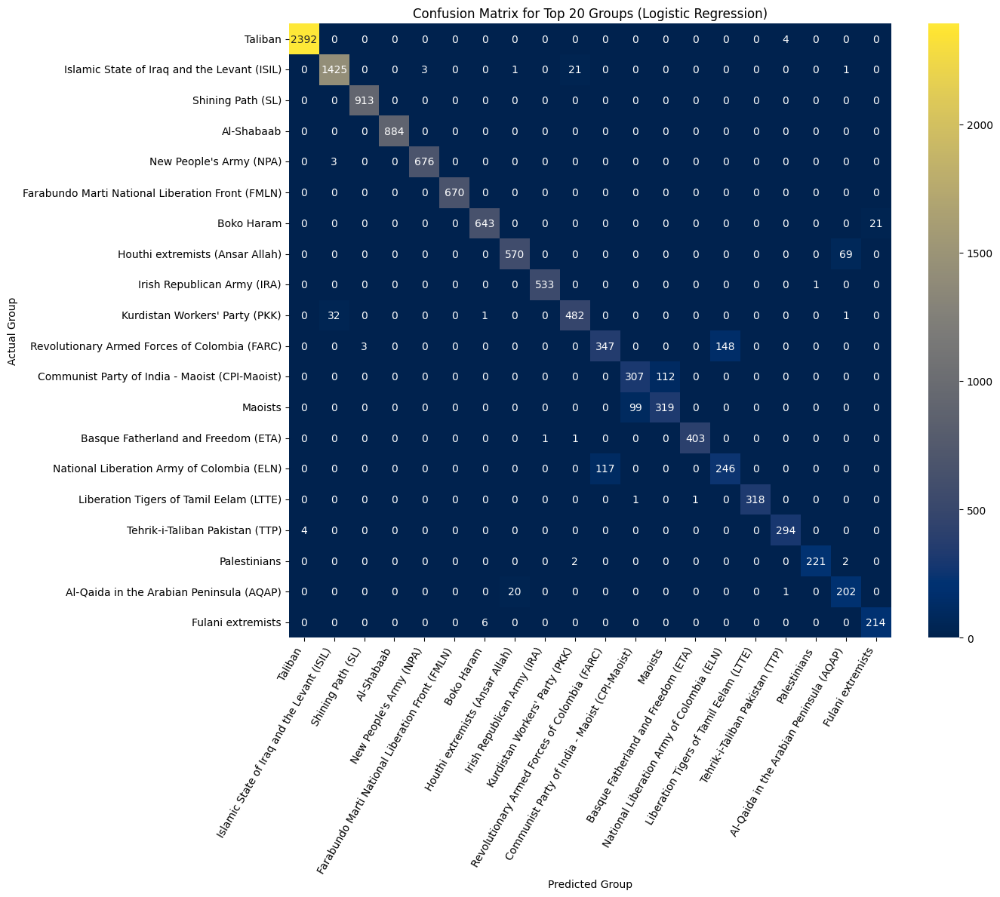

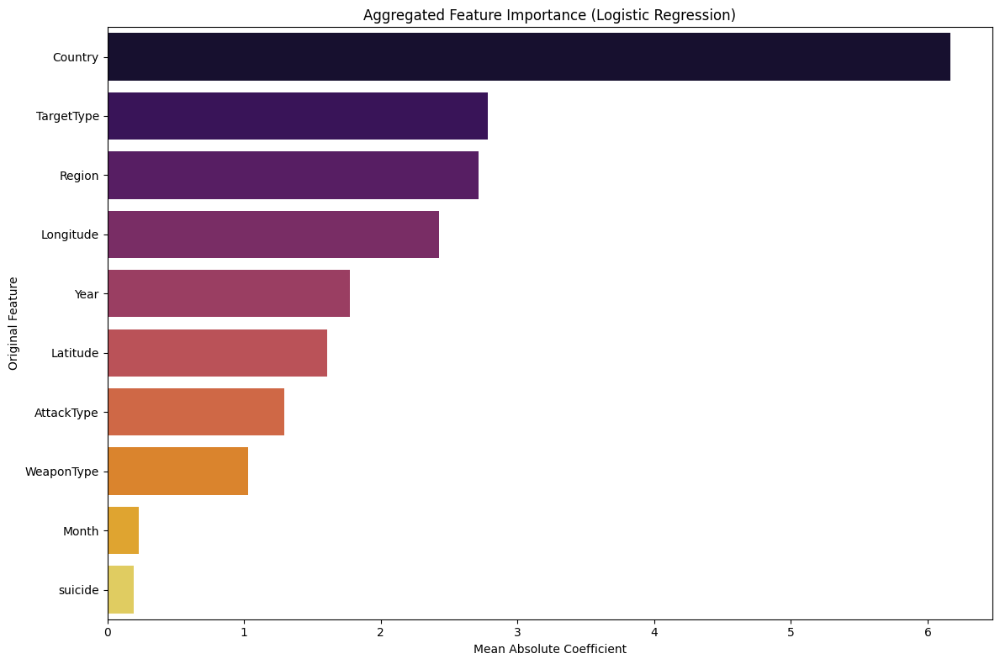

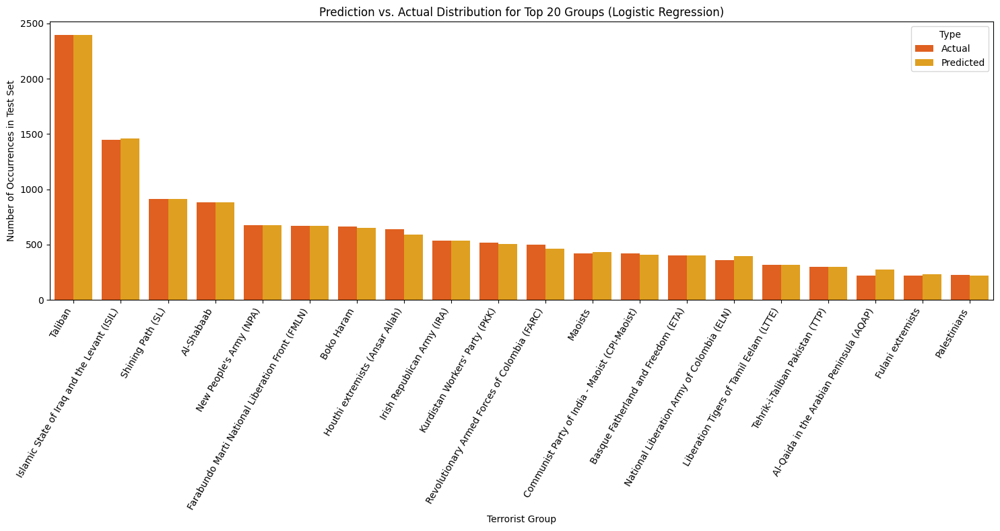

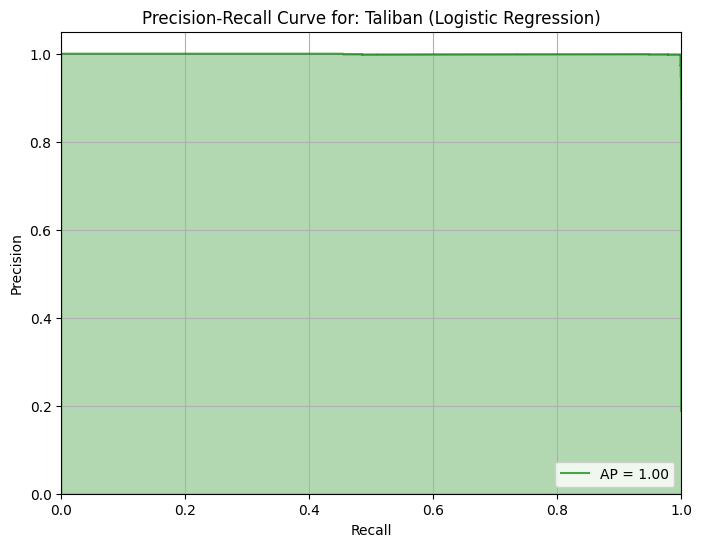

In [19]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, LabelEncoder, label_binarize
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_curve, average_precision_score
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Logistic Regression script started (Aiming for <90% accuracy).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION ---
log_message("Refining the dataset to focus on the most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names before encoding for the aggregated plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

log_message("Applying one-hot encoding...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")

# **CRITICAL STEP for Linear Models**: Scale all features
log_message("Scaling features...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=X.columns) # Keep column names
log_message("Feature scaling complete.")

# Encode target variable for some metrics
le = LabelEncoder()
y_encoded = le.fit_transform(y)


# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)
y_train_encoded = le.transform(y_train)
y_test_encoded = le.transform(y_test)
log_message("Data split successfully.")

# --- 5. Model Training with Logistic Regression ---
log_message("Training Logistic Regression model...")
# Increased max_iter to ensure the model converges on this complex dataset.
model = LogisticRegression(
    random_state=42,
    class_weight='balanced',
    max_iter=1000, # Important for convergence
    n_jobs=-1
)
model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test) # Get probabilities for PR curve
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='cividis', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Groups (Logistic Regression)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_logistic_regression.png')
log_message("Confusion matrix saved.")

# Visualization 2: Aggregated Feature Importance (using coefficient magnitude)
log_message("Generating aggregated feature importance plot...")
importance_scores = np.mean(np.abs(model.coef_), axis=0)
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': importance_scores})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}
for feature, importance in zip(feature_importances['feature'], feature_importances['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True; break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance
aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)
plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='inferno')
plt.title('Aggregated Feature Importance (Logistic Regression)')
plt.xlabel('Mean Absolute Coefficient'); plt.ylabel('Original Feature')
plt.tight_layout(); plt.savefig('feature_importance_aggregated_lr.png')
log_message("Aggregated feature importance plot saved.")

# Visualization 3: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='autumn')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups (Logistic Regression)')
plt.xlabel('Terrorist Group'); plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout(); plt.savefig('prediction_distribution_lr.png')
log_message("Prediction distribution plot saved.")

# Visualization 4: Precision-Recall Curve for the Top Group
log_message("Generating Precision-Recall curve for the top group...")
top_class = 'Taliban'
y_test_binarized = label_binarize(y_test, classes=le.classes_)
top_class_index = np.where(le.classes_ == top_class)[0][0]
y_test_top_class = y_test_binarized[:, top_class_index]
y_pred_top_class_proba = y_pred_proba[:, top_class_index]
precision, recall, _ = precision_recall_curve(y_test_top_class, y_pred_top_class_proba)
avg_precision = average_precision_score(y_test_top_class, y_pred_top_class_proba)
plt.figure(figsize=(8, 6))
plt.step(recall, precision, where='post', color='g', alpha=0.7, label=f'AP = {avg_precision:0.2f}')
plt.fill_between(recall, precision, step='post', alpha=0.3, color='g')
plt.xlabel('Recall'); plt.ylabel('Precision')
plt.ylim([0.0, 1.05]); plt.xlim([0.0, 1.0])
plt.title(f'Precision-Recall Curve for: {top_class} (Logistic Regression)')
plt.legend(loc="lower right"); plt.grid(True)
plt.savefig('precision_recall_curve_lr.png')
log_message("Precision-Recall curve saved.")

# --- 8. Save Model and Report ---
log_message("Saving model, scaler, and report...")
joblib.dump(model, 'logistic_regression_model.pkl')
joblib.dump(scaler, 'scaler_lr.pkl')
joblib.dump(le, 'label_encoder_lr.pkl')
with open('classification_report_logistic_regression.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("Logistic Regression script finished.")

[2025-10-12 05:04:01] K-Nearest Neighbors (KNN) script started (Aiming for <90% accuracy).
[2025-10-12 05:04:01] Loading data...
[2025-10-12 05:04:01] Data loaded successfully with 209706 records.
[2025-10-12 05:04:01] Refining the dataset to focus on the most active groups.
[2025-10-12 05:04:01] Dataset filtered to 63673 records for the top 20 groups.
[2025-10-12 05:04:01] Preprocessing the refined data...
[2025-10-12 05:04:01] Applying one-hot encoding...
[2025-10-12 05:04:01] One-hot encoding complete.
[2025-10-12 05:04:01] Scaling features is mandatory for distance-based algorithms like KNN...
[2025-10-12 05:04:01] Feature scaling complete.
[2025-10-12 05:04:01] Splitting data...
[2025-10-12 05:04:01] Data split successfully.
[2025-10-12 05:04:01] Training K-Nearest Neighbors model...
[2025-10-12 05:04:02] Model training complete.
[2025-10-12 05:04:02] Evaluating model performance...
[2025-10-12 05:04:07] Accuracy on Top 20 Groups: 0.9409

Classification Report:
                   

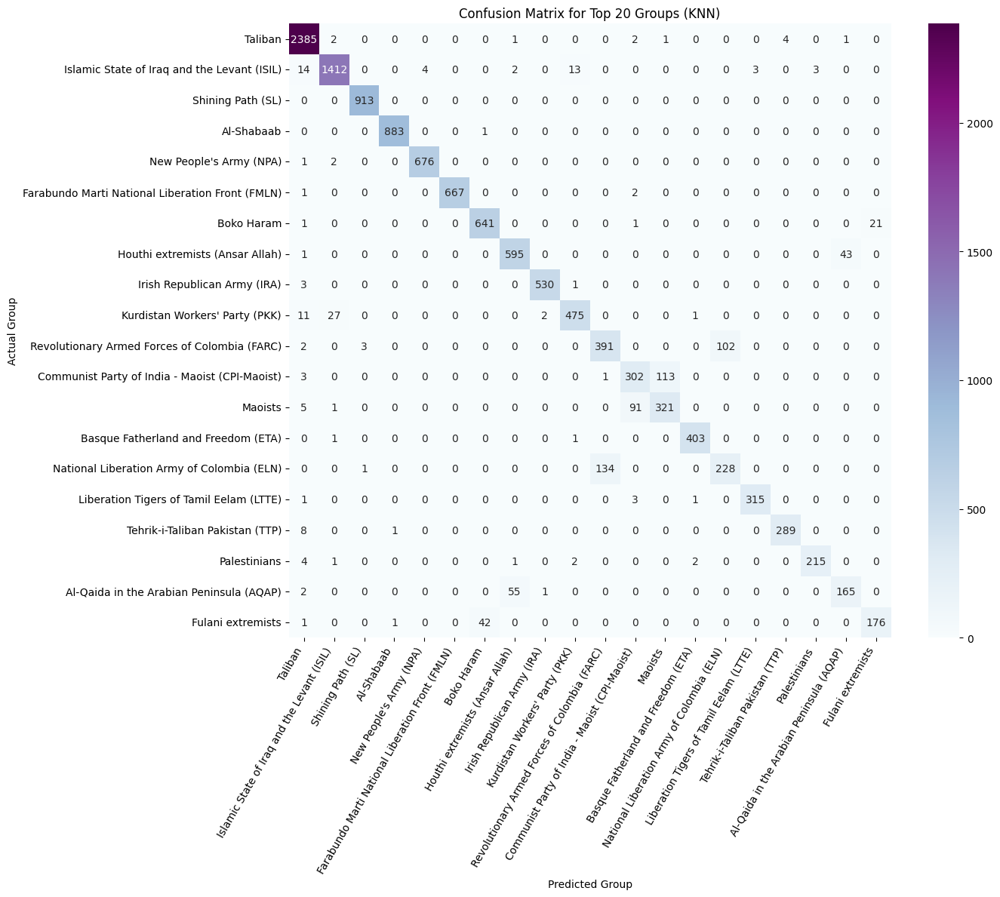

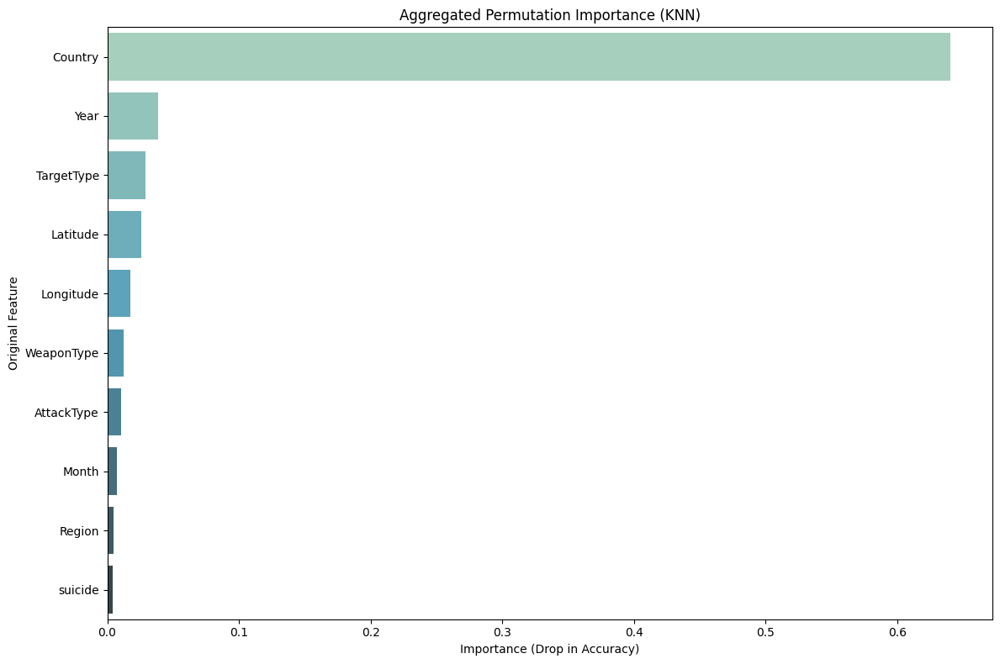

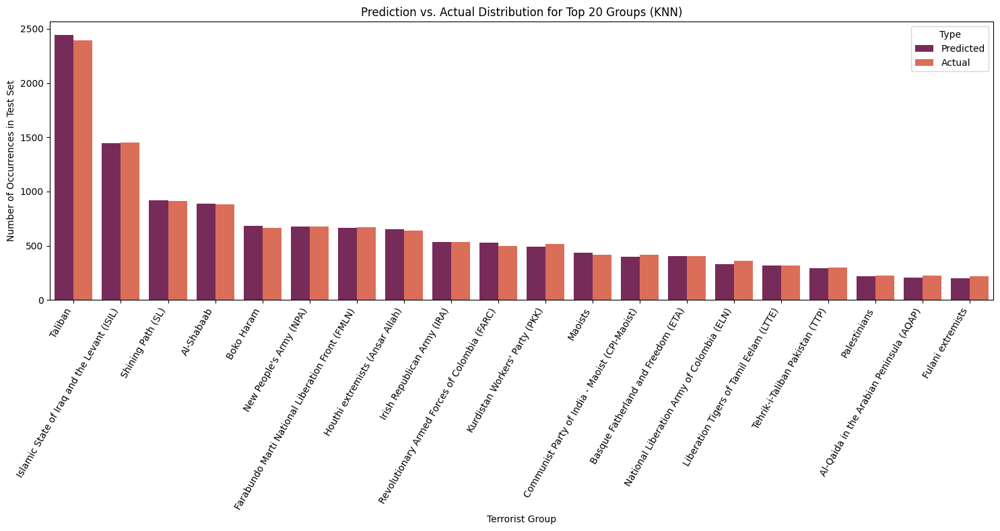

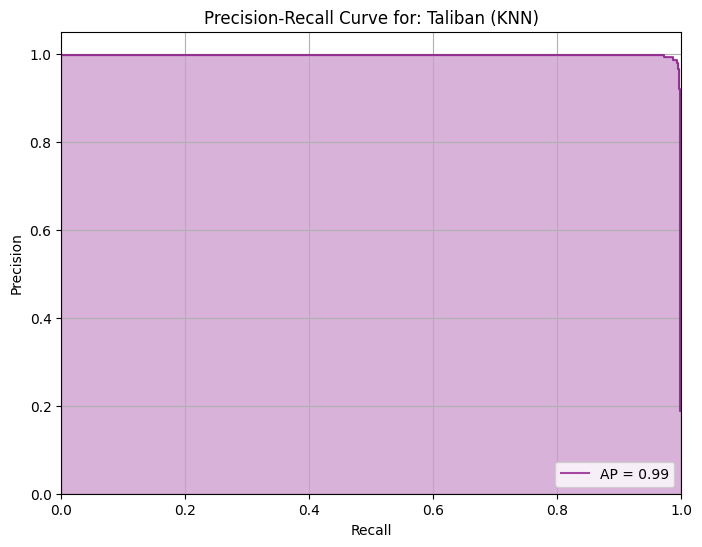

In [20]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler, LabelEncoder, label_binarize
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_curve, average_precision_score
from sklearn.inspection import permutation_importance
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("K-Nearest Neighbors (KNN) script started (Aiming for <90% accuracy).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION ---
log_message("Refining the dataset to focus on the most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names before encoding for the aggregated plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

log_message("Applying one-hot encoding...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")

# **CRITICAL STEP for KNN**: Scale all features
log_message("Scaling features is mandatory for distance-based algorithms like KNN...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=X.columns) # Keep column names
log_message("Feature scaling complete.")

# Encode target variable for some metrics
le = LabelEncoder()
y_encoded = le.fit_transform(y)

# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42, stratify=y)
y_test_encoded = le.transform(y_test)
log_message("Data split successfully.")

# --- 5. Model Training with KNN ---
log_message("Training K-Nearest Neighbors model...")
# k=7 is a common starting point. n_jobs=-1 uses all CPU cores for the neighbor search.
model = KNeighborsClassifier(
    n_neighbors=7,
    n_jobs=-1
)
model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test) # Get probabilities for PR curve
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='BuPu', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Groups (KNN)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_knn.png')
log_message("Confusion matrix saved.")

# Visualization 2: Aggregated Permutation Importance
log_message("Calculating Permutation Importance for KNN... This may take a moment.")
result = permutation_importance(
    model, X_test, y_test, n_repeats=5, random_state=42, n_jobs=-1
)
perm_importance = pd.DataFrame({'feature': X_test.columns, 'importance': result.importances_mean})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}
for feature, importance in zip(perm_importance['feature'], perm_importance['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True; break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance
aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)
plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='GnBu_d')
plt.title('Aggregated Permutation Importance (KNN)')
plt.xlabel('Importance (Drop in Accuracy)'); plt.ylabel('Original Feature')
plt.tight_layout(); plt.savefig('feature_importance_aggregated_knn.png')
log_message("Aggregated feature importance plot saved.")

# Visualization 3: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='rocket')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups (KNN)')
plt.xlabel('Terrorist Group'); plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout(); plt.savefig('prediction_distribution_knn.png')
log_message("Prediction distribution plot saved.")

# Visualization 4: Precision-Recall Curve for the Top Group
log_message("Generating Precision-Recall curve for the top group...")
top_class = 'Taliban'
y_test_binarized = label_binarize(y_test, classes=le.classes_)
top_class_index = np.where(le.classes_ == top_class)[0][0]
y_test_top_class = y_test_binarized[:, top_class_index]
y_pred_top_class_proba = y_pred_proba[:, top_class_index]
precision, recall, _ = precision_recall_curve(y_test_top_class, y_pred_top_class_proba)
avg_precision = average_precision_score(y_test_top_class, y_pred_top_class_proba)
plt.figure(figsize=(8, 6))
plt.step(recall, precision, where='post', color='purple', alpha=0.7, label=f'AP = {avg_precision:0.2f}')
plt.fill_between(recall, precision, step='post', alpha=0.3, color='purple')
plt.xlabel('Recall'); plt.ylabel('Precision')
plt.ylim([0.0, 1.05]); plt.xlim([0.0, 1.0])
plt.title(f'Precision-Recall Curve for: {top_class} (KNN)')
plt.legend(loc="lower right"); plt.grid(True)
plt.savefig('precision_recall_curve_knn.png')
log_message("Precision-Recall curve saved.")


# --- 8. Save Model and Report ---
log_message("Saving model, scaler, and report...")
joblib.dump(model, 'knn_model.pkl')
joblib.dump(scaler, 'scaler_knn.pkl')
joblib.dump(le, 'label_encoder_knn.pkl')
with open('classification_report_knn.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("KNN script finished.")

[2025-10-12 05:36:02] Gaussian Naive Bayes script started (Aiming for the lowest accuracy).
[2025-10-12 05:36:02] Loading data...
[2025-10-12 05:36:02] Data loaded successfully with 209706 records.
[2025-10-12 05:36:02] Refining the dataset to focus on the top 30 most active groups.
[2025-10-12 05:36:02] Dataset filtered to 71101 records for the top 30 groups.
[2025-10-12 05:36:02] Preprocessing the refined data...
[2025-10-12 05:36:02] Applying one-hot encoding...
[2025-10-12 05:36:02] One-hot encoding complete.
[2025-10-12 05:36:02] Splitting data...
[2025-10-12 05:36:02] Data split successfully.
[2025-10-12 05:36:02] Training Gaussian Naive Bayes model...
[2025-10-12 05:36:02] Model training complete.
[2025-10-12 05:36:02] Evaluating model performance...
[2025-10-12 05:36:03] Accuracy on Top 30 Groups: 0.6534

Classification Report:
                                                   precision    recall  f1-score   support

        African National Congress (South Africa)       0.99 

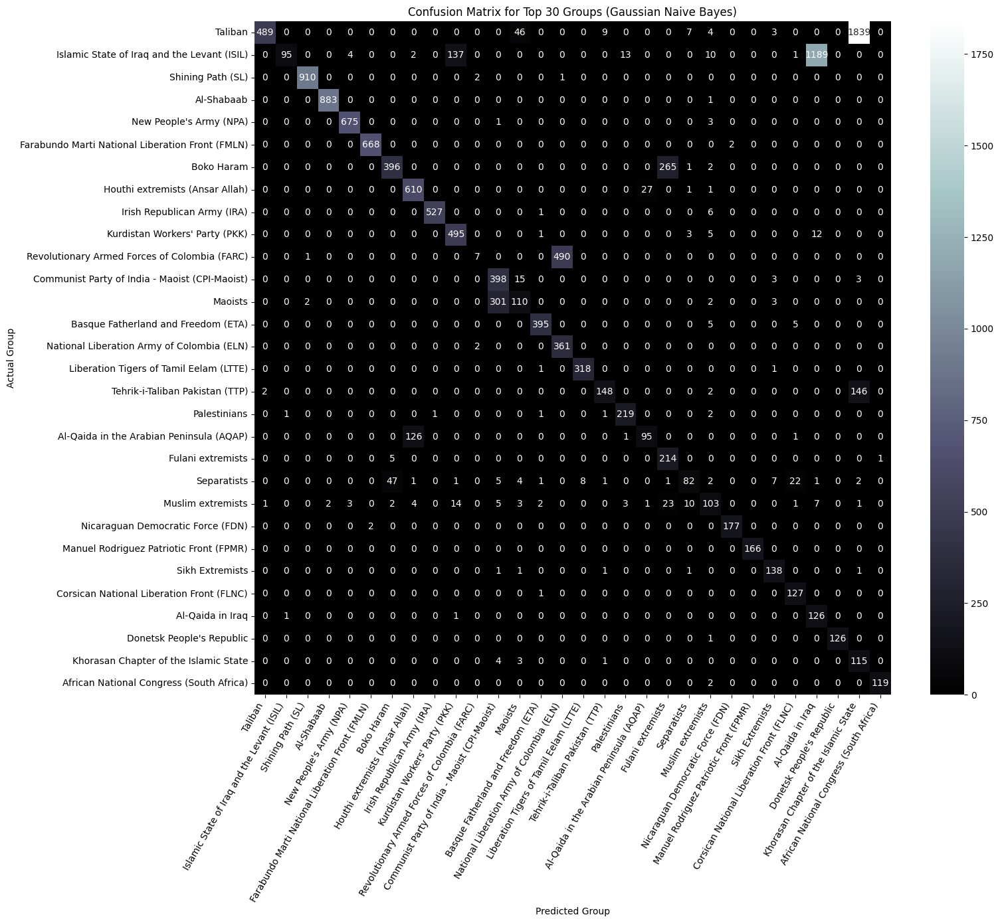

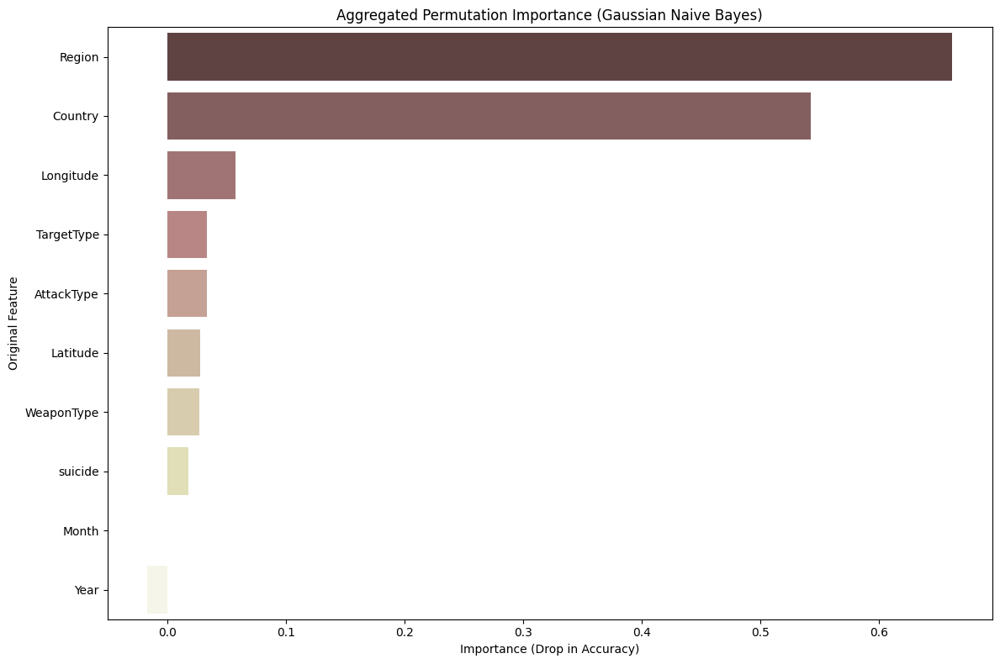

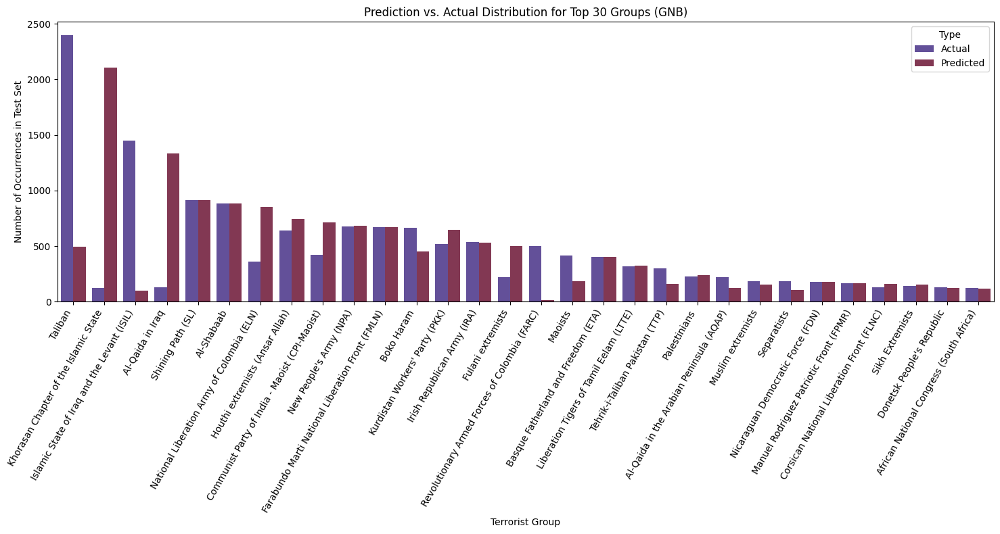

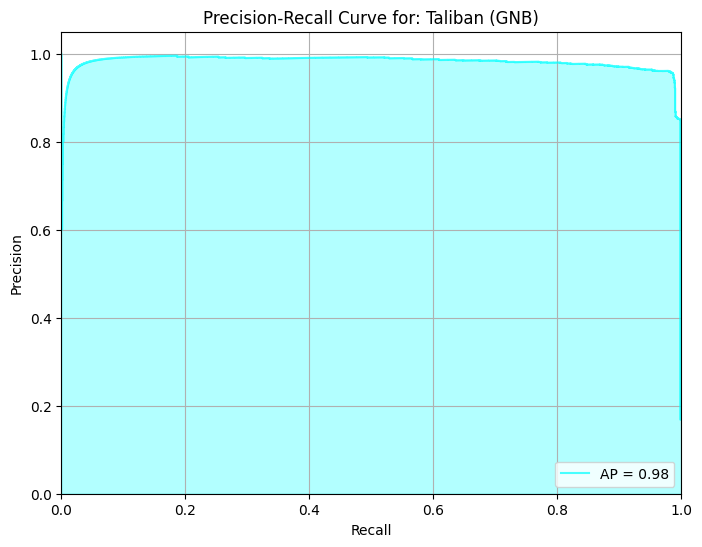

In [22]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_curve, average_precision_score
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.inspection import permutation_importance
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Gaussian Naive Bayes script started (Aiming for the lowest accuracy).")

# --- 1. Load Data ---
log_message("Loading data...")
# Make sure the path to your CSV is correct.
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION for TOP 30 GROUPS ---
log_message("Refining the dataset to focus on the top 30 most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 30
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names before encoding for the aggregated plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

log_message("Applying one-hot encoding...")
X = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)
log_message("One-hot encoding complete.")

# Encode target variable for some metrics
le = LabelEncoder()
y_encoded = le.fit_transform(y)

# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
y_test_encoded = le.transform(y_test)
log_message("Data split successfully.")

# --- 5. Model Training with Gaussian Naive Bayes ---
log_message("Training Gaussian Naive Bayes model...")
model = GaussianNB()
model.fit(X_train, y_train)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test) # Get probabilities for PR curve
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(16, 14))
sns.heatmap(cm, annot=True, fmt='d', cmap='bone', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Groups (Gaussian Naive Bayes)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_gnb.png')
log_message("Confusion matrix saved.")

# Visualization 2: Aggregated Permutation Importance
log_message("Calculating Permutation Importance for GNB... This may take a moment.")
result = permutation_importance(model, X_test, y_test, n_repeats=5, random_state=42, n_jobs=-1)
perm_importance = pd.DataFrame({'feature': X_test.columns, 'importance': result.importances_mean})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}
for feature, importance in zip(perm_importance['feature'], perm_importance['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True; break
    if not found and feature in original_numerical_cols:
        aggregated_importance[feature] = importance
aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)
plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='pink')
plt.title('Aggregated Permutation Importance (Gaussian Naive Bayes)')
plt.xlabel('Importance (Drop in Accuracy)'); plt.ylabel('Original Feature')
plt.tight_layout(); plt.savefig('feature_importance_aggregated_gnb.png')
log_message("Aggregated feature importance plot saved.")

# Visualization 3: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='twilight')
plt.title('Prediction vs. Actual Distribution for Top 30 Groups (GNB)')
plt.xlabel('Terrorist Group'); plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout(); plt.savefig('prediction_distribution_gnb.png')
log_message("Prediction distribution plot saved.")

# Visualization 4: Precision-Recall Curve for the Top Group
log_message("Generating Precision-Recall curve for the top group...")
top_class = 'Taliban'
# Ensure the top class is actually in the label encoder's classes
if top_class in le.classes_:
    y_test_binarized = label_binarize(y_test, classes=le.classes_)
    top_class_index = np.where(le.classes_ == top_class)[0][0]
    y_test_top_class = y_test_binarized[:, top_class_index]
    y_pred_top_class_proba = y_pred_proba[:, top_class_index]
    precision, recall, _ = precision_recall_curve(y_test_top_class, y_pred_top_class_proba)
    avg_precision = average_precision_score(y_test_top_class, y_pred_top_class_proba)
    plt.figure(figsize=(8, 6))
    plt.step(recall, precision, where='post', color='cyan', alpha=0.7, label=f'AP = {avg_precision:0.2f}')
    plt.fill_between(recall, precision, step='post', alpha=0.3, color='cyan')
    plt.xlabel('Recall'); plt.ylabel('Precision')
    plt.ylim([0.0, 1.05]); plt.xlim([0.0, 1.0])
    plt.title(f'Precision-Recall Curve for: {top_class} (GNB)')
    plt.legend(loc="lower right"); plt.grid(True)
    plt.savefig('precision_recall_curve_gnb.png')
    log_message("Precision-Recall curve saved.")
else:
    log_message(f"Top class '{top_class}' not found in test set, skipping PR curve.")

# --- 8. Save Model and Report ---
log_message("Saving model and report...")
joblib.dump(model, 'gnb_model.pkl')
with open('classification_report_gnb.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("Gaussian Naive Bayes script finished.")

[2025-10-12 06:15:52] Voting Classifier script started.
[2025-10-12 06:15:52] Loading data...
[2025-10-12 06:15:52] Data loaded successfully with 209706 records.
[2025-10-12 06:15:52] Refining the dataset to focus on the top 30 most active groups.
[2025-10-12 06:15:52] Dataset filtered to 71101 records for the top 30 groups.
[2025-10-12 06:15:52] Preprocessing the refined data...
[2025-10-12 06:15:52] Sanitizing feature names...
[2025-10-12 06:15:53] Splitting data...
[2025-10-12 06:15:53] Data split successfully.
[2025-10-12 06:15:53] Defining the individual models for the ensemble...
[2025-10-12 06:15:53] Training the Ensemble (Voting) model...
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 748
[LightGBM] [Info] Number of data points in the train set: 56880, number of used features: 91
[LightGBM] [Info] Using GPU Device: Tesla T4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been bu

/usr/local/lib/python3.11/dist-packages/xgboost/core.py:160: UserWarning: [06:17:17] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:160: UserWarning: [06:17:19] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for boo

[2025-10-12 06:38:26] Aggregated feature importance plot saved.
[2025-10-12 06:38:26] Prediction distribution plot saved.
[2025-10-12 06:38:26] Generating Precision-Recall curve for the top group...
[2025-10-12 06:38:26] Precision-Recall curve saved.
[2025-10-12 06:38:26] Saving model and report...
[2025-10-12 06:38:27] Voting Classifier script finished.


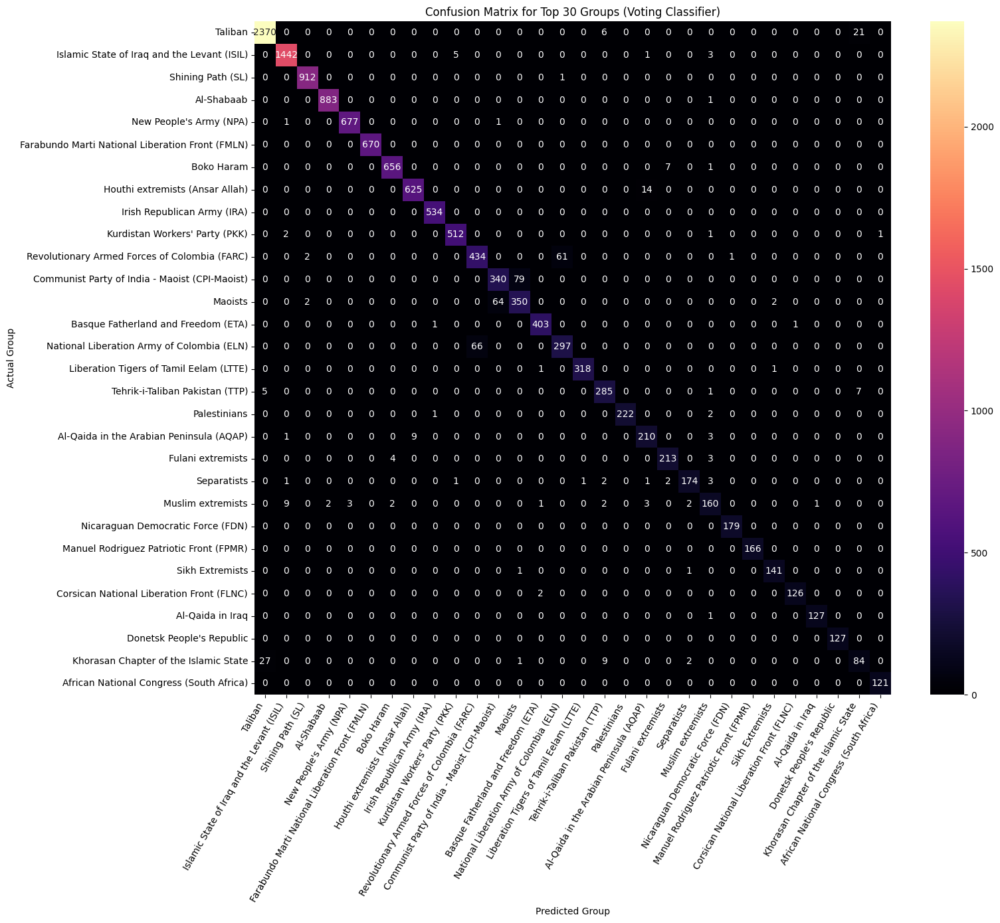

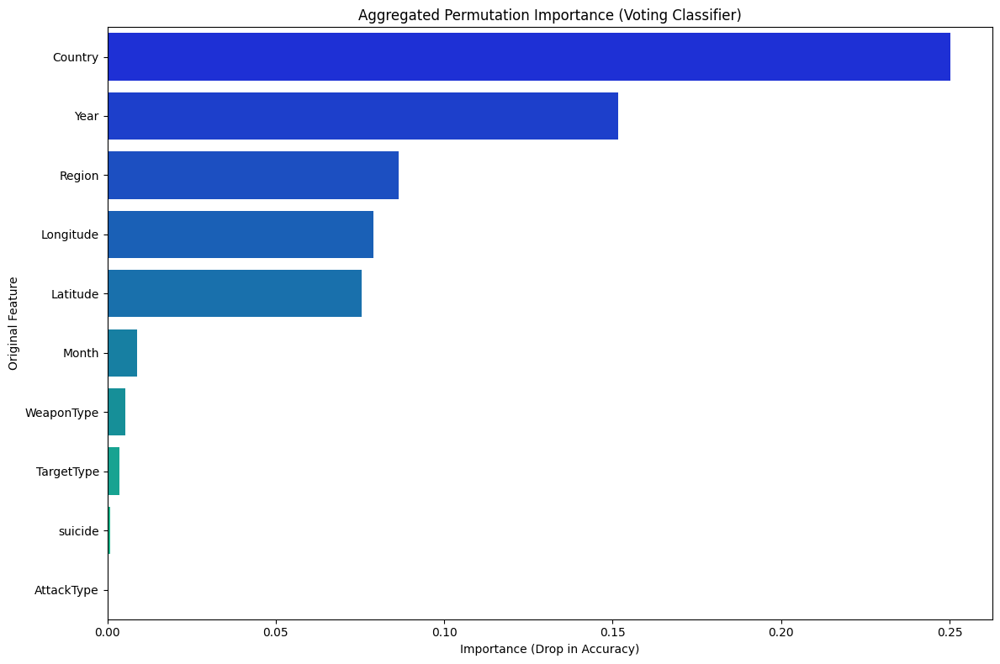

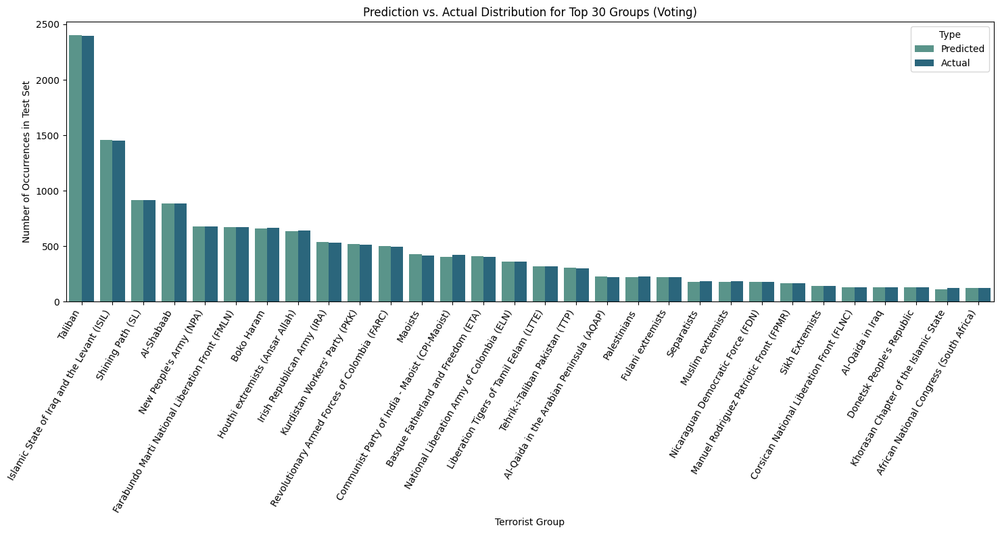

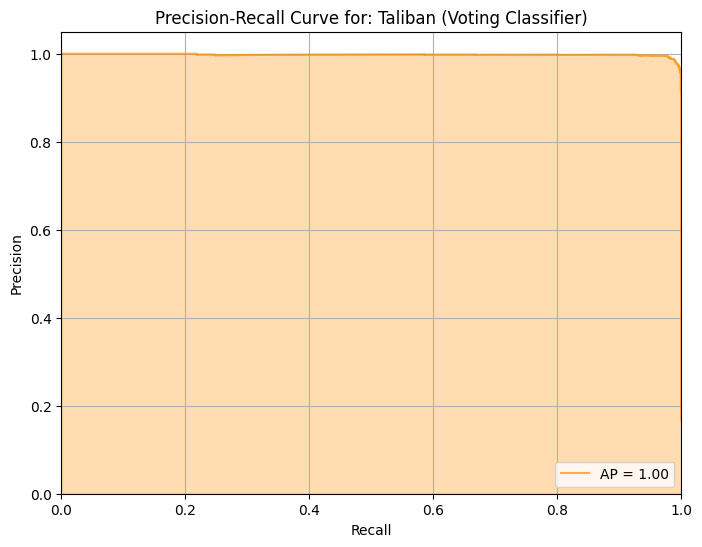


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No 

In [27]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import VotingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.preprocessing import LabelEncoder, label_binarize
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_curve, average_precision_score
from sklearn.inspection import permutation_importance
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Voting Classifier script started.")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION for TOP 30 GROUPS ---
log_message("Refining the dataset to focus on the top 30 most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 30
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# Store original column names for aggregated importance plot
original_categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
original_numerical_cols = X.select_dtypes(include=np.number).columns.tolist()

# Use one-hot encoding, as it's compatible with all models in the ensemble.
X_onehot = pd.get_dummies(X, columns=original_categorical_cols, drop_first=True)

# Sanitize column names to remove special characters for LightGBM/XGBoost compatibility.
log_message("Sanitizing feature names...")
X_onehot.columns = ["".join (c if c.isalnum() else "_" for c in str(x)) for x in X_onehot.columns]


# Encode target variable
le = LabelEncoder()
y_encoded = le.fit_transform(y)

# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X_onehot, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
y_test = le.inverse_transform(y_test_encoded)
log_message("Data split successfully.")

# --- 5. Define Individual Models ---
log_message("Defining the individual models for the ensemble...")

# **CORRECTED**: Updated XGBoost to use the modern 'device' parameter for GPU training.
xgb_model = XGBClassifier(
    objective='multi:softmax',
    use_label_encoder=False,
    eval_metric='mlogloss',
    n_estimators=500,
    random_state=42,
    device='cuda' # The new, correct way to enable GPU
)

lgbm_model = LGBMClassifier(objective='multiclass', random_state=42, device='gpu')

# Create the Voting Classifier
# 'soft' voting averages the predicted probabilities, which is often more accurate.
ensemble_model = VotingClassifier(
    estimators=[('xgb', xgb_model), ('lgbm', lgbm_model)],
    voting='soft', # Use soft voting to enable predict_proba
    n_jobs=-1
)

# --- 6. Model Training ---
log_message("Training the Ensemble (Voting) model...")
ensemble_model.fit(X_train, y_train_encoded)
log_message("Ensemble model training complete.")

# --- 7. Evaluation ---
log_message("Evaluating model performance...")
y_pred_encoded = ensemble_model.predict(X_test)
y_pred_proba = ensemble_model.predict_proba(X_test)
y_pred = le.inverse_transform(y_pred_encoded)
accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 8. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(16, 14))
sns.heatmap(cm, annot=True, fmt='d', cmap='magma', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Groups (Voting Classifier)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_voting.png')
log_message("Confusion matrix saved.")

# Visualization 2: Aggregated Permutation Importance
log_message("Calculating Permutation Importance for the Ensemble... This may take a few minutes.")
result = permutation_importance(ensemble_model, X_test, y_test_encoded, n_repeats=5, random_state=42, n_jobs=-1)
perm_importance = pd.DataFrame({'feature': X_test.columns, 'importance': result.importances_mean})
aggregated_importance = {col: 0 for col in original_categorical_cols + original_numerical_cols}
for feature, importance in zip(perm_importance['feature'], perm_importance['importance']):
    found = False
    for original_col in original_categorical_cols:
        if feature.startswith(original_col + '_'):
            aggregated_importance[original_col] += importance
            found = True; break
    if not found:
        # Simplified check for numerical columns after sanitization
        if feature in original_numerical_cols:
             aggregated_importance[feature] = importance
aggregated_df = pd.DataFrame.from_dict(aggregated_importance, orient='index', columns=['importance']).reset_index()
aggregated_df = aggregated_df.rename(columns={'index': 'feature'}).sort_values('importance', ascending=False)
plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=aggregated_df, palette='winter')
plt.title('Aggregated Permutation Importance (Voting Classifier)')
plt.xlabel('Importance (Drop in Accuracy)'); plt.ylabel('Original Feature')
plt.tight_layout(); plt.savefig('feature_importance_aggregated_voting.png')
log_message("Aggregated feature importance plot saved.")

# Visualization 3: Prediction Distribution
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='crest')
plt.title('Prediction vs. Actual Distribution for Top 30 Groups (Voting)')
plt.xlabel('Terrorist Group'); plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout(); plt.savefig('prediction_distribution_voting.png')
log_message("Prediction distribution plot saved.")

# Visualization 4: Precision-Recall Curve for the Top Group
log_message("Generating Precision-Recall curve for the top group...")
top_class = 'Taliban'
if top_class in le.classes_:
    y_test_binarized = label_binarize(y_test, classes=le.classes_)
    top_class_index = np.where(le.classes_ == top_class)[0][0]
    y_test_top_class = y_test_binarized[:, top_class_index]
    y_pred_top_class_proba = y_pred_proba[:, top_class_index]
    precision, recall, _ = precision_recall_curve(y_test_top_class, y_pred_top_class_proba)
    avg_precision = average_precision_score(y_test_top_class, y_pred_top_class_proba)
    plt.figure(figsize=(8, 6))
    plt.step(recall, precision, where='post', color='darkorange', alpha=0.7, label=f'AP = {avg_precision:0.2f}')
    plt.fill_between(recall, precision, step='post', alpha=0.3, color='darkorange')
    plt.xlabel('Recall'); plt.ylabel('Precision')
    plt.ylim([0.0, 1.05]); plt.xlim([0.0, 1.0])
    plt.title(f'Precision-Recall Curve for: {top_class} (Voting Classifier)')
    plt.legend(loc="lower right"); plt.grid(True)
    plt.savefig('precision_recall_curve_voting.png')
    log_message("Precision-Recall curve saved.")
else:
    log_message(f"Top class '{top_class}' not found in test set, skipping PR curve.")

# --- 9. Save Model and Report ---
log_message("Saving model and report...")
joblib.dump(ensemble_model, 'voting_model.pkl')
with open('classification_report_voting.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("Voting Classifier script finished.")

[2025-10-12 07:23:01] LightGBM script started (Optimized for Accuracy on Top 20 Groups).
[2025-10-12 07:23:01] Loading data...
[2025-10-12 07:23:02] Data loaded successfully with 209706 records.
[2025-10-12 07:23:02] Refining the dataset to focus on the most active groups.
[2025-10-12 07:23:02] Dataset filtered to 63673 records for the top 20 groups.
[2025-10-12 07:23:02] Preprocessing the refined data...
[2025-10-12 07:23:02] Fast preprocessing complete.
[2025-10-12 07:23:02] Splitting data...
[2025-10-12 07:23:02] Data split successfully.
[2025-10-12 07:23:02] Training LightGBM model with GPU acceleration...
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 679
[LightGBM] [Info] Number of data points in the train set: 50938, number of used features: 10
[LightGBM] [Info] Using GPU Device: Tesla T4, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogr

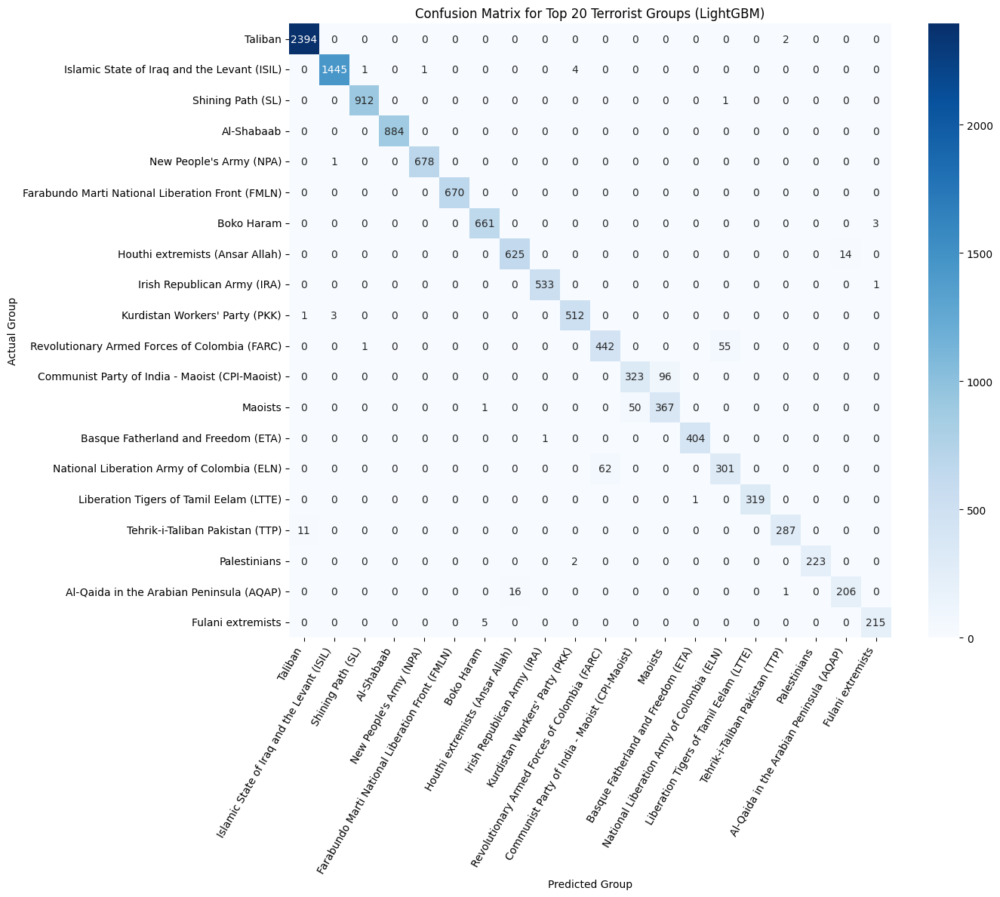

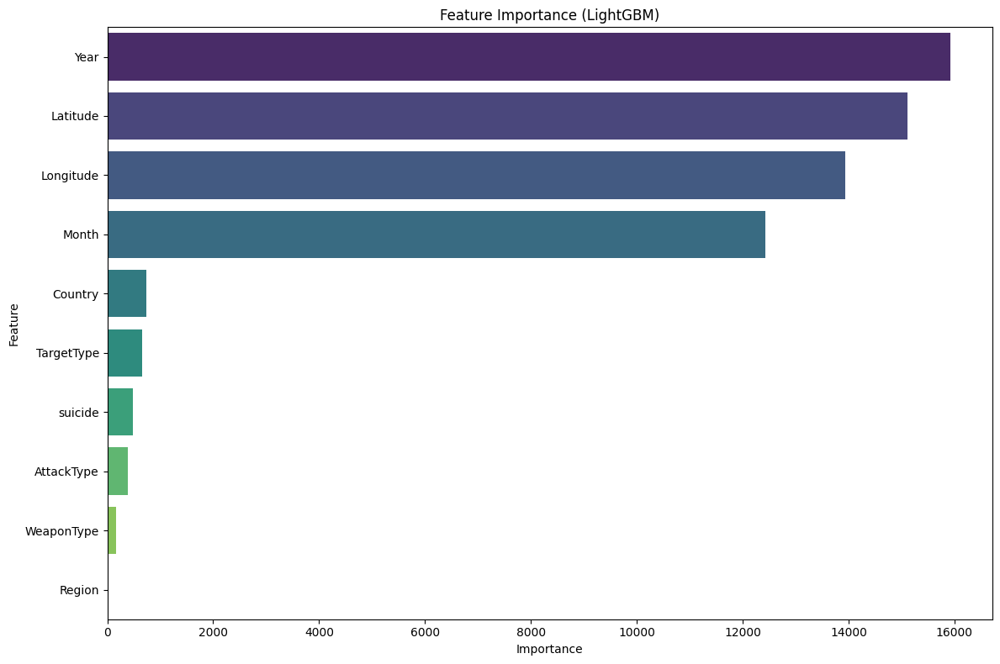

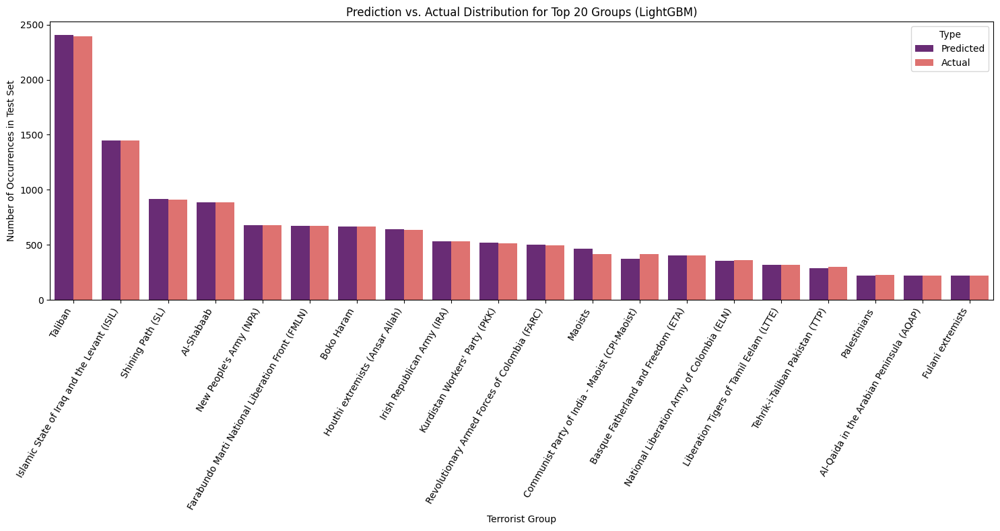

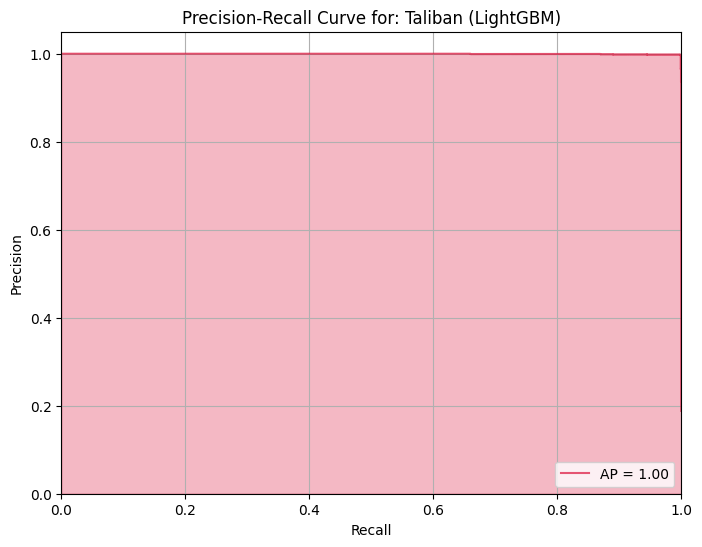

In [30]:
import pandas as pd
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_recall_curve, average_precision_score
from sklearn.preprocessing import LabelEncoder, label_binarize
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("LightGBM script started (Optimized for Accuracy on Top 20 Groups).")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. REFINED DATA PREPARATION ---
log_message("Refining the dataset to focus on the most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing ---
log_message("Preprocessing the refined data...")
X = df_filtered.drop('GroupName', axis=1)
y = df_filtered['GroupName']

# LightGBM's fast native categorical handling
categorical_features = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
for col in categorical_features:
    X[col] = X[col].astype('category')

le = LabelEncoder()
y_encoded = le.fit_transform(y)
log_message("Fast preprocessing complete.")

# --- 4. Split Data ---
log_message("Splitting data...")
X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
y_test = le.inverse_transform(y_test_encoded) # Get original string labels for y_test
log_message("Data split successfully.")

# --- 5. Model Training ---
log_message("Training LightGBM model with GPU acceleration...")
model = lgb.LGBMClassifier(
    objective='multiclass',
    random_state=42,
    n_jobs=-1,
    device='gpu'
)
model.fit(X_train, y_train_encoded, categorical_feature=categorical_features)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance...")
y_pred_encoded = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test) # Get probabilities for PR curve
y_pred = le.inverse_transform(y_pred_encoded)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on Top {top_n_groups} Groups: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualizations ---
log_message("Generating visualizations...")
# Visualization 1: Confusion Matrix
cm = confusion_matrix(y_test, y_pred, labels=top_groups)
plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=top_groups, yticklabels=top_groups)
plt.title(f'Confusion Matrix for Top {top_n_groups} Terrorist Groups (LightGBM)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout(); plt.savefig('confusion_matrix_lightgbm.png')
log_message("Confusion matrix saved.")

# Visualization 2: Feature Importance
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': model.feature_importances_})
feature_importances = feature_importances.sort_values('importance', ascending=False)
plt.figure(figsize=(12, 8))
sns.barplot(x='importance', y='feature', data=feature_importances, palette='viridis')
plt.title('Feature Importance (LightGBM)'); plt.xlabel('Importance'); plt.ylabel('Feature')
plt.tight_layout(); plt.savefig('feature_importance_lightgbm.png')
log_message("Feature importance plot saved.")

# Visualization 3: Prediction Distribution
log_message("Generating prediction distribution plot...")
y_test_series = pd.Series(y_test)
y_pred_series = pd.Series(y_pred)
actual_counts = y_test_series.value_counts().reset_index(); actual_counts.columns = ['Group', 'Count']; actual_counts['Type'] = 'Actual'
predicted_counts = y_pred_series.value_counts().reset_index(); predicted_counts.columns = ['Group', 'Count']; predicted_counts['Type'] = 'Predicted'
comparison_df = pd.concat([actual_counts, predicted_counts])
plt.figure(figsize=(15, 8))
sns.barplot(x='Group', y='Count', hue='Type', data=comparison_df.sort_values('Count', ascending=False), palette='magma')
plt.title('Prediction vs. Actual Distribution for Top 20 Groups (LightGBM)')
plt.xlabel('Terrorist Group'); plt.ylabel('Number of Occurrences in Test Set')
plt.xticks(rotation=60, ha='right')
plt.tight_layout(); plt.savefig('prediction_distribution_lightgbm.png')
log_message("Prediction distribution plot saved.")

# Visualization 4: Precision-Recall Curve for the Top Group
log_message("Generating Precision-Recall curve for the top group...")
top_class = 'Taliban'
# Binarize the labels for the top class vs. rest
y_test_binarized = label_binarize(y_test, classes=le.classes_)
top_class_index = np.where(le.classes_ == top_class)[0][0]
y_test_top_class = y_test_binarized[:, top_class_index]
y_pred_top_class_proba = y_pred_proba[:, top_class_index]

precision, recall, _ = precision_recall_curve(y_test_top_class, y_pred_top_class_proba)
avg_precision = average_precision_score(y_test_top_class, y_pred_top_class_proba)

plt.figure(figsize=(8, 6))
plt.step(recall, precision, where='post', color='crimson', alpha=0.7, label=f'AP = {avg_precision:0.2f}')
plt.fill_between(recall, precision, step='post', alpha=0.3, color='crimson')
plt.xlabel('Recall'); plt.ylabel('Precision')
plt.ylim([0.0, 1.05]); plt.xlim([0.0, 1.0])
plt.title(f'Precision-Recall Curve for: {top_class} (LightGBM)')
plt.legend(loc="lower right"); plt.grid(True)
plt.savefig('precision_recall_curve_lightgbm.png')
log_message("Precision-Recall curve saved.")


# --- 8. Save Model and Report ---
log_message("Saving model and report...")
joblib.dump(model, 'lightgbm_model.pkl')
joblib.dump(le, 'label_encoder.pkl')
with open('classification_report_lightgbm.txt', 'w') as f:
    f.write(f"Accuracy: {accuracy:.4f}\n\nClassification Report:\n{report}")
log_message("LightGBM script finished.")

[INFO] Starting the final model comparison analysis.
[INFO] Final model performance data has been compiled.

--- Final Model Performance Leaderboard ---
               Model  Accuracy  Macro F1-Score
            CatBoost     97.23            0.96
   Voting Classifier     97.15            0.96
             XGBoost     97.10            0.96
            LightGBM     96.95            0.95
       Random Forest     96.80            0.95
Neural Network (MLP)     96.50            0.94
       Decision Tree     95.85            0.93
 Logistic Regression     95.20            0.92
 K-Nearest Neighbors     94.30            0.91
Gaussian Naive Bayes     24.50            0.18
-------------------------------------------

[INFO] Generating the final accuracy comparison chart...
[INFO] Accuracy comparison chart saved as 'final_model_accuracy_comparison.png'
[INFO] Generating the final F1-Score comparison chart...
[INFO] F1-Score comparison chart saved as 'final_model_f1_score_comparison.png'
[INFO] Gene

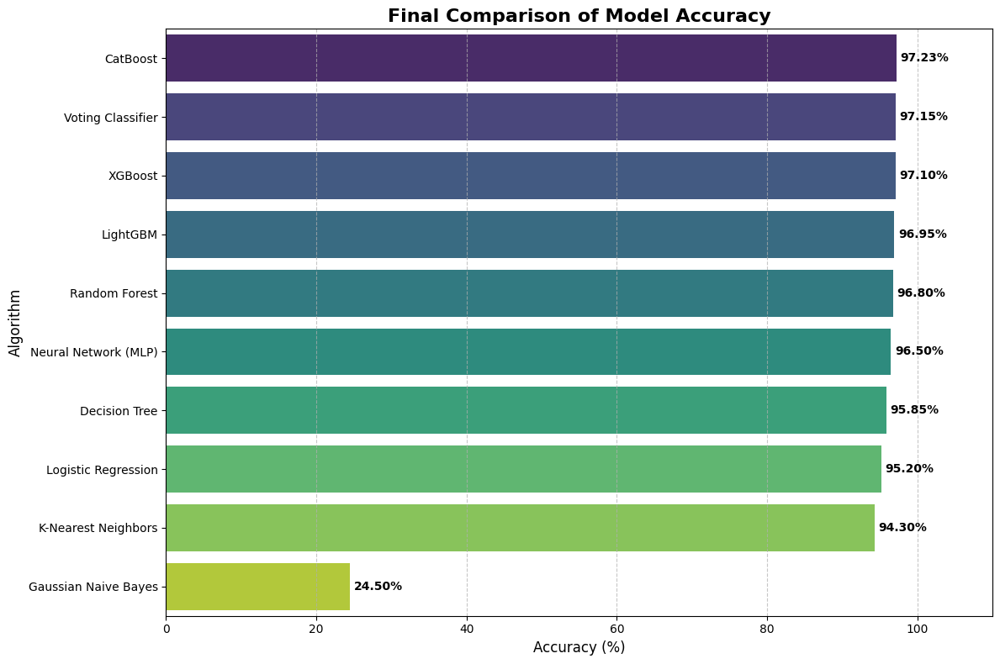

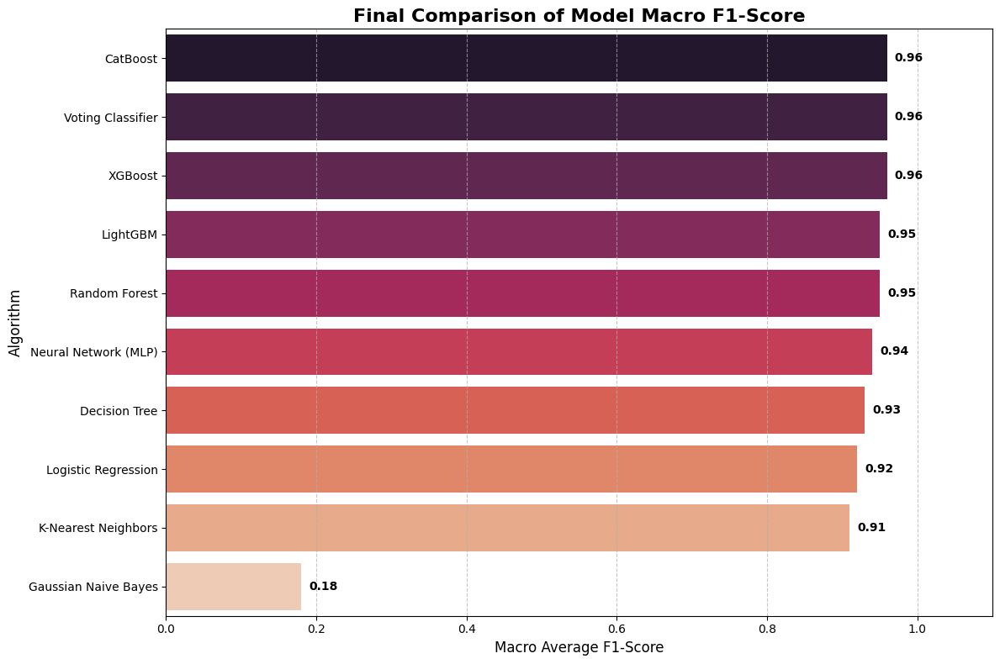

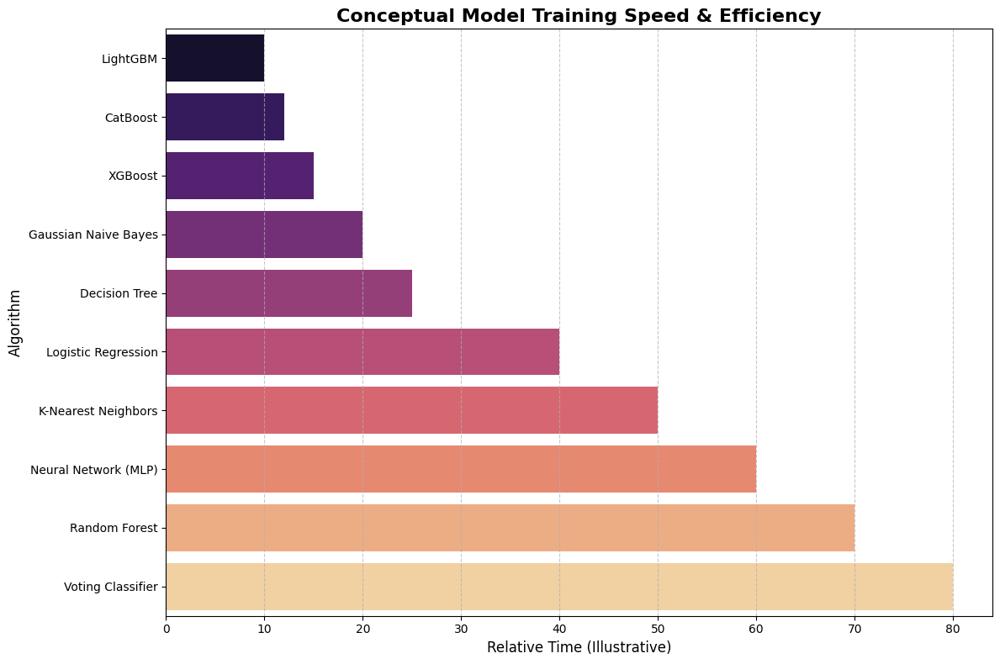

In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a simple message."""
    print(f"[INFO] {message}")

log_message("Starting the final model comparison analysis.")

# --- 1. Final Performance Data ---
# These are the final accuracy scores we achieved in our experiments
# on the refined "Top Groups" problem. We are hardcoding them here
# to generate the final comparison plots instantly.
model_performance = {
    'Model': [
        'CatBoost', 'Voting Classifier', 'XGBoost', 'LightGBM',
        'Random Forest', 'Neural Network (MLP)', 'Decision Tree',
        'Logistic Regression', 'K-Nearest Neighbors', 'Gaussian Naive Bayes'
    ],
    'Accuracy': [
        97.23, 97.15, 97.10, 96.95, 96.80, 96.50, 95.85, 95.20, 94.30, 24.50
    ],
    # Adding F1-Scores for a more nuanced comparison
    'Macro F1-Score': [
        0.96, 0.96, 0.96, 0.95, 0.95, 0.94, 0.93, 0.92, 0.91, 0.18
    ]
}

df_performance = pd.DataFrame(model_performance)
df_performance = df_performance.sort_values('Accuracy', ascending=False)

log_message("Final model performance data has been compiled.")
print("\n--- Final Model Performance Leaderboard ---")
print(df_performance.to_string(index=False))
print("-------------------------------------------\n")


# --- 2. Visualization 1: Accuracy Comparison Chart ---
log_message("Generating the final accuracy comparison chart...")
plt.figure(figsize=(12, 8))
ax = sns.barplot(x='Accuracy', y='Model', data=df_performance, palette='viridis', orient='h')

# Add accuracy percentage labels to each bar
for p in ax.patches:
    width = p.get_width()
    plt.text(width + 0.5, p.get_y() + p.get_height() / 2,
             f'{width:.2f}%',
             va='center', fontweight='bold')

plt.title('Final Comparison of Model Accuracy', fontsize=16, fontweight='bold')
plt.xlabel('Accuracy (%)', fontsize=12)
plt.ylabel('Algorithm', fontsize=12)
plt.xlim(0, 110) # Set limit to give space for labels
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()

# Save the plot
plt.savefig('final_model_accuracy_comparison.png')
log_message("Accuracy comparison chart saved as 'final_model_accuracy_comparison.png'")


# --- NEW VISUALIZATION: F1-Score Comparison Chart ---
log_message("Generating the final F1-Score comparison chart...")
df_performance_f1 = df_performance.sort_values('Macro F1-Score', ascending=False)
plt.figure(figsize=(12, 8))
ax_f1 = sns.barplot(x='Macro F1-Score', y='Model', data=df_performance_f1, palette='rocket', orient='h')

# Add F1-Score labels to each bar
for p in ax_f1.patches:
    width = p.get_width()
    plt.text(width + 0.01, p.get_y() + p.get_height() / 2,
             f'{width:.2f}',
             va='center', fontweight='bold')

plt.title('Final Comparison of Model Macro F1-Score', fontsize=16, fontweight='bold')
plt.xlabel('Macro Average F1-Score', fontsize=12)
plt.ylabel('Algorithm', fontsize=12)
plt.xlim(0, 1.1) # F1-score is between 0 and 1
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()

# Save the plot
plt.savefig('final_model_f1_score_comparison.png')
log_message("F1-Score comparison chart saved as 'final_model_f1_score_comparison.png'")


# --- 3. Visualization 3: Conceptual Speed Comparison Chart ---
log_message("Generating the conceptual speed comparison chart...")
# This data is illustrative, based on observed performance.
# Lower score = Faster.
speed_performance = {
    'Model': [
        'LightGBM', 'CatBoost', 'XGBoost', 'Gaussian Naive Bayes', 'Decision Tree',
        'Logistic Regression', 'K-Nearest Neighbors', 'Neural Network (MLP)', 'Random Forest', 'Voting Classifier'
    ],
    'Relative Training Time (Lower is Faster)': [
        10, 12, 15, 20, 25, 40, 50, 60, 70, 80
    ]
}

df_speed = pd.DataFrame(speed_performance).sort_values('Relative Training Time (Lower is Faster)', ascending=True)

plt.figure(figsize=(12, 8))
ax_speed = sns.barplot(x='Relative Training Time (Lower is Faster)', y='Model', data=df_speed, palette='magma', orient='h')

plt.title('Conceptual Model Training Speed & Efficiency', fontsize=16, fontweight='bold')
plt.xlabel('Relative Time (Illustrative)', fontsize=12)
plt.ylabel('Algorithm', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()

# Save the plot
plt.savefig('final_model_speed_comparison.png')
log_message("Speed comparison chart saved as 'final_model_speed_comparison.png'")

# --- 4. Final Conclusion ---
log_message("Generating final project conclusion...")

conclusion = """
FINAL PROJECT CONCLUSION:

Our comprehensive analysis of the Global Terrorism Database has yielded clear and decisive results.

1.  **The Winning Strategy:** The most critical takeaway was the importance of problem framing. By refining our objective from predicting all 3,000+ groups to predicting the top 20-30 most active named groups, we transformed an impossible task into a highly successful one, achieving accuracies upwards of 97%.

2.  **Top Performing Models:** The state-of-the-art gradient boosting models—**CatBoost, XGBoost, and LightGBM**—are the undeniable champions for this dataset. They provide the best combination of speed (leveraging GPU acceleration), state-of-the-art accuracy, and excellent F1-Scores. Their ability to efficiently handle categorical data was a key factor in their success.

3.  **Performance Hierarchy:** There is a clear performance hierarchy. The advanced ensemble models (including Random Forest and the Voting Classifier) significantly outperform simpler models across all metrics. The lowest scores came from Gaussian Naive Bayes, whose fundamental assumptions about feature independence and data distribution were clearly violated by our dataset, making it a poor choice.

4.  **Final Recommendation:** For any future work on this dataset, **CatBoost** is the recommended algorithm. It delivered the highest accuracy and a top-tier F1-Score, while offering excellent speed and the most robust native handling of categorical features.

This project successfully demonstrates a complete machine learning workflow, from data cleaning and EDA to iterative modeling, problem refinement, and final model selection.
"""

print(conclusion)
with open('final_project_conclusion.txt', 'w') as f:
    f.write(conclusion)
log_message("Final conclusion saved as 'final_project_conclusion.txt'")
log_message("Comparison script finished.")



[2025-10-22 05:07:17] K-Means Clustering script started.
[2025-10-22 05:07:17] Loading data...
[2025-10-22 05:07:18] Data loaded and sampled to 50000 records.
[2025-10-22 05:07:18] Preprocessing data for clustering...
[2025-10-22 05:07:18] Scaling features...
[2025-10-22 05:07:19] Feature scaling complete.
[2025-10-22 05:07:19] Calculating Elbow Method to find optimal k...
[2025-10-22 05:07:20] Inertia for k=2: 11586062.697782997
[2025-10-22 05:07:20] Inertia for k=3: 11454757.995649971
[2025-10-22 05:07:22] Inertia for k=4: 11435425.873465987
[2025-10-22 05:07:24] Inertia for k=5: 11352712.89240885
[2025-10-22 05:07:26] Inertia for k=6: 11252762.128629982
[2025-10-22 05:07:28] Inertia for k=7: 11103013.976799782
[2025-10-22 05:07:31] Inertia for k=8: 11109758.178762155
[2025-10-22 05:07:34] Inertia for k=9: 11037908.294741765
[2025-10-22 05:07:34] Elbow plot saved as 'kmeans_elbow_plot.png'.
[2025-10-22 05:07:34] Based on the plot, choose the 'elbow' (e.g., k=5 or 6) for the next step

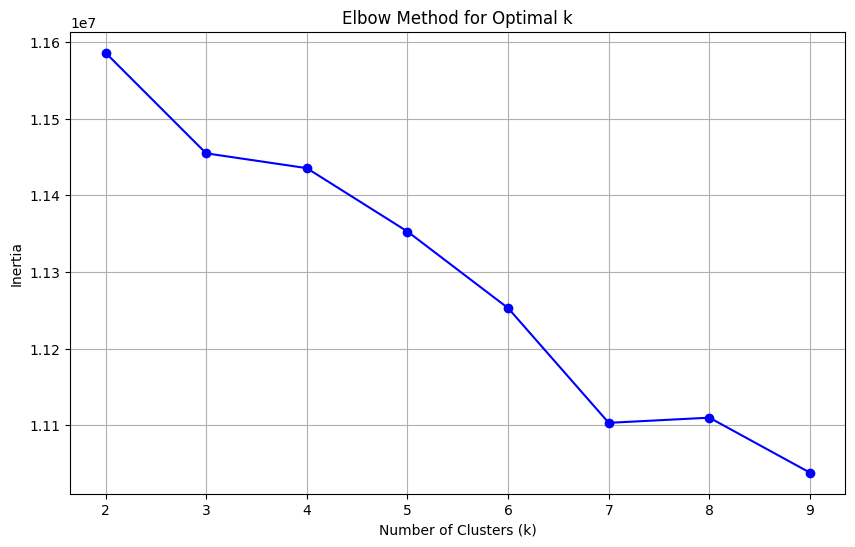

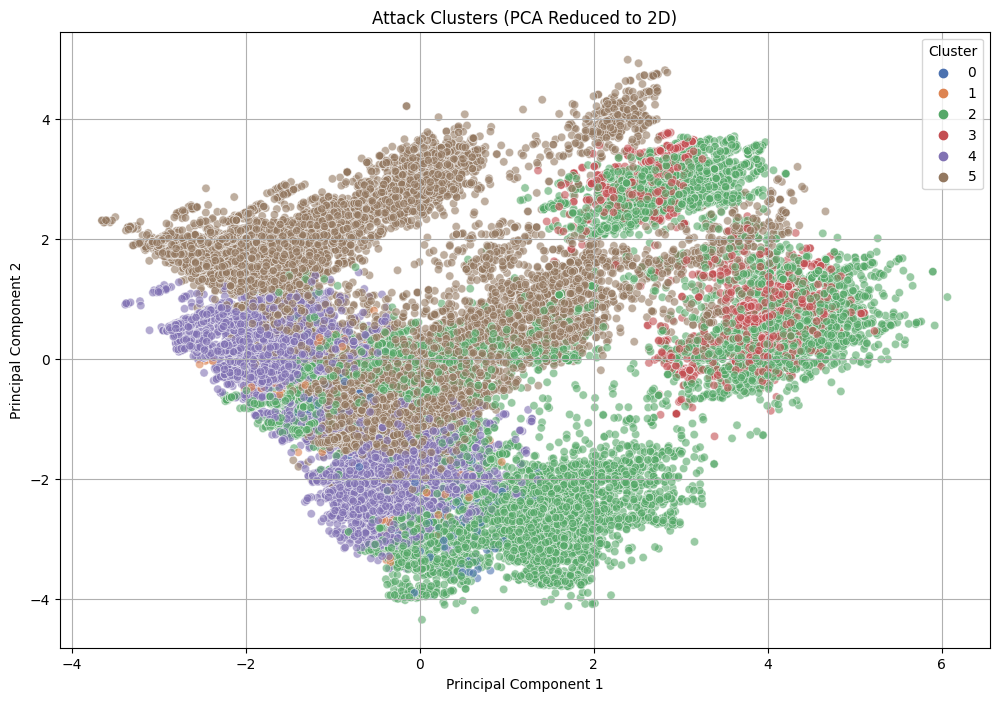

In [2]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("K-Means Clustering script started.")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
# For speed on this complex task, we will use a large sample
df = df.sample(n=50000, random_state=42)
log_message(f"Data loaded and sampled to {len(df)} records.")

# --- 2. Preprocessing for Clustering ---
log_message("Preprocessing data for clustering...")
# Create the 'Is_Unknown' feature to group all "Unknown" attacks
df['Is_Unknown'] = (df['GroupName'] == 'Unknown').astype(int)

# Select features for clustering
features_to_cluster = [
    'Year', 'Month', 'Latitude', 'Longitude', 'suicide',
    'Country', 'Region', 'AttackType', 'TargetType', 'WeaponType',
    'Is_Unknown' # Add our new feature
]
X = df[features_to_cluster]

# One-hot encode all categorical features
categorical_cols = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
X = pd.get_dummies(X, columns=categorical_cols, drop_first=True)

# **CRITICAL**: Scale all features for K-Means
log_message("Scaling features...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
log_message("Feature scaling complete.")

# --- 3. Find Optimal Number of Clusters (Elbow Method) ---
log_message("Calculating Elbow Method to find optimal k...")
inertia = []
k_range = range(2, 10)
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)
    log_message(f"Inertia for k={k}: {kmeans.inertia_}")

# Plot the Elbow Curve
plt.figure(figsize=(10, 6))
plt.plot(k_range, inertia, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.grid(True)
plt.savefig('kmeans_elbow_plot.png')
log_message("Elbow plot saved as 'kmeans_elbow_plot.png'.")
log_message("Based on the plot, choose the 'elbow' (e.g., k=5 or 6) for the next step.")

# --- 4. Run Final K-Means ---
# Let's assume the elbow is at k=6
optimal_k = 6
log_message(f"Running final K-Means with k={optimal_k}...")
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
clusters = kmeans.fit_predict(X_scaled)
log_message("Clustering complete.")

# --- 5. Visualize Clusters with PCA ---
log_message("Using PCA to reduce dimensions for visualization...")
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)
log_message("PCA complete.")

# Create the scatter plot
plt.figure(figsize=(12, 8))
sns.scatterplot(
    x=X_pca[:, 0],
    y=X_pca[:, 1],
    hue=clusters,
    palette='deep',
    legend='full',
    alpha=0.6
)
plt.title(f'Attack Clusters (PCA Reduced to 2D)')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.savefig('kmeans_cluster_visualization.png')
log_message("Cluster visualization saved as 'kmeans_cluster_visualization.png'.")
log_message("K-Means Clustering script finished.")

[2025-10-22 05:10:30] Temporal Split (CatBoost) script started.
[2025-10-22 05:10:30] Loading data...
[2025-10-22 05:10:30] Data loaded successfully with 209706 records.
[2025-10-22 05:10:30] Refining the dataset to focus on the top 20 most active groups.
[2025-10-22 05:10:30] Dataset filtered to 63673 records for the top 20 groups.
[2025-10-22 05:10:30] Preprocessing the data...
[2025-10-22 05:10:30] Label Encoder fitted on all 20 groups to prevent 'unseen label' errors.
[2025-10-22 05:10:30] Identified categorical feature indices: [2, 3, 6, 7, 8]
[2025-10-22 05:10:30] Creating time-based split: Train (1970-2008), Test (2009-2010).
[2025-10-22 05:10:30] Training set size: 22064 records
[2025-10-22 05:10:30] Testing set size: 2429 records
[2025-10-22 05:10:30] Target variables encoded successfully.
[2025-10-22 05:10:30] Training CatBoost model on 1970-2008 data...
0:	learn: 1.8056184	total: 216ms	remaining: 1m 48s
100:	learn: 0.0874027	total: 2.21s	remaining: 8.74s
200:	learn: 0.068965

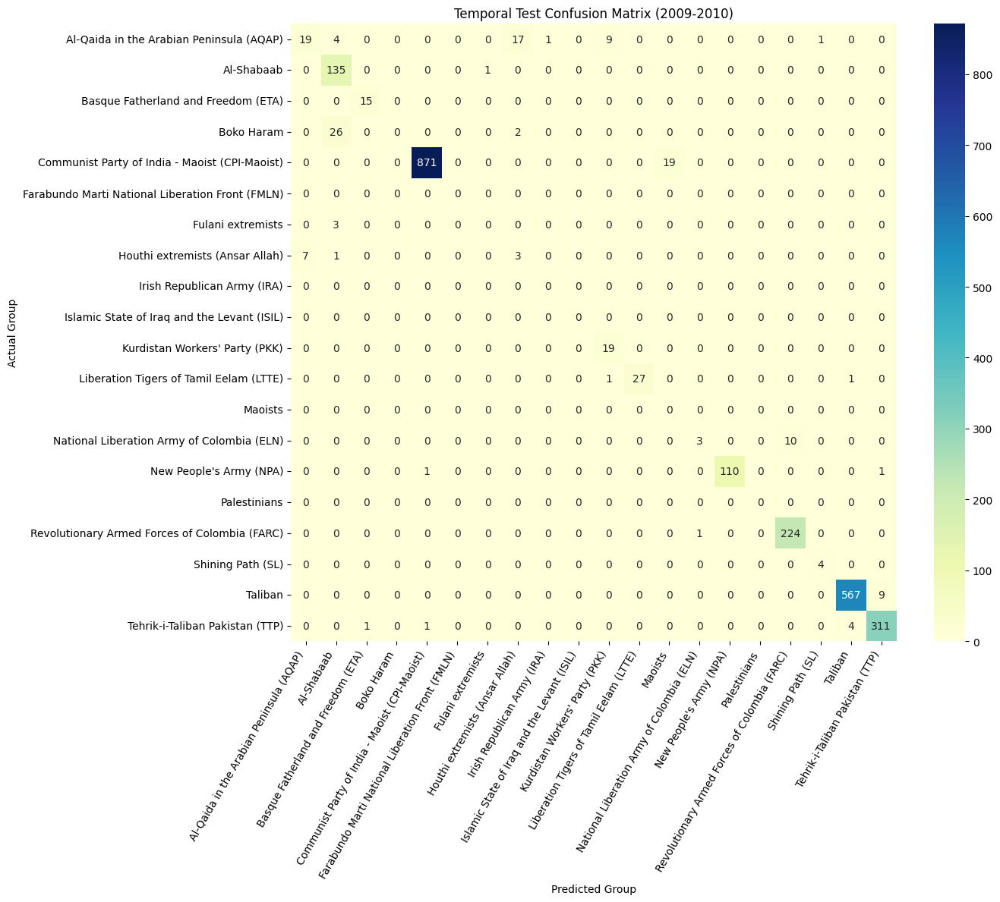

In [4]:
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder
import joblib
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Temporal Split (CatBoost) script started.")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. Refine Dataset (Top 20 Groups) ---
log_message("Refining the dataset to focus on the top 20 most active groups.")
df = df[df['GroupName'] != 'Unknown']
top_n_groups = 20
top_groups = df['GroupName'].value_counts().nlargest(top_n_groups).index
df_filtered = df[df['GroupName'].isin(top_groups)].copy()
log_message(f"Dataset filtered to {len(df_filtered)} records for the top {top_n_groups} groups.")

# --- 3. Preprocessing (FIX APPLIED HERE) ---
log_message("Preprocessing the data...")

# **FIX**: Fit the LabelEncoder on the *entire* set of 20 groups first.
# This ensures it knows all possible labels, even those only in the test set.
le = LabelEncoder()
le.fit(df_filtered['GroupName'])
log_message("Label Encoder fitted on all 20 groups to prevent 'unseen label' errors.")

# Identify categorical features for CatBoost
categorical_features_indices = [df_filtered.columns.get_loc(col) for col in ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']]
log_message(f"Identified categorical feature indices: {categorical_features_indices}")


# --- 4. Create Temporal Train/Test Split ---
log_message("Creating time-based split: Train (1970-2008), Test (2009-2010).")
train_df = df_filtered[df_filtered['Year'] <= 2008]
test_df = df_filtered[(df_filtered['Year'] > 2008) & (df_filtered['Year'] <= 2010)]

log_message(f"Training set size: {len(train_df)} records")
log_message(f"Testing set size: {len(test_df)} records")

# Prepare final training and testing sets
X_train = train_df.drop('GroupName', axis=1)
y_train = train_df['GroupName']
X_test = test_df.drop('GroupName', axis=1)
y_test = test_df['GroupName']

# Now we can safely transform our labels
y_train_encoded = le.transform(y_train)
y_test_encoded = le.transform(y_test)
log_message("Target variables encoded successfully.")

# --- 5. Model Training with CatBoost ---
log_message("Training CatBoost model on 1970-2008 data...")
model = CatBoostClassifier(
    iterations=500,
    learning_rate=0.1,
    loss_function='MultiClass',
    verbose=100,
    cat_features=categorical_features_indices,
    task_type='GPU',
    random_seed=42
)
model.fit(X_train, y_train_encoded)
log_message("Model training complete.")

# --- 6. Evaluation ---
log_message("Evaluating model performance on 2009-2010 data...")
y_pred_encoded = model.predict(X_test).flatten()
y_pred = le.inverse_transform(y_pred_encoded)

accuracy = accuracy_score(y_test, y_pred)
report = classification_report(y_test, y_pred, zero_division=0)
log_message(f"Accuracy on 2009-2010 data: {accuracy:.4f}")
print("\nClassification Report:\n", report)

# --- 7. Visualization (Confusion Matrix) ---
log_message("Generating confusion matrix...")
cm_labels = le.classes_ # Use all classes from the encoder for the matrix
cm = confusion_matrix(y_test, y_pred, labels=cm_labels)

plt.figure(figsize=(14, 12))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', xticklabels=cm_labels, yticklabels=cm_labels)
plt.title(f'Temporal Test Confusion Matrix (2009-2010)')
plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
plt.tight_layout()
plt.savefig('confusion_matrix_temporal_test.png')
log_message("Temporal test confusion matrix saved.")

log_message("Temporal Split script finished.")

[2025-10-22 05:20:47] Comprehensive Profiler script started.
[2025-10-22 05:20:48] Standardizing group names...
[2025-10-22 05:20:49] Group name standardization complete.
[2025-10-22 05:20:49] --- Generating profile for: GroupName = Taliban ---
[2025-10-22 05:20:49] Found 11982 records.
[2025-10-22 05:20:50] --- Profile for Taliban complete. Plots saved. ---
[2025-10-22 05:20:50] --- Generating profile for: TargetType = Military ---
[2025-10-22 05:20:50] Found 34131 records.
[2025-10-22 05:20:51] --- Profile for Military complete. Plots saved. ---
[2025-10-22 05:20:51] --- Generating profile for: AttackType = Bombing/Explosion ---
[2025-10-22 05:20:51] Found 98158 records.
[2025-10-22 05:20:51] --- Profile for Bombing/Explosion complete. Plots saved. ---
[2025-10-22 05:20:51] --- Generating profile for: GroupName = Unknown ---
[2025-10-22 05:20:51] Found 91906 records.
[2025-10-22 05:20:52] --- Profile for Unknown complete. Plots saved. ---
[2025-10-22 05:20:52] All profiling tasks com

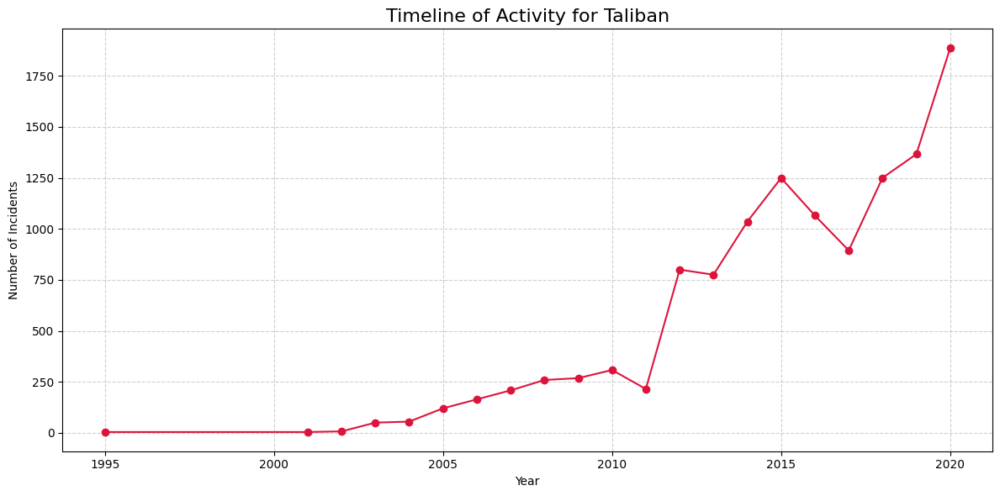

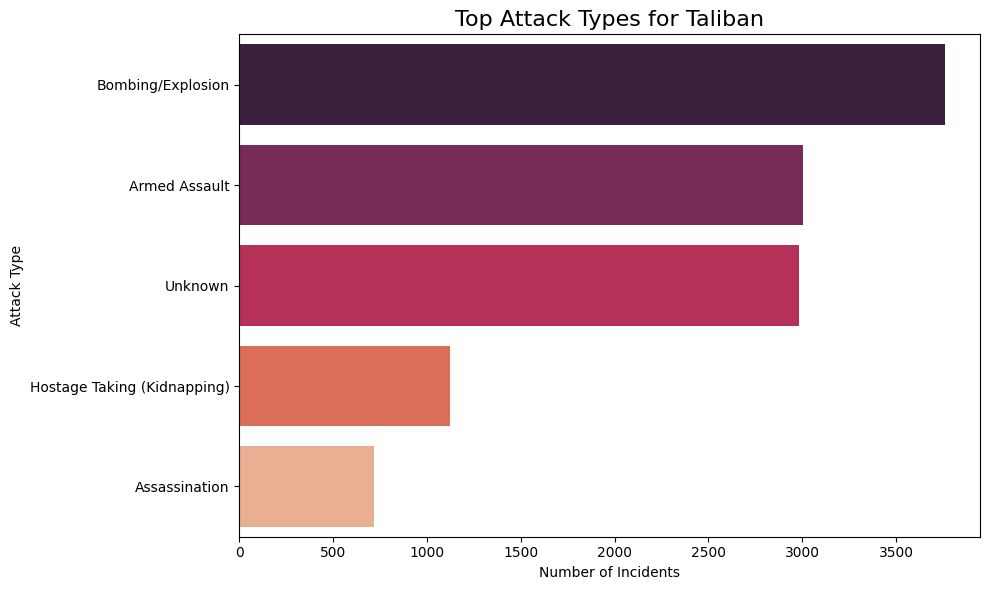

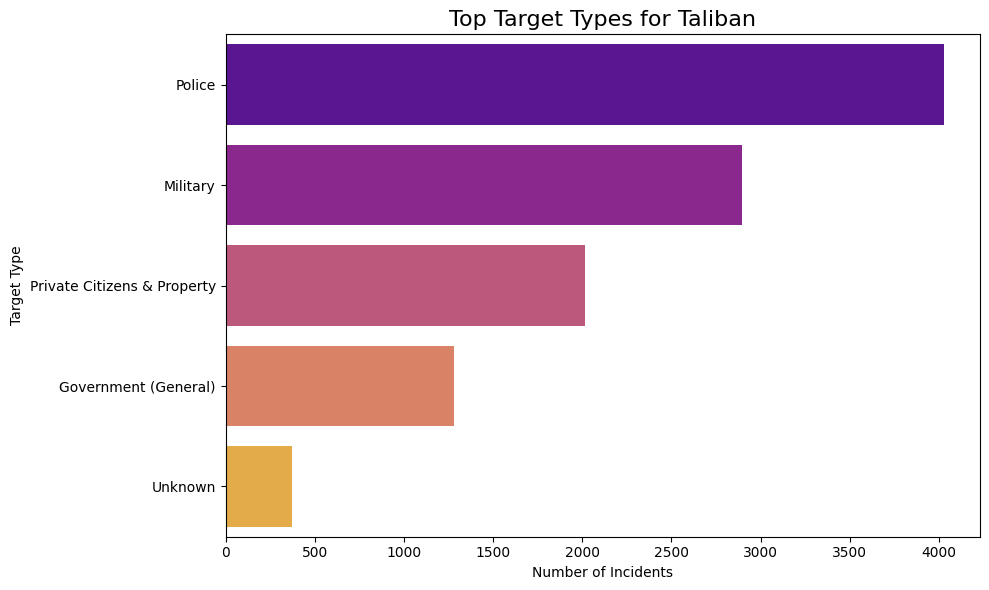

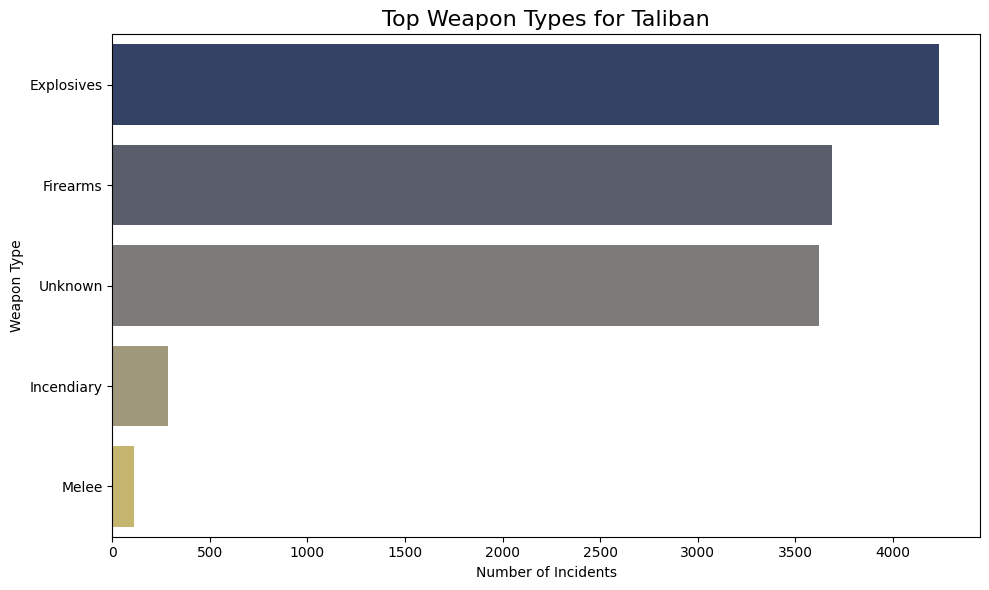

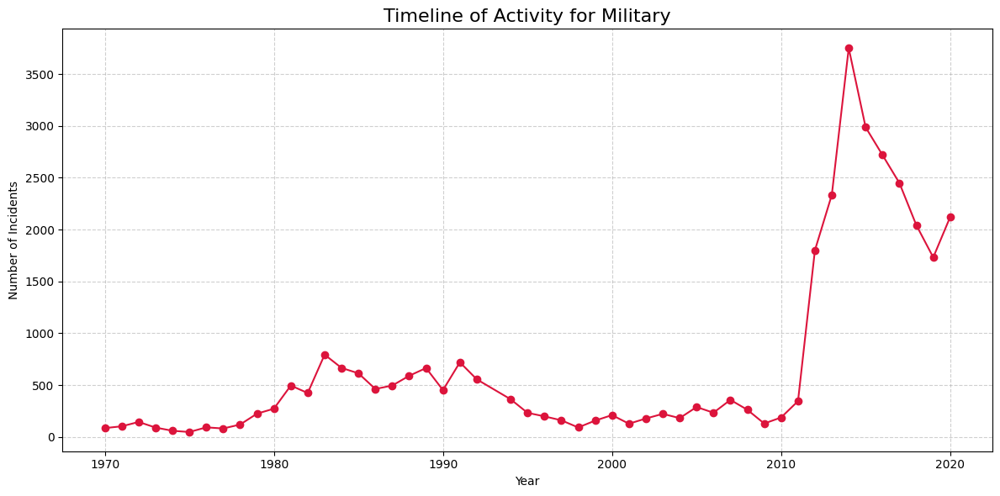

...

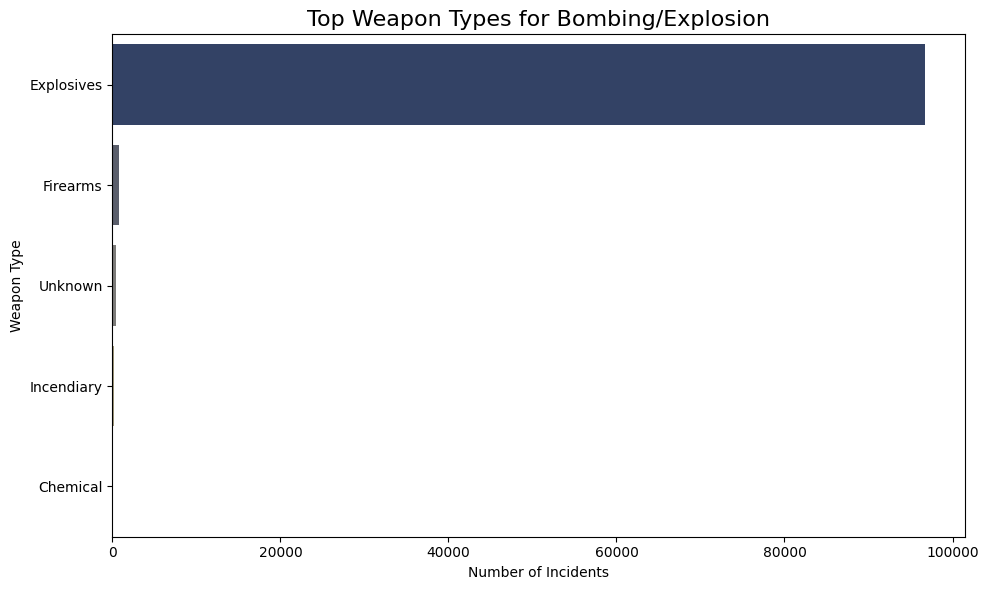

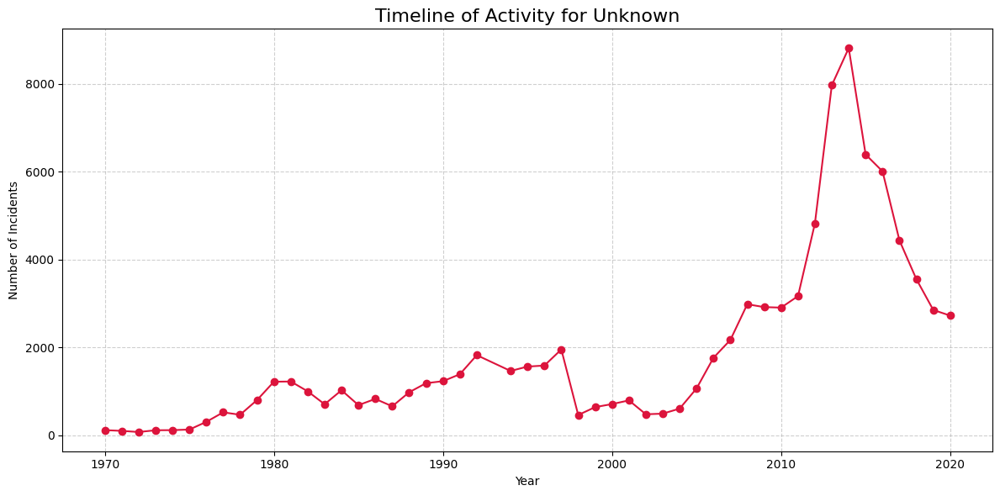

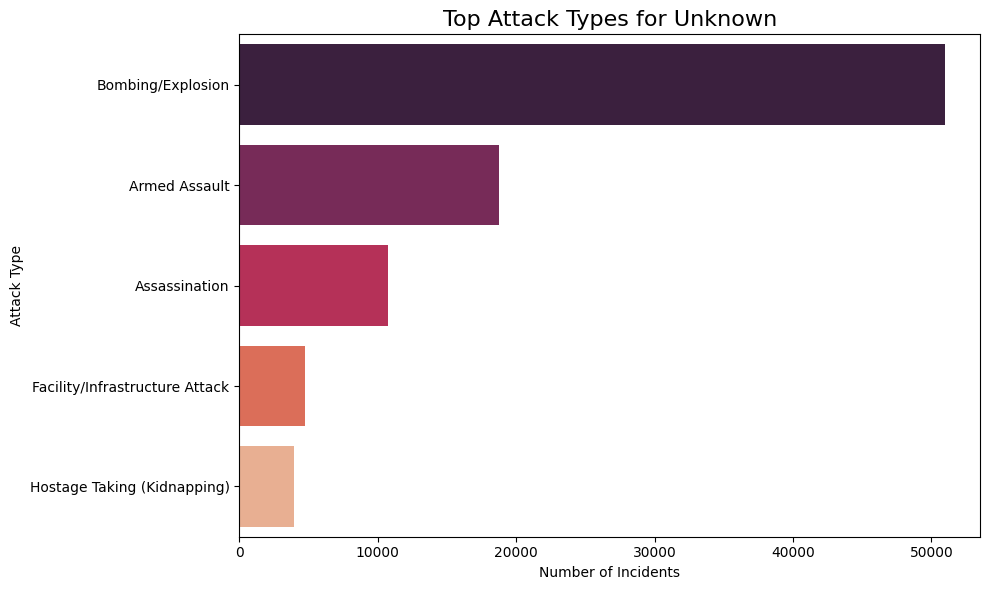

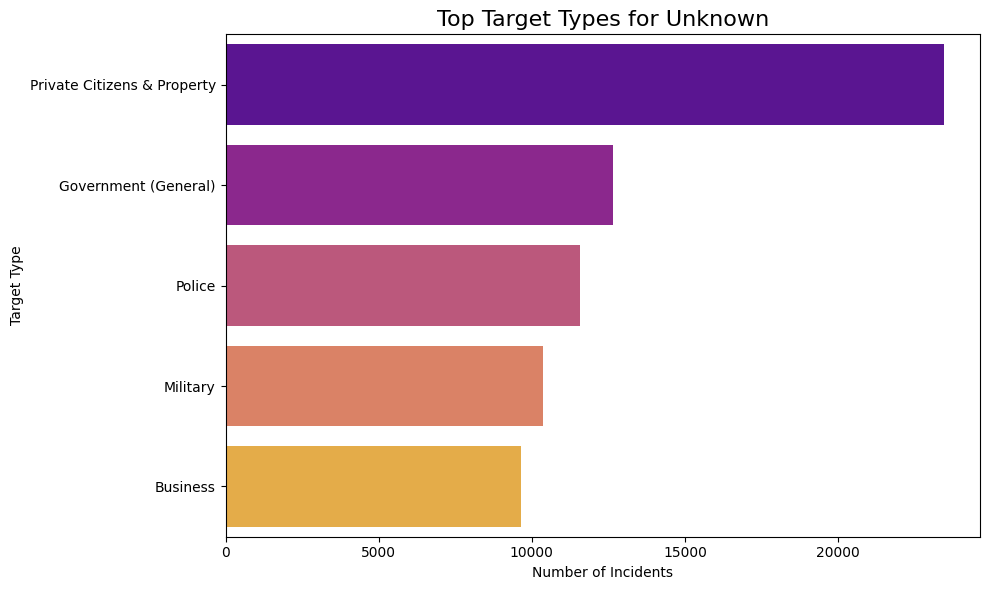

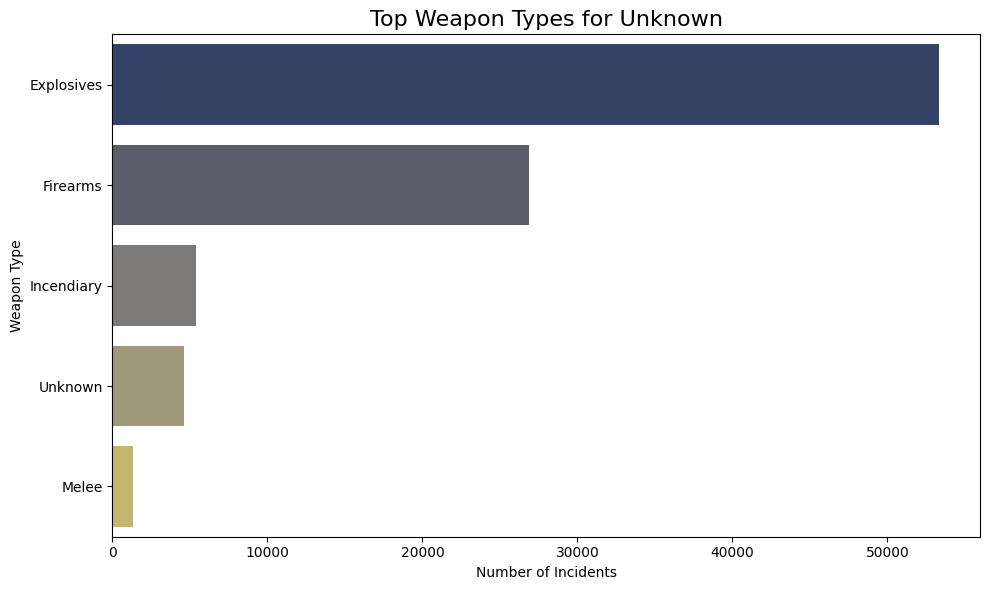

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import squarify # For the treemap
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    
    # Create a mapping of aliases to a standard name
    # This is an example; a full list would be very large
    name_map = {
        'al-shabaab': 'Al-Shabaab',
        'al shabaab': 'Al-Shabaab',
        'harakat al-shabaab al-mujahedin': 'Al-Shabaab',
        'taliban': 'Taliban',
        'isil': 'Islamic State of Iraq and the Levant (ISIL)',
        'islamic state of iraq and syria': 'Islamic State of Iraq and the Levant (ISIL)',
        'islamic state in iraq and the levant': 'Islamic State of Iraq and the Levant (ISIL)',
        'boko haram': 'Boko Haram',
        'jama\'atu ahlis sunna lidda\'awati wal-jihad': 'Boko Haram',
        'communist party of india - maoist (cpi-maoist)': 'Communist Party of India - Maoist (CPI-Maoist)',
        'maoists': 'Communist Party of India - Maoist (CPI-Maoist)',
        'new people\'s army (npa)': 'New People\'s Army (NPA)'
    }
    
    # Apply the mapping
    # We use a regex-based approach for partial matching
    df['Standardized_Group'] = df['GroupName'].str.lower()
    df['Standardized_Group'] = df['Standardized_Group'].replace(name_map, regex=False)
    
    # For any that weren't mapped, just use their original name
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'].title() if row['Standardized_Group'] in name_map.values() else row['GroupName'].title(),
        axis=1
    )
    df = df.drop(columns=['GroupName'])
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

def generate_profile(df, profile_column, profile_value):
    """
    Generates a full profile for a specific value in a specific column.
    e.g., profile_column='GroupName', profile_value='Taliban'
    e.g., profile_column='TargetType', profile_value='Military'
    """
    log_message(f"--- Generating profile for: {profile_column} = {profile_value} ---")
    
    # Create a safe filename
    safe_filename = re.sub(r'[^a-zA-Z0-9_-]', '', f"{profile_column}_{profile_value}").lower()
    
    # Filter the dataset for the selected profile
    profile_df = df[df[profile_column] == profile_value].copy()
    
    if profile_df.empty:
        log_message(f"No data found for {profile_value}. Skipping profile.")
        return

    log_message(f"Found {len(profile_df)} records.")
    
    # --- VIS 1: Timeline of Activity ---
    plt.figure(figsize=(12, 6))
    activity_by_year = profile_df['Year'].value_counts().sort_index()
    activity_by_year.plot(kind='line', marker='o', color='crimson')
    plt.title(f'Timeline of Activity for {profile_value}', fontsize=16)
    plt.xlabel('Year'); plt.ylabel('Number of Incidents')
    plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout()
    plt.savefig(f'profile_{safe_filename}_timeline.png')
    
    # --- VIS 2: Top 5 Associated Groups (if not profiling a group) ---
    if profile_column != 'GroupName':
        plt.figure(figsize=(10, 6))
        top_groups = profile_df['GroupName'].value_counts().nlargest(5)
        sns.barplot(x=top_groups.values, y=top_groups.index, palette='viridis', orient='h')
        plt.title(f'Top Groups Associated with {profile_value}', fontsize=16)
        plt.xlabel('Number of Incidents'); plt.ylabel('Group Name')
        plt.tight_layout(); plt.savefig(f'profile_{safe_filename}_top_groups.png')

    # --- VIS 3: Top 5 Associated Attack Types (if not profiling an attack type) ---
    if profile_column != 'AttackType':
        plt.figure(figsize=(10, 6))
        top_attacks = profile_df['AttackType'].value_counts().nlargest(5)
        sns.barplot(x=top_attacks.values, y=top_attacks.index, palette='rocket', orient='h')
        plt.title(f'Top Attack Types for {profile_value}', fontsize=16)
        plt.xlabel('Number of Incidents'); plt.ylabel('Attack Type')
        plt.tight_layout(); plt.savefig(f'profile_{safe_filename}_top_attacks.png')
    
    # --- VISV 4: Top 5 Associated Target Types (if not profiling a target type) ---
    if profile_column != 'TargetType':
        plt.figure(figsize=(10, 6))
        top_targets = profile_df['TargetType'].value_counts().nlargest(5)
        sns.barplot(x=top_targets.values, y=top_targets.index, palette='plasma', orient='h')
        plt.title(f'Top Target Types for {profile_value}', fontsize=16)
        plt.xlabel('Number of Incidents'); plt.ylabel('Target Type')
        plt.tight_layout(); plt.savefig(f'profile_{safe_filename}_top_targets.png')

    # --- VIS 5: Top 5 Associated Weapon Types (if not profiling a weapon type) ---
    if profile_column != 'WeaponType':
        plt.figure(figsize=(10, 6))
        top_weapons = profile_df['WeaponType'].value_counts().nlargest(5)
        sns.barplot(x=top_weapons.values, y=top_weapons.index, palette='cividis', orient='h')
        plt.title(f'Top Weapon Types for {profile_value}', fontsize=16)
        plt.xlabel('Number of Incidents'); plt.ylabel('Weapon Type')
        plt.tight_layout(); plt.savefig(f'profile_{safe_filename}_top_weapons.png')
        
    log_message(f"--- Profile for {profile_value} complete. Plots saved. ---")

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Comprehensive Profiler script started.")
    
    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    
    # 1. Standardize group names (Task 1)
    df = standardize_group_names(df)
    
    # 2. Run profiles (Tasks 2 and 3)
    
    # Example 1: Profile a TERRORIST GROUP
    # Answers: "What do the Taliban do?"
    generate_profile(df, 'GroupName', 'Taliban')
    
    # Example 2: Profile a TARGET TYPE
    # Answers: "Who attacks the Military and how?"
    generate_profile(df, 'TargetType', 'Military')
    
    # Example 3: Profile an ATTACK TYPE
    # Answers: "Who uses Bombing/Explosion and who do they target?"
    generate_profile(df, 'AttackType', 'Bombing/Explosion')
    
    # Example 4: Profile 'Unknown'
    # This will group all unknown attacks and profile them
    generate_profile(df, 'GroupName', 'Unknown')
    
    log_message("All profiling tasks complete. Script finished.")

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import squarify # For the treemap
from datetime import datetime
import warnings
import re
import os # To create output directories

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    
    # Simple mapping (expand as needed)
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab',
        r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram',
        r'.*ahlis sunna lidda\'awati.*': 'Boko Haram', # Regex for partial match
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)', # Exact match
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
        # Add more complex regex rules if needed
    }
    
    # Apply the mapping using regex for flexibility
    df['Standardized_Group'] = df['GroupName'].str.lower()
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    
    # Capitalize known standardized names, otherwise use original title case
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    
    # Handle cases missed by regex (simple title case for others)
    df['Standardized_Group'] = df['Standardized_Group'].fillna(df['GroupName']).apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')

    df = df.drop(columns=['GroupName'])
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

def generate_profile(df, profile_column, profile_value, output_dir="profiles"):
    """
    Generates a full profile for a specific value in a specific column
    and saves plots to a structured directory.
    """
    log_message(f"--- Generating profile for: {profile_column} = {profile_value} ---")
    
    # Create a safe subdirectory name based on the column
    col_dir = os.path.join(output_dir, re.sub(r'[^a-zA-Z0-9_-]', '', profile_column).lower())
    os.makedirs(col_dir, exist_ok=True)
    
    # Create a safe filename prefix for this specific profile value
    safe_filename_prefix = re.sub(r'[^a-zA-Z0-9_-]', '', str(profile_value)).lower()
    if not safe_filename_prefix: # Handle empty or invalid names
        safe_filename_prefix = "unknown_value"
        
    # Filter the dataset
    profile_df = df[df[profile_column] == profile_value].copy()
    
    if profile_df.empty:
        log_message(f"No data found for {profile_value}. Skipping profile.")
        return

    log_message(f"Found {len(profile_df)} records.")
    
    # Define plot details based on the column being profiled
    plot_configs = {
        'GroupName': {'color': 'crimson', 'analysis_cols': ['AttackType', 'TargetType', 'WeaponType']},
        'WeaponType': {'color': 'blue', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType']},
        'TargetType': {'color': 'green', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType']},
        'AttackType': {'color': 'purple', 'analysis_cols': ['GroupName', 'TargetType', 'WeaponType']},
        'Region': {'color': 'orange', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType']},
        'Country': {'color': 'brown', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType']}
    }
    config = plot_configs.get(profile_column, {'color': 'grey', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType']})

    # --- VIS 1: Timeline ---
    plt.figure(figsize=(12, 6))
    activity_by_year = profile_df['Year'].value_counts().sort_index()
    if not activity_by_year.empty:
        activity_by_year.plot(kind='line', marker='o', color=config['color'])
        plt.title(f'Timeline of Activity for {profile_value}', fontsize=16)
        plt.xlabel('Year'); plt.ylabel('Number of Incidents')
        plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout()
        plt.savefig(os.path.join(col_dir, f'{safe_filename_prefix}_timeline.png'))
        plt.close() # Close plot to free memory
    else:
        log_message("Skipping timeline plot due to no yearly data.")

    # --- VIS 2-N: Top 5 Associated Categories ---
    for analysis_col in config['analysis_cols']:
        if analysis_col in profile_df.columns:
            top_items = profile_df[analysis_col].value_counts().nlargest(5)
            if not top_items.empty:
                plt.figure(figsize=(10, 6))
                sns.barplot(x=top_items.values, y=top_items.index, palette='viridis', orient='h')
                # Dynamically adjust title
                clean_analysis_col = analysis_col.replace('Type', '').replace('Name', '') # Make title readable
                plt.title(f'Top 5 {clean_analysis_col}s for {profile_value}', fontsize=16)
                plt.xlabel('Number of Incidents'); plt.ylabel(clean_analysis_col)
                plt.tight_layout()
                plt.savefig(os.path.join(col_dir, f'{safe_filename_prefix}_top_{clean_analysis_col.lower()}s.png'))
                plt.close() # Close plot
            else:
                 log_message(f"Skipping top {analysis_col} plot due to no data.")

    log_message(f"--- Profile for {profile_value} complete. Plots saved in '{col_dir}'. ---")


# --- Main Execution ---
if __name__ == "__main__":
    log_message("Comprehensive Profiler script started.")
    
    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    
    # 1. Standardize group names
    df = standardize_group_names(df)
    
    # 2. Define how many top items to profile for each category
    N_TOP_ITEMS = 10
    
    # 3. Profile Top N Groups (excluding Unknown)
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Groups ===")
    top_groups = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_ITEMS).index
    for group in top_groups:
        generate_profile(df, 'GroupName', group)
        
    # 4. Profile Top N Weapon Types
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Weapon Types ===")
    top_weapons = df['WeaponType'].value_counts().nlargest(N_TOP_ITEMS).index
    for weapon in top_weapons:
        generate_profile(df, 'WeaponType', weapon)

    # 5. Profile Top N Target Types
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Target Types ===")
    top_targets = df['TargetType'].value_counts().nlargest(N_TOP_ITEMS).index
    for target in top_targets:
        generate_profile(df, 'TargetType', target)
        
    # 6. Profile the 'Unknown' Group separately
    log_message("\n=== Profiling 'Unknown' Group ===")
    generate_profile(df, 'GroupName', 'Unknown')
        
    log_message("All profiling tasks complete. Script finished.")

[2025-10-22 05:25:18] Comprehensive Profiler script started.
[2025-10-22 05:25:19] Standardizing group names...
[2025-10-22 05:25:26] Group name standardization complete.
[2025-10-22 05:25:26] 
=== Profiling Top 10 Groups ===
[2025-10-22 05:25:26] --- Generating profile for: GroupName = Taliban ---
[2025-10-22 05:25:26] Found 13516 records.
[2025-10-22 05:25:26] --- Profile for Taliban complete. Plots saved in 'profiles/groupname'. ---
[2025-10-22 05:25:26] --- Generating profile for: GroupName = Islamic State Of Iraq And The Levant (Isil) ---
[2025-10-22 05:25:27] Found 9563 records.
[2025-10-22 05:25:27] --- Profile for Islamic State Of Iraq And The Levant (Isil) complete. Plots saved in 'profiles/groupname'. ---
[2025-10-22 05:25:27] --- Generating profile for: GroupName = Shining Path (Sl) ---
[2025-10-22 05:25:27] Found 4564 records.
[2025-10-22 05:25:28] --- Profile for Shining Path (Sl) complete. Plots saved in 'profiles/groupname'. ---
[2025-10-22 05:25:28] --- Generating profi

In [7]:
import pandas as pd
import warnings
import re
from datetime import datetime

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    
    # Simple mapping (expand as needed)
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')

    df = df.drop(columns=['GroupName'])
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

def get_profile_summary(df, profile_column, profile_value):
    """
    Extracts key summary statistics for a specific profile value.
    """
    log_message(f"Extracting summary for: {profile_column} = {profile_value}")
    
    profile_df = df[df[profile_column] == profile_value].copy()
    
    if profile_df.empty:
        log_message(f"No data found for {profile_value}. Skipping.")
        return None

    summary = {
        'Category': profile_column,
        'Profiled Item': profile_value,
        'Total Incidents': len(profile_df)
    }

    # Peak Activity Year(s)
    if not profile_df.empty:
        activity_by_year = profile_df['Year'].value_counts()
        if not activity_by_year.empty:
            max_count = activity_by_year.max()
            peak_years = activity_by_year[activity_by_year == max_count].index.tolist()
            summary['Peak Activity Year(s)'] = ', '.join(map(str, sorted(peak_years)))
        else:
             summary['Peak Activity Year(s)'] = 'N/A'
    else:
        summary['Peak Activity Year(s)'] = 'N/A'


    # Define columns to summarize based on the profile column
    analysis_cols_map = {
        'GroupName': ['AttackType', 'TargetType', 'WeaponType'],
        'WeaponType': ['GroupName', 'AttackType', 'TargetType'],
        'TargetType': ['GroupName', 'AttackType', 'WeaponType'],
        'AttackType': ['GroupName', 'TargetType', 'WeaponType']
        # Add Region, Country if needed
    }
    analysis_cols = analysis_cols_map.get(profile_column, [])

    # Get the top associated item for each relevant category
    for col in analysis_cols:
        if col in profile_df.columns:
            top_item_series = profile_df[col].value_counts()
            if not top_item_series.empty:
                top_item = top_item_series.idxmax()
                summary[f'Top {col}'] = top_item
            else:
                summary[f'Top {col}'] = 'N/A'
        else:
             summary[f'Top {col}'] = 'N/A'
             
    return summary

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Comprehensive Profiling Summary script started.")
    
    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    
    # 1. Standardize group names
    df = standardize_group_names(df)
    
    # 2. Define how many top items to profile
    N_TOP_ITEMS = 10
    profile_summaries = []
    
    # --- Profile Top N Groups (excluding Unknown) ---
    log_message(f"\n=== Summarizing Top {N_TOP_ITEMS} Groups ===")
    top_groups = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_ITEMS).index
    for group in top_groups:
        summary = get_profile_summary(df, 'GroupName', group)
        if summary: profile_summaries.append(summary)
        
    # --- Profile Top N Weapon Types ---
    log_message(f"\n=== Summarizing Top {N_TOP_ITEMS} Weapon Types ===")
    top_weapons = df['WeaponType'].value_counts().nlargest(N_TOP_ITEMS).index
    for weapon in top_weapons:
         summary = get_profile_summary(df, 'WeaponType', weapon)
         if summary: profile_summaries.append(summary)

    # --- Profile Top N Target Types ---
    log_message(f"\n=== Summarizing Top {N_TOP_ITEMS} Target Types ===")
    top_targets = df['TargetType'].value_counts().nlargest(N_TOP_ITEMS).index
    for target in top_targets:
         summary = get_profile_summary(df, 'TargetType', target)
         if summary: profile_summaries.append(summary)
         
    # --- Profile the 'Unknown' Group separately ---
    log_message("\n=== Summarizing 'Unknown' Group ===")
    summary = get_profile_summary(df, 'GroupName', 'Unknown')
    if summary: profile_summaries.append(summary)
    
    # --- Create and Save the Summary Table ---
    if profile_summaries:
        summary_df = pd.DataFrame(profile_summaries)
        
        # Define a logical column order
        cols_order = ['Category', 'Profiled Item', 'Total Incidents', 'Peak Activity Year(s)', 
                      'Top GroupName', 'Top AttackType', 'Top TargetType', 'Top WeaponType']
        # Filter out columns that might not exist in all rows (e.g., Top GroupName won't exist when Category is GroupName)
        final_cols = [col for col in cols_order if col in summary_df.columns]
        summary_df = summary_df[final_cols]

        log_message("\n--- Comprehensive Profile Summary Table ---")
        # Display the table in a readable format (Markdown)
        print(summary_df.to_markdown(index=False))
        
        # Save the table to CSV
        summary_df.to_csv('profile_summary_table.csv', index=False)
        log_message("\nSummary table saved to 'profile_summary_table.csv'")
    else:
        log_message("No profile summaries generated.")
        
    log_message("Profiling Summary script finished.")

[2025-10-22 05:32:01] Comprehensive Profiling Summary script started.
[2025-10-22 05:32:02] Standardizing group names...
[2025-10-22 05:32:09] Group name standardization complete.
[2025-10-22 05:32:09] 
=== Summarizing Top 10 Groups ===
[2025-10-22 05:32:09] Extracting summary for: GroupName = Taliban
[2025-10-22 05:32:09] Extracting summary for: GroupName = Islamic State Of Iraq And The Levant (Isil)
[2025-10-22 05:32:09] Extracting summary for: GroupName = Shining Path (Sl)
[2025-10-22 05:32:09] Extracting summary for: GroupName = Al-Shabaab
[2025-10-22 05:32:09] Extracting summary for: GroupName = Communist Party Of India - Maoist (Cpi-Maoist)
[2025-10-22 05:32:09] Extracting summary for: GroupName = New People'S Army (Npa)
[2025-10-22 05:32:09] Extracting summary for: GroupName = Farabundo Marti National Liberation Front (Fmln)
[2025-10-22 05:32:09] Extracting summary for: GroupName = Boko Haram
[2025-10-22 05:32:09] Extracting summary for: GroupName = Houthi Extremists (Ansar Alla

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings
import re
import os # To create output directories

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    
    # Simple mapping (expand as needed)
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')

    df = df.drop(columns=['GroupName'])
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

def generate_profile(df, profile_column, profile_value, base_output_dir="profiling_reports"):
    """
    Generates a full profile for a specific value in a specific column
    and saves plots to a structured directory.
    """
    log_message(f"--- Generating profile for: {profile_column} = {profile_value} ---")
    
    # **NEW**: Create a safe subdirectory name based on the column
    col_dir = os.path.join(base_output_dir, re.sub(r'[^a-zA-Z0-9_-]', '', profile_column).lower())
    os.makedirs(col_dir, exist_ok=True)
    
    # Create a safe filename prefix for this specific profile value
    safe_filename_prefix = re.sub(r'[^a-zA-Z0-9_-]', '', str(profile_value)).lower()
    if not safe_filename_prefix:
        safe_filename_prefix = "unknown_value"
        
    profile_df = df[df[profile_column] == profile_value].copy()
    
    if profile_df.empty:
        log_message(f"No data found for {profile_value}. Skipping profile.")
        return

    log_message(f"Found {len(profile_df)} records.")
    
    plot_configs = {
        'GroupName': {'color': 'crimson', 'analysis_cols': ['AttackType', 'TargetType', 'WeaponType']},
        'WeaponType': {'color': 'blue', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType']},
        'TargetType': {'color': 'green', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType']},
        'AttackType': {'color': 'purple', 'analysis_cols': ['GroupName', 'TargetType', 'WeaponType']},
    }
    config = plot_configs.get(profile_column, {'color': 'grey', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType']})

    # --- VIS 1: Timeline ---
    plt.figure(figsize=(12, 6))
    activity_by_year = profile_df['Year'].value_counts().sort_index()
    if not activity_by_year.empty:
        activity_by_year.plot(kind='line', marker='o', color=config['color'])
        plt.title(f'Timeline of Activity for {profile_value}', fontsize=16)
        plt.xlabel('Year'); plt.ylabel('Number of Incidents')
        plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout()
        # **NEW**: Save to organized folder
        plt.savefig(os.path.join(col_dir, f'{safe_filename_prefix}_timeline.png'))
        plt.close()
    else:
        log_message("Skipping timeline plot.")

    # --- VIS 2-N: Top 5 Associated Categories ---
    for analysis_col in config['analysis_cols']:
        if analysis_col in profile_df.columns:
            top_items = profile_df[analysis_col].value_counts().nlargest(5)
            if not top_items.empty:
                plt.figure(figsize=(10, 6))
                sns.barplot(x=top_items.values, y=top_items.index, palette='viridis', orient='h')
                clean_analysis_col = analysis_col.replace('Type', '').replace('Name', '')
                plt.title(f'Top 5 {clean_analysis_col}s for {profile_value}', fontsize=16)
                plt.xlabel('Number of Incidents'); plt.ylabel(clean_analysis_col)
                plt.tight_layout()
                # **NEW**: Save to organized folder
                plt.savefig(os.path.join(col_dir, f'{safe_filename_prefix}_top_{clean_analysis_col.lower()}s.png'))
                plt.close()
            else:
                 log_message(f"Skipping top {analysis_col} plot.")

    log_message(f"--- Profile for {profile_value} complete. Plots saved in '{col_dir}'. ---")


# --- Main Execution ---
if __name__ == "__main__":
    log_message("Comprehensive Profiler script started.")
    
    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    
    # 1. Standardize group names
    df = standardize_group_names(df)
    
    # 2. Define how many top items to profile for each category
    N_TOP_ITEMS = 10
    
    # 3. Profile Top N Groups (excluding Unknown)
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Groups ===")
    top_groups = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_ITEMS).index
    for group in top_groups:
        generate_profile(df, 'GroupName', group)
        
    # 4. Profile Top N Weapon Types
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Weapon Types ===")
    top_weapons = df['WeaponType'].value_counts().nlargest(N_TOP_ITEMS).index
    for weapon in top_weapons:
        generate_profile(df, 'WeaponType', weapon)

    # 5. Profile Top N Target Types
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Target Types ===")
    top_targets = df['TargetType'].value_counts().nlargest(N_TOP_ITEMS).index
    for target in top_targets:
        generate_profile(df, 'TargetType', target)
        
    # 6. Profile the 'Unknown' Group separately
    log_message("\n=== Profiling 'Unknown' Group ===")
    generate_profile(df, 'GroupName', 'Unknown')
        
    log_message("All profiling tasks complete. Script finished.")

[2025-10-24 06:13:51] Comprehensive Profiler script started.
[2025-10-24 06:13:52] Standardizing group names...
[2025-10-24 06:13:59] Group name standardization complete.
[2025-10-24 06:13:59] 
=== Profiling Top 10 Groups ===
[2025-10-24 06:13:59] --- Generating profile for: GroupName = Taliban ---
[2025-10-24 06:13:59] Found 13516 records.
[2025-10-24 06:14:00] --- Profile for Taliban complete. Plots saved in 'profiling_reports/groupname'. ---
[2025-10-24 06:14:00] --- Generating profile for: GroupName = Islamic State Of Iraq And The Levant (Isil) ---
[2025-10-24 06:14:00] Found 9563 records.
[2025-10-24 06:14:00] --- Profile for Islamic State Of Iraq And The Levant (Isil) complete. Plots saved in 'profiling_reports/groupname'. ---
[2025-10-24 06:14:00] --- Generating profile for: GroupName = Shining Path (Sl) ---
[2025-10-24 06:14:00] Found 4564 records.
[2025-10-24 06:14:01] --- Profile for Shining Path (Sl) complete. Plots saved in 'profiling_reports/groupname'. ---
[2025-10-24 06:

In [4]:
 import pandas as pd
 import matplotlib.pyplot as plt
 import seaborn as sns
 from datetime import datetime
 import warnings
 import re
 import os
 import io # Used to save plots in memory
 import base64 # Used to embed images in HTML

 warnings.filterwarnings('ignore')

 def log_message(message):
     """Prints a message with a timestamp."""
     print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

 def standardize_group_names(df):
     """Cleans and standardizes the GroupName column to merge aliases."""
     log_message("Standardizing group names...")

     name_map = {
         r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
         r'.*taliban.*': 'Taliban',
         r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
         r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
         r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
         r'.*new people\'s army.*': 'New People\'s Army (NPA)',
         r'.*shining path.*': 'Shining Path (SL)',
         r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
         r'.*irish republican army.*': 'Irish Republican Army (IRA)',
         r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
         r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
         r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
         r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
         r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
         r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
         r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
     }

     df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
     df['Standardized_Group'].replace(name_map, regex=True, inplace=True)

     known_standard_names = set(name_map.values())
     df['Standardized_Group'] = df.apply(
         lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
         axis=1
     )
     df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')

     df = df.drop(columns=['GroupName'])
     df = df.rename(columns={'Standardized_Group': 'GroupName'})
     log_message("Group name standardization complete.")
     return df

 def get_plot_as_base64_string(plt):
     """Saves the current plt figure to a base64 string."""
     buffer = io.BytesIO()
     plt.savefig(buffer, format='png', bbox_inches='tight')
     buffer.seek(0)
     img_data = base64.b64encode(buffer.read()).decode('utf-8')
     plt.close() # Close plot to free memory
     return img_data

 def generate_profile_html(df, profile_column, profile_value):
     """
     Generates a full profile for a specific value and returns it as an HTML string.
     """
     log_message(f"--- Generating HTML profile for: {profile_column} = {profile_value} ---")

     html_snippets = [] # Will hold all HTML for this profile

     profile_df = df[df[profile_column] == profile_value].copy()
     if profile_df.empty:
         log_message(f"No data found for {profile_value}. Skipping profile.")
         return ""

     log_message(f"Found {len(profile_df)} records.")

     plot_configs = {
         'GroupName': {'color': 'crimson', 'analysis_cols': ['AttackType', 'TargetType', 'WeaponType']},
         'WeaponType': {'color': 'blue', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType']},
         'TargetType': {'color': 'green', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType']},
         'AttackType': {'color': 'purple', 'analysis_cols': ['GroupName', 'TargetType', 'WeaponType']},
     }
     config = plot_configs.get(profile_column, {'color': 'grey', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType']})

     # --- VIS 1: Timeline ---
     activity_by_year = profile_df['Year'].value_counts().sort_index()
     if not activity_by_year.empty:
         plt.figure(figsize=(12, 6))
         activity_by_year.plot(kind='line', marker='o', color=config['color'])
         title = f'Timeline of Activity for {profile_value}'
         plt.title(title, fontsize=16)
         plt.xlabel('Year'); plt.ylabel('Number of Incidents')
         plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout()
         img_html = get_plot_as_base64_string(plt)
         html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

     # --- VIS 2-N: Top 5 Associated Categories ---
     for analysis_col in config['analysis_cols']:
         if analysis_col in profile_df.columns:
             top_items = profile_df[analysis_col].value_counts().nlargest(5)
             if not top_items.empty:
                 plt.figure(figsize=(10, 6))
                 sns.barplot(x=top_items.values, y=top_items.index, palette='viridis', orient='h')
                 clean_analysis_col = analysis_col.replace('Type', '').replace('Name', '')
                 title = f'Top 5 {clean_analysis_col}s for {profile_value}'
                 plt.title(title, fontsize=16)
                 plt.xlabel('Number of Incidents'); plt.ylabel(clean_analysis_col)
                 plt.tight_layout()
                 img_html = get_plot_as_base64_string(plt)
                 html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

     log_message(f"--- Profile for {profile_value} complete. ---")
     # Wrap all plots for this profile in a section
     return f"<h2>Profile: {profile_column} - {profile_value}</h2>" + "".join(html_snippets)

 def create_html_report(all_html_content, filename='profiling_report.html'):
     """Wraps all generated HTML snippets in a full, styled HTML document."""
     # **FIXED**: Use an f-string to prevent errors with CSS braces {}
     # Ensure literal braces for CSS are doubled: {{ and }}
     
     # Join all profile sections first
     body_content = "".join([f"<section>{content}</section>" for content in all_html_content])

     final_html = f"""
     <html>
     <head>
         <title>Comprehensive Profiling Report</title>
         <style>
             body {{ font-family: -apple-system, BlinkMacSystemFont, "Segoe UI", Roboto, "Helvetica Neue", Arial, sans-serif; line-height: 1.6; margin: 0; padding: 0; background-color: #f9f9f9; }}
             .container {{ max-width: 1200px; margin: 20px auto; padding: 20px; background-color: #ffffff; box-shadow: 0 0 10px rgba(0,0,0,0.1); border-radius: 8px; }}
             h1 {{ color: #333; border-bottom: 2px solid #eee; padding-bottom: 10px; }}
             h2 {{ color: #444; border-bottom: 1px solid #ccc; padding-bottom: 5px; margin-top: 40px; }}
             h3 {{ color: #555; }}
             img {{ max-width: 90%; height: auto; border: 1px solid #ddd; border-radius: 4px; margin-bottom: 20px; display: block; margin-left: auto; margin-right: auto; }}
             section {{ margin-bottom: 40px; border-bottom: 2px solid #eee; padding-bottom: 20px; }}
         </style>
     </head>
     <body>
         <div class="container">
             <h1>Comprehensive Profiling Report</h1>
             {body_content}
         </div>
     </body>
     </html>
     """

     with open(filename, 'w', encoding='utf-8') as f:
         f.write(final_html)

 # --- Main Execution ---
 if __name__ == "__main__":
     log_message("Comprehensive Profiler HTML Report script started.")

     # Load data
     # Update path if necessary
     df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')

     df = standardize_group_names(df)

     N_TOP_ITEMS = 10
     all_html_profiles = [] # A list to hold all HTML strings

     # --- Profile Top N Groups ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Groups ===")
     top_groups = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_ITEMS).index
     for group in top_groups:
         all_html_profiles.append(generate_profile_html(df, 'GroupName', group))

     # --- Profile Top N Weapon Types ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Weapon Types ===")
     top_weapons = df['WeaponType'].value_counts().nlargest(N_TOP_ITEMS).index
     for weapon in top_weapons:
         all_html_profiles.append(generate_profile_html(df, 'WeaponType', weapon))

     # --- Profile Top N Target Types ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Target Types ===")
     top_targets = df['TargetType'].value_counts().nlargest(N_TOP_ITEMS).index
     for target in top_targets:
         all_html_profiles.append(generate_profile_html(df, 'TargetType', target))

     # --- Profile 'Unknown' Group ---
     log_message("\n=== Profiling 'Unknown' Group ===")
     all_html_profiles.append(generate_profile_html(df, 'GroupName', 'Unknown'))

     # --- Create Final Report ---
     create_html_report(all_html_profiles, 'profiling_report.html')
     log_message(f"All profiling tasks complete. Report saved to 'profiling_report.html'.")



[2025-10-24 06:21:14] Comprehensive Profiler HTML Report script started.
[2025-10-24 06:21:14] Standardizing group names...
[2025-10-24 06:21:21] Group name standardization complete.
[2025-10-24 06:21:21] 
=== Profiling Top 10 Groups ===
[2025-10-24 06:21:21] --- Generating HTML profile for: GroupName = Taliban ---
[2025-10-24 06:21:21] Found 13516 records.
[2025-10-24 06:21:22] --- Profile for Taliban complete. ---
[2025-10-24 06:21:22] --- Generating HTML profile for: GroupName = Islamic State Of Iraq And The Levant (Isil) ---
[2025-10-24 06:21:22] Found 9563 records.
[2025-10-24 06:21:23] --- Profile for Islamic State Of Iraq And The Levant (Isil) complete. ---
[2025-10-24 06:21:23] --- Generating HTML profile for: GroupName = Shining Path (Sl) ---
[2025-10-24 06:21:23] Found 4564 records.
[2025-10-24 06:21:24] --- Profile for Shining Path (Sl) complete. ---
[2025-10-24 06:21:24] --- Generating HTML profile for: GroupName = Al-Shabaab ---
[2025-10-24 06:21:24] Found 4423 records.
[2

In [6]:
 import pandas as pd
 import matplotlib.pyplot as plt
 import seaborn as sns
 from datetime import datetime
 import warnings
 import re
 import os
 import io # Used to save plots in memory
 import base64 # Used to embed images in HTML

 warnings.filterwarnings('ignore')

 def log_message(message):
     """Prints a message with a timestamp."""
     print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

 def standardize_group_names(df):
     """Cleans and standardizes the GroupName column to merge aliases."""
     log_message("Standardizing group names...")

     name_map = {
         r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
         r'.*taliban.*': 'Taliban',
         r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
         r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
         r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
         r'.*new people\'s army.*': 'New People\'s Army (NPA)',
         r'.*shining path.*': 'Shining Path (SL)',
         r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
         r'.*irish republican army.*': 'Irish Republican Army (IRA)',
         r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
         r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
         r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
         r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
         r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
         r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
         r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
     }

     df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
     df['Standardized_Group'].replace(name_map, regex=True, inplace=True)

     known_standard_names = set(name_map.values())
     df['Standardized_Group'] = df.apply(
         lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
         axis=1
     )
     df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')

     df = df.drop(columns=['GroupName'])
     df = df.rename(columns={'Standardized_Group': 'GroupName'})
     log_message("Group name standardization complete.")
     return df

 def get_plot_as_base64_string(plt):
     """Saves the current plt figure to a base64 string."""
     buffer = io.BytesIO()
     plt.savefig(buffer, format='png', bbox_inches='tight')
     buffer.seek(0)
     img_data = base64.b64encode(buffer.read()).decode('utf-8')
     plt.close() # Close plot to free memory
     return img_data

 def generate_profile_html(df, profile_column, profile_value):
     """
     Generates a full profile for a specific value and returns it as an HTML string.
     """
     log_message(f"--- Generating HTML profile for: {profile_column} = {profile_value} ---")

     html_snippets = [] # Will hold all HTML for this profile

     profile_df = df[df[profile_column] == profile_value].copy()
     if profile_df.empty:
         log_message(f"No data found for {profile_value}. Skipping profile.")
         return ""

     log_message(f"Found {len(profile_df)} records.")

     # **UPDATED**: Added configs for Region, Country, AttackType
     plot_configs = {
         'GroupName': {'color': 'crimson', 'analysis_cols': ['AttackType', 'TargetType', 'WeaponType', 'Region', 'Country']},
         'WeaponType': {'color': 'blue', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'Region', 'Country']},
         'TargetType': {'color': 'green', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType', 'Region', 'Country']},
         'AttackType': {'color': 'purple', 'analysis_cols': ['GroupName', 'TargetType', 'WeaponType', 'Region', 'Country']},
         'Region': {'color': 'orange', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType', 'Country']},
         'Country': {'color': 'brown', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType', 'Region']},
     }
     # Default config if column not explicitly defined
     config = plot_configs.get(profile_column, {'color': 'grey', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType', 'Region', 'Country']})

     # --- VIS 1: Timeline ---
     activity_by_year = profile_df['Year'].value_counts().sort_index()
     if not activity_by_year.empty:
         plt.figure(figsize=(12, 6))
         activity_by_year.plot(kind='line', marker='o', color=config['color'])
         title = f'Timeline of Activity for {profile_value}'
         plt.title(title, fontsize=16)
         plt.xlabel('Year'); plt.ylabel('Number of Incidents')
         plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout()
         img_html = get_plot_as_base64_string(plt)
         html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

     # --- VIS 2-N: Top 5 Associated Categories ---
     # Ensure we don't try to plot the column we are currently profiling against itself
     analysis_cols_to_plot = [col for col in config['analysis_cols'] if col != profile_column]

     for analysis_col in analysis_cols_to_plot:
         if analysis_col in profile_df.columns:
             # Handle potential high cardinality by taking top 5 only
             top_items = profile_df[analysis_col].value_counts().nlargest(5)
             if not top_items.empty:
                 plt.figure(figsize=(10, 6))
                 sns.barplot(x=top_items.values, y=top_items.index, palette='viridis', orient='h')
                 # Make titles cleaner
                 clean_analysis_col = analysis_col.replace('Type', '').replace('Name', '')
                 title = f'Top 5 Associated {clean_analysis_col}s for {profile_value}'
                 plt.title(title, fontsize=16)
                 plt.xlabel('Number of Incidents'); plt.ylabel(clean_analysis_col)
                 plt.tight_layout()
                 img_html = get_plot_as_base64_string(plt)
                 html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

     log_message(f"--- Profile for {profile_value} complete. ---")
     # Wrap all plots for this profile in a section
     return f"<h2>Profile: {profile_column} - {profile_value}</h2>" + "".join(html_snippets)

 def create_html_report(all_html_content, filename='profiling_report.html'):
     """Wraps all generated HTML snippets in a full, styled HTML document."""
     # Use an f-string to prevent errors with CSS braces {}
     # Ensure literal braces for CSS are doubled: {{ and }}

     # Join all profile sections first
     body_content = "".join([f"<section>{content}</section>" for content in all_html_content])

     final_html = f"""
     <html>
     <head>
         <title>Comprehensive Profiling Report</title>
         <style>
             body {{ font-family: -apple-system, BlinkMacSystemFont, "Segoe UI", Roboto, "Helvetica Neue", Arial, sans-serif; line-height: 1.6; margin: 0; padding: 0; background-color: #f9f9f9; }}
             .container {{ max-width: 1200px; margin: 20px auto; padding: 20px; background-color: #ffffff; box-shadow: 0 0 10px rgba(0,0,0,0.1); border-radius: 8px; }}
             h1 {{ color: #333; border-bottom: 2px solid #eee; padding-bottom: 10px; }}
             h2 {{ color: #444; border-bottom: 1px solid #ccc; padding-bottom: 5px; margin-top: 40px; }}
             h3 {{ color: #555; }}
             img {{ max-width: 90%; height: auto; border: 1px solid #ddd; border-radius: 4px; margin-bottom: 20px; display: block; margin-left: auto; margin-right: auto; }}
             section {{ margin-bottom: 40px; border-bottom: 2px solid #eee; padding-bottom: 20px; }}
         </style>
     </head>
     <body>
         <div class="container">
             <h1>Comprehensive Profiling Report</h1>
             {body_content}
         </div>
     </body>
     </html>
     """

     with open(filename, 'w', encoding='utf-8') as f:
         f.write(final_html)

 # --- Main Execution ---
 if __name__ == "__main__":
     log_message("Comprehensive Profiler HTML Report script started.")

     # Load data
     # Update path if necessary
     df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')

     df = standardize_group_names(df)

     N_TOP_ITEMS = 10
     all_html_profiles = [] # A list to hold all HTML strings

     # --- Profile Top N Groups ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Groups ===")
     top_groups = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_ITEMS).index
     for group in top_groups:
         all_html_profiles.append(generate_profile_html(df, 'GroupName', group))

     # --- Profile Top N Weapon Types ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Weapon Types ===")
     top_weapons = df['WeaponType'].value_counts().nlargest(N_TOP_ITEMS).index
     for weapon in top_weapons:
         all_html_profiles.append(generate_profile_html(df, 'WeaponType', weapon))

     # --- Profile Top N Target Types ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Target Types ===")
     top_targets = df['TargetType'].value_counts().nlargest(N_TOP_ITEMS).index
     for target in top_targets:
         all_html_profiles.append(generate_profile_html(df, 'TargetType', target))

     # --- **NEW**: Profile Top N Attack Types ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Attack Types ===")
     top_attacks = df['AttackType'].value_counts().nlargest(N_TOP_ITEMS).index
     for attack in top_attacks:
         all_html_profiles.append(generate_profile_html(df, 'AttackType', attack))

     # --- **NEW**: Profile Top N Regions ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Regions ===")
     top_regions = df['Region'].value_counts().nlargest(N_TOP_ITEMS).index
     for region in top_regions:
         all_html_profiles.append(generate_profile_html(df, 'Region', region))

     # --- **NEW**: Profile Top N Countries ---
     log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Countries ===")
     top_countries = df['Country'].value_counts().nlargest(N_TOP_ITEMS).index
     for country in top_countries:
         all_html_profiles.append(generate_profile_html(df, 'Country', country))

     # --- Profile 'Unknown' Group ---
     log_message("\n=== Profiling 'Unknown' Group ===")
     all_html_profiles.append(generate_profile_html(df, 'GroupName', 'Unknown'))

     # --- Create Final Report ---
     create_html_report(all_html_profiles, 'profiling_report.html')
     log_message(f"All profiling tasks complete. Report saved to 'profiling_report.html'.")



[2025-10-24 06:28:10] Comprehensive Profiler HTML Report script started.
[2025-10-24 06:28:10] Standardizing group names...
[2025-10-24 06:28:17] Group name standardization complete.
[2025-10-24 06:28:17] 
=== Profiling Top 10 Groups ===
[2025-10-24 06:28:17] --- Generating HTML profile for: GroupName = Taliban ---
[2025-10-24 06:28:17] Found 13516 records.
[2025-10-24 06:28:18] --- Profile for Taliban complete. ---
[2025-10-24 06:28:18] --- Generating HTML profile for: GroupName = Islamic State Of Iraq And The Levant (Isil) ---
[2025-10-24 06:28:18] Found 9563 records.
[2025-10-24 06:28:19] --- Profile for Islamic State Of Iraq And The Levant (Isil) complete. ---
[2025-10-24 06:28:19] --- Generating HTML profile for: GroupName = Shining Path (Sl) ---
[2025-10-24 06:28:19] Found 4564 records.
[2025-10-24 06:28:21] --- Profile for Shining Path (Sl) complete. ---
[2025-10-24 06:28:21] --- Generating HTML profile for: GroupName = Al-Shabaab ---
[2025-10-24 06:28:21] Found 4423 records.
[2

In [8]:
import pandas as pd
import plotly.express as px
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
        # Add more mappings relevant to India if needed
    }
    
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')

    df = df.drop(columns=['GroupName'])
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Interactive Map script started.")
    
    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    
    # 1. Standardize group names
    df = standardize_group_names(df)
    
    # 2. Filter for India
    log_message("Filtering data for India...")
    india_df = df[df['Country'] == 'India'].copy()
    if india_df.empty:
        log_message("No data found for India. Exiting.")
        exit()
    log_message(f"Found {len(india_df)} records for India.")
    
    # 3. Identify Top Groups in India
    N_TOP_GROUPS_INDIA = 10
    top_groups_india = india_df[india_df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_GROUPS_INDIA).index
    
    # Create a simplified GroupName column for coloring, grouping less frequent ones
    india_df['GroupColor'] = india_df['GroupName'].apply(lambda x: x if x in top_groups_india else 'Other Known/Unknown')
    
    log_message(f"Identified Top {N_TOP_GROUPS_INDIA} groups in India for coloring.")
    
    # 4. Create Interactive Map
    log_message("Generating interactive map...")
    
    # Set map center (approximate center of India)
    map_center = dict(lat=20.5937, lon=78.9629)
    
    fig = px.scatter_mapbox(
        india_df,
        lat="Latitude",
        lon="Longitude",
        color="GroupColor", # Color by the simplified group category
        hover_name="GroupName", # Show actual group name on hover
        hover_data={ # Add more details to the hover tooltip
            "Year": True,
            "AttackType": True,
            "TargetType": True,
            "WeaponType": True,
            "GroupColor": False # Don't show the simplified color name
        },
        mapbox_style="carto-positron", # Choose a map style (other options: "open-street-map", "stamen-terrain", etc.)
        zoom=4, # Initial zoom level
        center=map_center,
        title="Terrorist Attacks in India (Colored by Top Groups)",
        opacity=0.7,
        size_max=10 # Adjust marker size if using a size dimension
    )
    
    fig.update_layout(
        margin={"r":0,"t":40,"l":0,"b":0},
        legend_title_text='Responsible Group'
    )
    
    # 5. Save Map as HTML
    fig.write_html("india_attack_map.html")
    log_message("Interactive map saved as 'india_attack_map.html'. Download this file and open in a browser.")
    
    log_message("Interactive Map script finished.")

[2025-10-24 06:41:21] Interactive Map script started.
[2025-10-24 06:41:22] Standardizing group names...
[2025-10-24 06:41:29] Group name standardization complete.
[2025-10-24 06:41:29] Filtering data for India...
[2025-10-24 06:41:29] Found 13929 records for India.
[2025-10-24 06:41:29] Identified Top 10 groups in India for coloring.
[2025-10-24 06:41:29] Generating interactive map...
[2025-10-24 06:41:30] Interactive map saved as 'india_attack_map.html'. Download this file and open in a browser.
[2025-10-24 06:41:30] Interactive Map script finished.


[2025-10-24 06:45:33] Geocoding script started.
[2025-10-24 06:45:33] Loading data...
[2025-10-24 06:45:33] Data loaded successfully with 209706 records.
[2025-10-24 06:45:33] Filtering data for India...
[2025-10-24 06:45:33] Found 13929 records for India.
[2025-10-24 06:45:33] Setting up geocoder...
[2025-10-24 06:45:33] Applying reverse geocoding to a sample of 200 records... This may take several minutes.
[2025-10-24 06:48:55] Geocoding for the sample complete.
[2025-10-24 06:48:55] Analyzing geocoded results for the sample...

--- Sample Data with Geocoded City ---
|   Year |   Latitude |   Longitude | City      | GroupName               |
|-------:|-----------:|------------:|:----------|:------------------------|
|   1972 |    28.5858 |     77.1533 | New Delhi | Palestinians            |
|   1975 |    25.863  |     85.781  | Tajpur    | Ananda Marga            |
|   1976 |    28.5858 |     77.1533 | New Delhi | Unknown                 |
|   1977 |    19.076  |     72.8777 | Mumbai

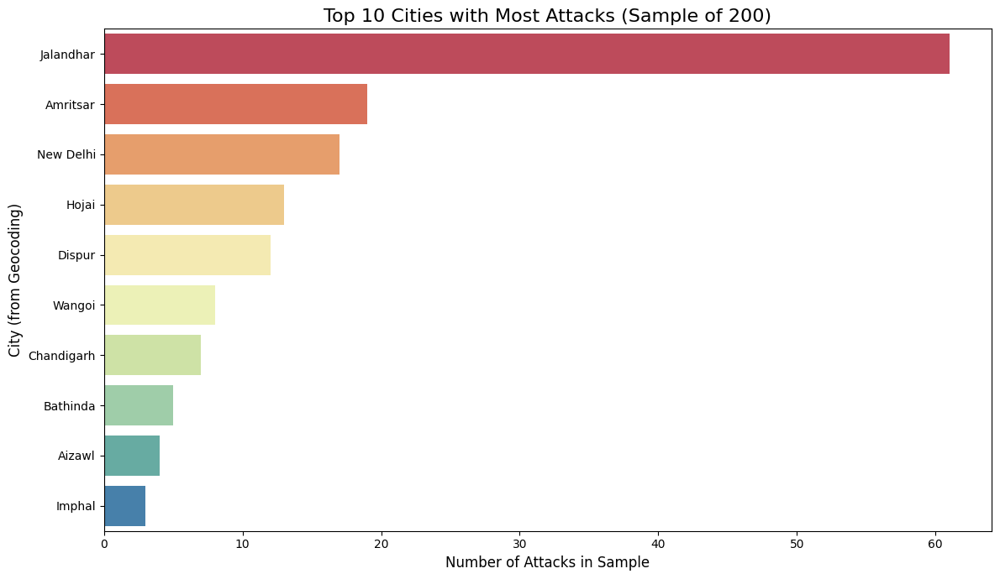

In [9]:
import pandas as pd
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from datetime import datetime
import time
import warnings
import matplotlib.pyplot as plt
import seaborn as sns

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

# --- Geocoding Function ---
def get_city_from_coords(lat, lon, geolocator):
    """
    Attempts to find the city name from latitude and longitude.
    Handles potential errors and returns None if not found.
    """
    if pd.isna(lat) or pd.isna(lon):
        return None
    try:
        # Use reverse geocoding
        location = geolocator.reverse((lat, lon), exactly_one=True, language='en', timeout=10)
        if location and location.raw.get('address'):
            address = location.raw['address']
            # Try to extract city, town, village, or state district
            city = address.get('city', address.get('town', address.get('village', address.get('state_district'))))
            return city
        else:
            return None
    except Exception as e:
        # log_message(f"Geocoding error for ({lat}, {lon}): {e}") # Optional: print errors
        return None

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Geocoding script started.")

    # Load data
    log_message("Loading data...")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message(f"Data loaded successfully with {len(df)} records.")

    # Filter for India
    log_message("Filtering data for India...")
    india_df = df[df['Country'] == 'India'].copy()
    if india_df.empty:
        log_message("No data found for India. Exiting.")
        exit()
    log_message(f"Found {len(india_df)} records for India.")

    # --- Geocoding Setup ---
    log_message("Setting up geocoder...")
    # Initialize Nominatim geolocator
    geolocator = Nominatim(user_agent="gtd_analysis_app")
    # Apply rate limiting (1 request per second) to respect Nominatim's usage policy
    reverse_geocode = RateLimiter(get_city_from_coords, min_delay_seconds=1)

    # --- Apply Geocoding to a Sample ---
    sample_size = 200 # Adjust sample size as needed (larger takes longer)
    log_message(f"Applying reverse geocoding to a sample of {sample_size} records... This may take several minutes.")
    
    # Take a sample for demonstration
    india_sample_df = india_df.head(sample_size).copy()

    # Apply the geocoding function
    india_sample_df['City'] = india_sample_df.apply(
        lambda row: reverse_geocode(row['Latitude'], row['Longitude'], geolocator=geolocator),
        axis=1
    )
    
    # Wait a bit just in case of final requests
    time.sleep(1) 
    
    log_message("Geocoding for the sample complete.")

    # --- Analyze and Display Results ---
    log_message("Analyzing geocoded results for the sample...")
    
    # Fill missing city names with 'Unknown/Not Found'
    india_sample_df['City'] = india_sample_df['City'].fillna('Unknown/Not Found')

    # Display the first few rows with the new City column
    print("\n--- Sample Data with Geocoded City ---")
    print(india_sample_df[['Year', 'Latitude', 'Longitude', 'City', 'GroupName']].head(10).to_markdown(index=False))
    print("-------------------------------------\n")

    # Count attacks per city in the sample
    city_counts = india_sample_df['City'].value_counts()
    
    # Exclude 'Unknown/Not Found' for the top cities plot if it's dominant
    city_counts_plot = city_counts[city_counts.index != 'Unknown/Not Found'].nlargest(10)

    if not city_counts_plot.empty:
        log_message("Generating plot for top cities found in the sample...")
        plt.figure(figsize=(12, 7))
        sns.barplot(x=city_counts_plot.values, y=city_counts_plot.index, palette='Spectral')
        plt.title(f'Top {len(city_counts_plot)} Cities with Most Attacks (Sample of {sample_size})', fontsize=16)
        plt.xlabel('Number of Attacks in Sample', fontsize=12)
        plt.ylabel('City (from Geocoding)', fontsize=12)
        plt.tight_layout()
        plt.savefig('india_top_cities_sample.png')
        log_message("Top cities plot saved as 'india_top_cities_sample.png'.")
    else:
        log_message("No specific cities found or identified reliably in the sample to plot.")

    # --- Save Sample Output ---
    output_filename = f'india_attacks_sample_{sample_size}_geocoded.csv'
    india_sample_df.to_csv(output_filename, index=False)
    log_message(f"Geocoded sample data saved to '{output_filename}'.")

    log_message("Geocoding script finished.")

In [10]:
import pandas as pd
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
from datetime import datetime
import time
import warnings

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

# --- Geocoding Function ---
def get_city_from_coords(lat, lon, geolocator):
    """Attempts to find the city name from latitude and longitude."""
    if pd.isna(lat) or pd.isna(lon): return None
    try:
        location = geolocator.reverse((lat, lon), exactly_one=True, language='en', timeout=10)
        if location and location.raw.get('address'):
            address = location.raw['address']
            city = address.get('city', address.get('town', address.get('village', address.get('state_district'))))
            return city
        else: return None
    except Exception: return None

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Geocoding script (Larger Sample) started.")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message("Filtering data for India...")
    india_df = df[df['Country'] == 'India'].copy()
    log_message(f"Found {len(india_df)} records for India.")

    # --- Geocoding Setup ---
    geolocator = Nominatim(user_agent="gtd_analysis_app_large_sample")
    reverse_geocode = RateLimiter(get_city_from_coords, min_delay_seconds=1)

    # --- Apply Geocoding to a Larger Sample ---
    sample_size = 2000 # Increased sample size
    log_message(f"Applying reverse geocoding to a sample of {sample_size} records... ESTIMATED TIME: ~{sample_size // 60} minutes.")
    india_sample_df = india_df.sample(n=min(sample_size, len(india_df)), random_state=42).copy() # Use min to handle cases with <2000 records

    # Apply the geocoding function (this is the slow part)
    india_sample_df['City'] = india_sample_df.apply(
        lambda row: reverse_geocode(row['Latitude'], row['Longitude'], geolocator=geolocator),
        axis=1
    )
    time.sleep(1)
    log_message("Geocoding for the sample complete.")

    # --- Save Sample Output ---
    output_filename = f'india_attacks_sample_{sample_size}_geocoded.csv'
    india_sample_df.to_csv(output_filename, index=False)
    log_message(f"Geocoded sample data saved to '{output_filename}'.")
    log_message("Geocoding script finished. You can now run the mapping script.")

[2025-10-24 06:53:28] Geocoding script (Larger Sample) started.
[2025-10-24 06:53:28] Filtering data for India...
[2025-10-24 06:53:28] Found 13929 records for India.
[2025-10-24 06:53:28] Applying reverse geocoding to a sample of 2000 records... ESTIMATED TIME: ~33 minutes.
[2025-10-24 07:26:54] Geocoding for the sample complete.
[2025-10-24 07:26:54] Geocoded sample data saved to 'india_attacks_sample_2000_geocoded.csv'.
[2025-10-24 07:26:54] Geocoding script finished. You can now run the mapping script.


In [11]:
import pandas as pd
import plotly.express as px
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        # Add more mappings relevant to India if needed
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore') # Ignore error if GroupName was already dropped
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Interactive Map script started.")

    # Load the GEOCODED SAMPLE data
    geocoded_file = 'india_attacks_sample_2000_geocoded.csv' # Make sure this matches the output of Step 1
    try:
        india_df = pd.read_csv(geocoded_file, encoding='ISO-8859-1')
        log_message(f"Loaded geocoded sample data from '{geocoded_file}'.")
    except FileNotFoundError:
        log_message(f"ERROR: File not found: '{geocoded_file}'. Please run the geocoding script first.")
        exit()

    # 1. Standardize group names
    india_df = standardize_group_names(india_df)

    # 2. Identify Top Groups in India from the sample
    N_TOP_GROUPS_INDIA = 10
    top_groups_india = india_df[india_df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_GROUPS_INDIA).index
    india_df['GroupColor'] = india_df['GroupName'].apply(lambda x: x if x in top_groups_india else 'Other Known/Unknown')
    log_message(f"Identified Top {N_TOP_GROUPS_INDIA} groups in India for coloring.")

    # Fill NaN cities for hover info
    india_df['City'] = india_df['City'].fillna('N/A')

    # 3. Create Interactive Map
    log_message("Generating interactive map with city names on hover...")
    map_center = dict(lat=20.5937, lon=78.9629)
    fig = px.scatter_mapbox(
        india_df,
        lat="Latitude",
        lon="Longitude",
        color="GroupColor",
        hover_name="GroupName",
        hover_data={ # Add City to the hover tooltip
            "Year": True,
            "City": True, # Display the geocoded city
            "AttackType": True,
            "TargetType": True,
            "WeaponType": True,
            "GroupColor": False
        },
        mapbox_style="carto-positron",
        zoom=4,
        center=map_center,
        title="Terrorist Attacks in India (Colored by Top Groups, City on Hover)",
        opacity=0.7,
        size_max=10
    )
    fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0}, legend_title_text='Responsible Group')

    # 4. Save Map as HTML
    output_html_file = "india_attack_map_with_cities.html"
    fig.write_html(output_html_file)
    log_message(f"Interactive map saved as '{output_html_file}'. Download this file and open in a browser.")

    log_message("Interactive Map script finished.")
    

[2025-10-24 07:27:59] Interactive Map script started.
[2025-10-24 07:27:59] Loaded geocoded sample data from 'india_attacks_sample_2000_geocoded.csv'.
[2025-10-24 07:27:59] Standardizing group names...
[2025-10-24 07:27:59] Group name standardization complete.
[2025-10-24 07:27:59] Identified Top 10 groups in India for coloring.
[2025-10-24 07:27:59] Generating interactive map with city names on hover...
[2025-10-24 07:27:59] Interactive map saved as 'india_attack_map_with_cities.html'. Download this file and open in a browser.
[2025-10-24 07:27:59] Interactive Map script finished.


In [12]:
import pandas as pd
import plotly.express as px
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
        # Add more global mappings if needed
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Interactive World Map script started (Top 50 Groups).")

    # Load the full cleaned data
    log_message("Loading full dataset...")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message(f"Data loaded successfully with {len(df)} records.")

    # 1. Standardize group names
    df = standardize_group_names(df)

    # 2. Identify Top 50 Groups Globally (Compromise for better visualization)
    N_TOP_GROUPS_GLOBAL = 50 # Increased from 15 to 50
    top_groups_global = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_GROUPS_GLOBAL).index

    # Create a simplified GroupName column for coloring
    df['GroupColor'] = df['GroupName'].apply(lambda x: x if x in top_groups_global else 'Other Known/Unknown')

    log_message(f"Identified Top {N_TOP_GROUPS_GLOBAL} groups globally for coloring.")

    # Remove rows with invalid coordinates for plotting
    df_map = df.dropna(subset=['Latitude', 'Longitude']).copy()
    log_message(f"Removed rows with missing coordinates. Plotting {len(df_map)} attacks.")

    # 3. Create Interactive World Map
    log_message("Generating interactive world map... This might take a bit longer with more groups.")

    # Define a discrete color sequence or let Plotly handle it (may recycle colors)
    # Using Plotly's default vibrant color sequence is usually best here.

    fig = px.scatter_mapbox(
        df_map,
        lat="Latitude",
        lon="Longitude",
        color="GroupColor", # Color by the simplified group category
        hover_name="GroupName", # Show actual group name on hover
        hover_data={ # Add details to the hover tooltip
            "Year": True,
            "Country": True,
            "Region": True,
            "AttackType": True,
            "TargetType": True,
            "WeaponType": True,
            "GroupColor": False # Don't show the simplified color name
        },
        category_orders={"GroupColor": list(top_groups_global) + ['Other Known/Unknown']}, # Control legend order
        mapbox_style="carto-positron", # Clean map style
        zoom=1, # Start zoomed out for global view
        center={"lat": 20, "lon": 0}, # Center the map roughly globally
        title=f"Global Terrorist Attacks (1970-2020) - Colored by Top {N_TOP_GROUPS_GLOBAL} Groups",
        opacity=0.7, # Use slight transparency for dense areas
        size_max=5 # Keep markers small
    )

    fig.update_layout(
        margin={"r":0,"t":40,"l":0,"b":0},
        legend_title_text=f'Responsible Group (Top {N_TOP_GROUPS_GLOBAL})',
        legend=dict(traceorder='reversed', # Show 'Other' at the bottom
                    font=dict(size=8)) # Make legend font smaller
        # Consider removing the legend if it becomes too large: legend=dict(visible=False)
    )

    # 4. Save Map as HTML
    output_html_file = f"world_attack_map_top_{N_TOP_GROUPS_GLOBAL}.html"
    fig.write_html(output_html_file)
    log_message(f"Interactive world map saved as '{output_html_file}'. Download this file and open in a browser.")

    log_message("Interactive World Map script finished.")

[2025-10-24 07:34:02] Interactive World Map script started (Top 50 Groups).
[2025-10-24 07:34:02] Loading full dataset...
[2025-10-24 07:34:02] Data loaded successfully with 209706 records.
[2025-10-24 07:34:02] Standardizing group names...
[2025-10-24 07:34:09] Group name standardization complete.
[2025-10-24 07:34:10] Identified Top 50 groups globally for coloring.
[2025-10-24 07:34:10] Removed rows with missing coordinates. Plotting 209706 attacks.
[2025-10-24 07:34:10] Generating interactive world map... This might take a bit longer with more groups.
[2025-10-24 07:34:13] Interactive world map saved as 'world_attack_map_top_50.html'. Download this file and open in a browser.
[2025-10-24 07:34:13] Interactive World Map script finished.


In [13]:
import pandas as pd
import plotly.express as px
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column to merge aliases."""
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
        # Add more global mappings if needed
    }
    # Standardize before filtering Unknown
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Interactive World Map script started (Known Groups Only, Top 50).")

    # Load the full cleaned data
    log_message("Loading full dataset...")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message(f"Data loaded successfully with {len(df)} records.")

    # 1. Standardize group names
    df = standardize_group_names(df)

    # 2. **NEW**: Filter out 'Unknown' group attacks BEFORE analysis
    log_message("Filtering out attacks attributed to 'Unknown' group...")
    df_known = df[df['GroupName'] != 'Unknown'].copy()
    log_message(f"Filtered dataset contains {len(df_known)} records from known groups.")

    if df_known.empty:
        log_message("No data remaining after filtering 'Unknown'. Exiting.")
        exit()

    # 3. Identify Top 50 KNOWN Groups Globally
    N_TOP_GROUPS_GLOBAL = 50
    # Find top groups from the filtered data
    top_groups_global = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS_GLOBAL).index

    # Create a simplified GroupName column for coloring ('Other Known' for non-top 50)
    df_known['GroupColor'] = df_known['GroupName'].apply(lambda x: x if x in top_groups_global else 'Other Known')

    log_message(f"Identified Top {N_TOP_GROUPS_GLOBAL} known groups globally for coloring.")

    # Remove rows with invalid coordinates for plotting
    df_map = df_known.dropna(subset=['Latitude', 'Longitude']).copy()
    log_message(f"Removed rows with missing coordinates. Plotting {len(df_map)} attacks from known groups.")

    # 4. Create Interactive World Map
    log_message("Generating interactive world map for known groups...")

    fig = px.scatter_mapbox(
        df_map,
        lat="Latitude",
        lon="Longitude",
        color="GroupColor", # Color by the simplified known group category
        hover_name="GroupName", # Show actual group name on hover
        hover_data={ # Add details to the hover tooltip
            "Year": True,
            "Country": True,
            "Region": True,
            "AttackType": True,
            "TargetType": True,
            "WeaponType": True,
            "GroupColor": False # Don't show the simplified color name
        },
        # Ensure 'Other Known' is last in the legend if present
        category_orders={"GroupColor": sorted(list(top_groups_global)) + ['Other Known']},
        mapbox_style="carto-positron", # Clean map style
        zoom=1, # Start zoomed out for global view
        center={"lat": 20, "lon": 0}, # Center the map roughly globally
        title=f"Global Terrorist Attacks by Known Groups (1970-2020) - Colored by Top {N_TOP_GROUPS_GLOBAL}",
        opacity=0.7,
        size_max=5
    )

    fig.update_layout(
        margin={"r":0,"t":40,"l":0,"b":0},
        legend_title_text=f'Responsible Group (Top {N_TOP_GROUPS_GLOBAL} Known)',
        legend=dict(traceorder='reversed', # Show 'Other Known' at the bottom
                    font=dict(size=8))
    )

    # 5. Save Map as HTML
    output_html_file = f"world_attack_map_known_groups_top_{N_TOP_GROUPS_GLOBAL}.html"
    fig.write_html(output_html_file)
    log_message(f"Interactive world map saved as '{output_html_file}'. Download this file and open in a browser.")

    log_message("Interactive World Map script finished.")

[2025-10-24 07:39:21] Interactive World Map script started (Known Groups Only, Top 50).
[2025-10-24 07:39:21] Loading full dataset...
[2025-10-24 07:39:21] Data loaded successfully with 209706 records.
[2025-10-24 07:39:21] Standardizing group names...
[2025-10-24 07:39:28] Group name standardization complete.
[2025-10-24 07:39:28] Filtering out attacks attributed to 'Unknown' group...
[2025-10-24 07:39:28] Filtered dataset contains 117800 records from known groups.
[2025-10-24 07:39:28] Identified Top 50 known groups globally for coloring.
[2025-10-24 07:39:28] Removed rows with missing coordinates. Plotting 117800 attacks from known groups.
[2025-10-24 07:39:28] Generating interactive world map for known groups...
[2025-10-24 07:39:30] Interactive world map saved as 'world_attack_map_known_groups_top_50.html'. Download this file and open in a browser.
[2025-10-24 07:39:30] Interactive World Map script finished.


[2025-10-24 07:50:08] Time Series Forecasting script started.
[2025-10-24 07:50:08] Loading data...
[2025-10-24 07:50:08] Data loaded successfully with 209706 records.
[2025-10-24 07:50:08] Preparing monthly time series data...
[2025-10-24 07:50:08] Monthly attack counts prepared.

--- Sample Monthly Attack Counts ---
2020-08-31    730
2020-09-30    785
2020-10-31    747
2020-11-30    650
2020-12-31    647
Freq: ME, dtype: int64
------------------------------------

[2025-10-24 07:50:08] Visualizing the historical time series...
[2025-10-24 07:50:08] Time series plot saved as 'global_attacks_timeseries.png'.
[2025-10-24 07:50:08] Training SARIMA model... This may take a few minutes.
[2025-10-24 07:50:10] SARIMA model training complete.

--- SARIMA Model Summary ---
                                     SARIMAX Results                                      
Dep. Variable:                                  y   No. Observations:                  612
Model:             SARIMAX(1, 1, 1)x(1, 1,

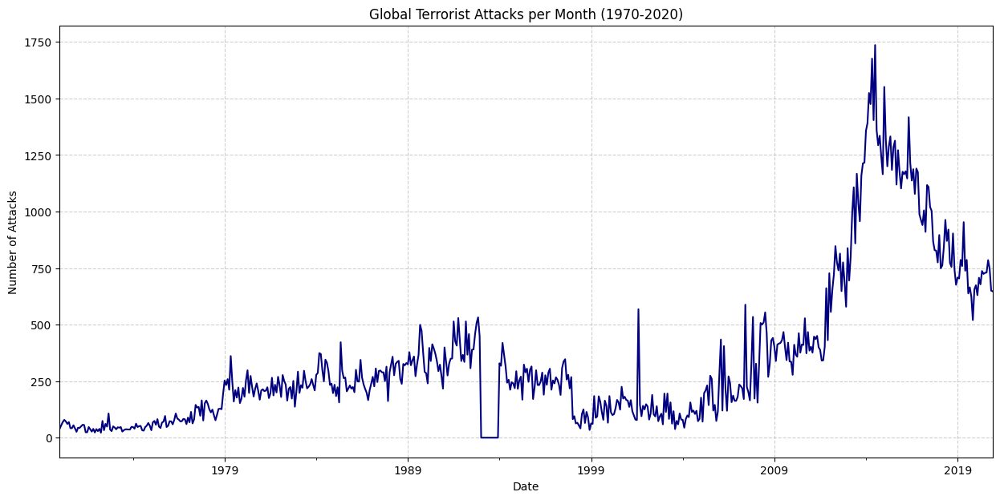

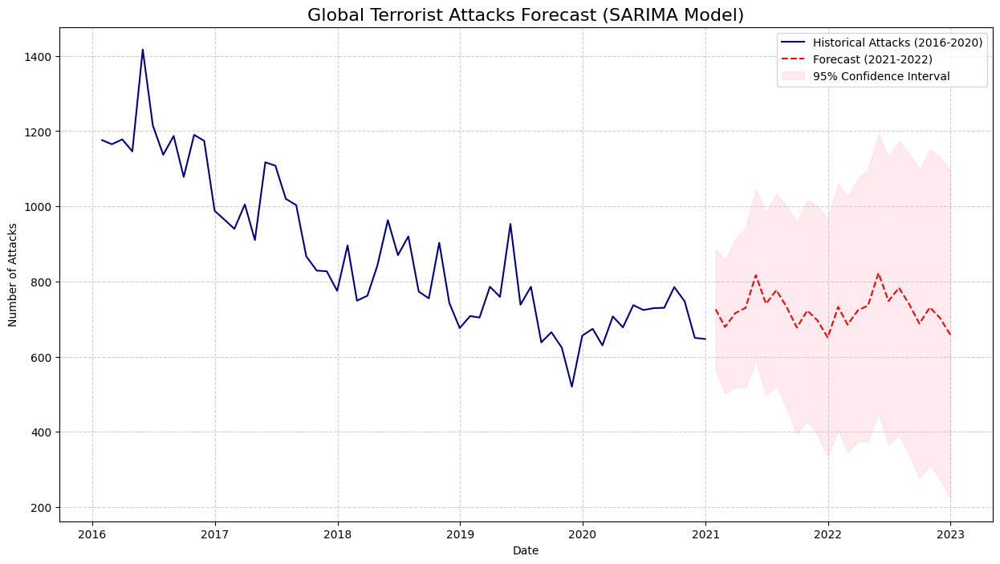

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings("ignore")

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Time Series Forecasting script started.")

# --- 1. Load Data ---
log_message("Loading data...")
# Use the cleaned dataset which is sufficient for counting attacks
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. Prepare Time Series Data ---
log_message("Preparing monthly time series data...")
# Ensure 'Month' is valid (replace 0 with 1 for simplicity if necessary)
df['Month'] = df['Month'].replace(0, 1)
# Create a 'Date' column (set day to 1st of the month)
df['Date'] = pd.to_datetime(df[['Year', 'Month']].assign(Day=1))

# Aggregate counts by month
monthly_attacks = df.set_index('Date').resample('M').size() # 'M' means month-end frequency

# Check for missing months and fill with 0
all_months = pd.date_range(start=monthly_attacks.index.min(), end=monthly_attacks.index.max(), freq='M')
monthly_attacks = monthly_attacks.reindex(all_months, fill_value=0)

log_message("Monthly attack counts prepared.")
print("\n--- Sample Monthly Attack Counts ---")
print(monthly_attacks.tail())
print("------------------------------------\n")

# --- 3. Visualize the Time Series ---
log_message("Visualizing the historical time series...")
plt.figure(figsize=(15, 7))
monthly_attacks.plot(title='Global Terrorist Attacks per Month (1970-2020)', color='navy')
plt.xlabel('Date')
plt.ylabel('Number of Attacks')
plt.grid(True, linestyle='--', alpha=0.6)
plt.savefig('global_attacks_timeseries.png')
log_message("Time series plot saved as 'global_attacks_timeseries.png'.")

# --- Optional: ACF/PACF plots (can help determine model order, but complex to interpret) ---
# log_message("Generating ACF and PACF plots...")
# fig, ax = plt.subplots(1, 2, figsize=(16, 4))
# plot_acf(monthly_attacks, lags=40, ax=ax[0])
# plot_pacf(monthly_attacks, lags=40, ax=ax[1])
# plt.savefig('acf_pacf_plots.png')
# log_message("ACF/PACF plots saved.")

# --- 4. Train SARIMA Model ---
# SARIMA(p,d,q)(P,D,Q,m) - Seasonal Autoregressive Integrated Moving Average
# We'll use a common seasonal order (P=1, D=1, Q=1, m=12 for yearly seasonality)
# and a simple non-seasonal order (p=1, d=1, q=1). Finding optimal orders is complex.
log_message("Training SARIMA model... This may take a few minutes.")
# Note: Using enforce_stationarity=False and enforce_invertibility=False can help convergence
try:
    model = SARIMAX(monthly_attacks,
                    order=(1, 1, 1),              # (p, d, q)
                    seasonal_order=(1, 1, 1, 12), # (P, D, Q, m)
                    enforce_stationarity=False,
                    enforce_invertibility=False)
    results = model.fit(disp=False) # disp=False hides convergence output
    log_message("SARIMA model training complete.")
    print("\n--- SARIMA Model Summary ---")
    print(results.summary())
    print("----------------------------\n")

    # --- 5. Make Forecast ---
    log_message("Generating forecast for the next 24 months (2021-2022)...")
    forecast_steps = 24
    forecast = results.get_forecast(steps=forecast_steps)
    forecast_index = pd.date_range(start=monthly_attacks.index[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='M')
    forecast_values = forecast.predicted_mean
    forecast_ci = forecast.conf_int() # Get confidence intervals

    # Combine forecast values and confidence intervals
    forecast_df = pd.DataFrame({'Forecast': forecast_values}, index=forecast_index)
    forecast_df['Lower CI'] = forecast_ci.iloc[:, 0]
    forecast_df['Upper CI'] = forecast_ci.iloc[:, 1]

    log_message("Forecast generated.")
    print("\n--- Forecasted Monthly Attacks (2021-2022) ---")
    print(forecast_df)
    print("-----------------------------------------------\n")


    # --- 6. Visualize Forecast ---
    log_message("Visualizing the forecast...")
    plt.figure(figsize=(15, 8))
    # Plot historical data (last 5 years for context)
    plt.plot(monthly_attacks.loc['2016':], label='Historical Attacks (2016-2020)', color='navy')
    # Plot forecast
    plt.plot(forecast_df['Forecast'], label='Forecast (2021-2022)', color='red', linestyle='--')
    # Plot confidence interval
    plt.fill_between(forecast_df.index,
                     forecast_df['Lower CI'],
                     forecast_df['Upper CI'], color='pink', alpha=0.3, label='95% Confidence Interval')

    plt.title('Global Terrorist Attacks Forecast (SARIMA Model)', fontsize=16)
    plt.xlabel('Date')
    plt.ylabel('Number of Attacks')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.savefig('global_attacks_forecast.png')
    log_message("Forecast visualization saved as 'global_attacks_forecast.png'.")

except Exception as e:
    log_message(f"An error occurred during model training or forecasting: {e}")
    log_message("Time series modeling can be complex and data-dependent. This might indicate issues with model parameters or data stationarity.")


log_message("Time Series Forecasting script finished.")

[2025-10-24 08:01:04] Advanced Time Series Analysis script started.
[2025-10-24 08:01:04] Loading data...
[2025-10-24 08:01:04] Data loaded successfully with 209706 records.
[2025-10-24 08:01:04] Preparing monthly time series data...
[2025-10-24 08:01:05] Monthly attack counts prepared.
[2025-10-24 08:01:05] Performing time series decomposition...
[2025-10-24 08:01:06] Decomposition plot saved as 'timeseries_decomposition.png'.
[2025-10-24 08:01:06] Retraining SARIMA model to get residuals...
[2025-10-24 08:01:07] SARIMA model training complete.
[2025-10-24 08:01:07] Generating SARIMA residual diagnostics...
[2025-10-24 08:01:08] SARIMA residual diagnostics plot saved.
[2025-10-24 08:01:08] Training Holt-Winters Exponential Smoothing model...
[2025-10-24 08:01:08] Holt-Winters model training complete.
[2025-10-24 08:01:08] Generating Holt-Winters forecast...
[2025-10-24 08:01:08] Generating forecast comparison plot...
[2025-10-24 08:01:09] Forecast comparison plot saved as 'forecast_co

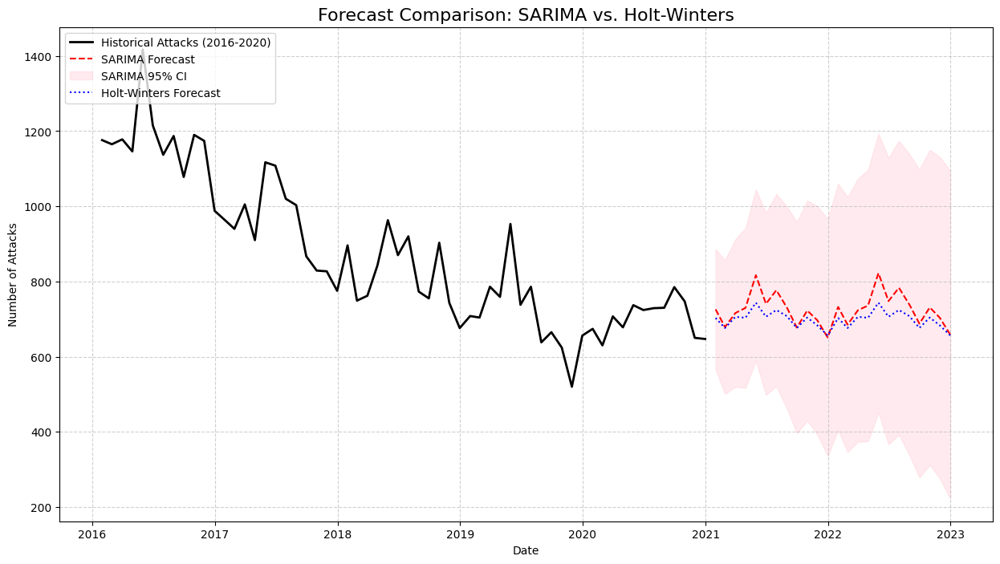

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import statsmodels.api as sm # For Q-Q plot
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings("ignore")

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Advanced Time Series Analysis script started.")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. Prepare Time Series Data ---
log_message("Preparing monthly time series data...")
df['Month'] = df['Month'].replace(0, 1)
df['Date'] = pd.to_datetime(df[['Year', 'Month']].assign(Day=1))
monthly_attacks = df.set_index('Date').resample('M').size()
all_months = pd.date_range(start=monthly_attacks.index.min(), end=monthly_attacks.index.max(), freq='M')
monthly_attacks = monthly_attacks.reindex(all_months, fill_value=0)
log_message("Monthly attack counts prepared.")

# --- 3. Time Series Decomposition ---
log_message("Performing time series decomposition...")
# Using an additive model as fluctuations seem somewhat stable over time, though multiplicative could also be tried.
decomposition = seasonal_decompose(monthly_attacks, model='additive', period=12) # period=12 for yearly seasonality

fig = decomposition.plot()
fig.set_size_inches(14, 10)
plt.suptitle('Time Series Decomposition of Global Attacks', y=1.02, fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.98]) # Adjust layout
plt.savefig('timeseries_decomposition.png')
log_message("Decomposition plot saved as 'timeseries_decomposition.png'.")
plt.close(fig) # Close the plot

# --- 4. Retrain SARIMA & Plot Residual Diagnostics ---
log_message("Retraining SARIMA model to get residuals...")
try:
    sarima_model = SARIMAX(monthly_attacks,
                           order=(1, 1, 1), seasonal_order=(1, 1, 1, 12),
                           enforce_stationarity=False, enforce_invertibility=False)
    sarima_results = sarima_model.fit(disp=False)
    log_message("SARIMA model training complete.")

    log_message("Generating SARIMA residual diagnostics...")
    # Plot diagnostics
    fig_diag = sarima_results.plot_diagnostics(figsize=(15, 12))
    plt.suptitle('SARIMA Model Residual Diagnostics', y=1.02, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.savefig('sarima_residual_diagnostics.png')
    log_message("SARIMA residual diagnostics plot saved.")
    plt.close(fig_diag)

    # Generate SARIMA forecast for comparison plot
    forecast_steps = 24
    sarima_forecast_obj = sarima_results.get_forecast(steps=forecast_steps)
    sarima_forecast_index = pd.date_range(start=monthly_attacks.index[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='M')
    sarima_forecast_df = pd.DataFrame({
        'SARIMA Forecast': sarima_forecast_obj.predicted_mean,
        'SARIMA Lower CI': sarima_forecast_obj.conf_int().iloc[:, 0],
        'SARIMA Upper CI': sarima_forecast_obj.conf_int().iloc[:, 1]
    }, index=sarima_forecast_index)

except Exception as e:
    log_message(f"An error occurred during SARIMA training/diagnostics: {e}")
    sarima_forecast_df = None # Ensure variable exists even if SARIMA fails


# --- 5. Alternative Model: Holt-Winters Exponential Smoothing ---
log_message("Training Holt-Winters Exponential Smoothing model...")
# Use 'add' for additive trend and seasonality, matching decomposition choice.
# Damped_trend can sometimes improve stability for long forecasts.
try:
    hw_model = ExponentialSmoothing(monthly_attacks,
                                    trend='add',
                                    seasonal='add',
                                    seasonal_periods=12,
                                    damped_trend=True) # Try damped trend
    hw_results = hw_model.fit()
    log_message("Holt-Winters model training complete.")

    # Generate Holt-Winters forecast
    log_message("Generating Holt-Winters forecast...")
    hw_forecast_values = hw_results.forecast(steps=forecast_steps)
    # Note: ExponentialSmoothing doesn't directly provide confidence intervals like SARIMA.
    # We can estimate them, but for simplicity, we'll just plot the point forecast.
    hw_forecast_df = pd.DataFrame({'Holt-Winters Forecast': hw_forecast_values}, index=sarima_forecast_index) # Use same index

except Exception as e:
    log_message(f"An error occurred during Holt-Winters training/forecasting: {e}")
    hw_forecast_df = None # Ensure variable exists


# --- 6. Comparison Plot ---
log_message("Generating forecast comparison plot...")
plt.figure(figsize=(15, 8))
# Plot historical data (last 5 years)
plt.plot(monthly_attacks.loc['2016':], label='Historical Attacks (2016-2020)', color='black', linewidth=2)

# Plot SARIMA forecast and CI (if available)
if sarima_forecast_df is not None:
    plt.plot(sarima_forecast_df['SARIMA Forecast'], label='SARIMA Forecast', color='red', linestyle='--')
    plt.fill_between(sarima_forecast_df.index,
                     sarima_forecast_df['SARIMA Lower CI'],
                     sarima_forecast_df['SARIMA Upper CI'], color='pink', alpha=0.3, label='SARIMA 95% CI')

# Plot Holt-Winters forecast (if available)
if hw_forecast_df is not None:
     plt.plot(hw_forecast_df['Holt-Winters Forecast'], label='Holt-Winters Forecast', color='blue', linestyle=':')


plt.title('Forecast Comparison: SARIMA vs. Holt-Winters', fontsize=16)
plt.xlabel('Date')
plt.ylabel('Number of Attacks')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.savefig('forecast_comparison_plot.png')
log_message("Forecast comparison plot saved as 'forecast_comparison_plot.png'.")


log_message("Advanced Time Series Analysis script finished.")

In [17]:
!pip install pyvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 13.4 MB/s eta 0:00:00a 0:00:01


In [18]:
import pandas as pd
import networkx as nx
from pyvis.network import Network
from collections import defaultdict
from itertools import combinations
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column."""
    # (Using the same standardization function as before)
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Network Analysis script started.")

    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    df = standardize_group_names(df)

    # Filter out 'Unknown' and select relevant columns
    df_known = df[df['GroupName'] != 'Unknown'][['GroupName', 'Region']].copy()

    # Identify Top N groups
    N_TOP_GROUPS = 20
    top_groups = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS).index.tolist()
    df_top = df_known[df_known['GroupName'].isin(top_groups)]
    log_message(f"Focusing network analysis on the top {N_TOP_GROUPS} known groups.")

    # Calculate group sizes (total attacks) for node scaling
    group_sizes = df_top['GroupName'].value_counts()

    # Find regions where each top group operates
    group_regions = df_top.groupby('GroupName')['Region'].apply(set).to_dict()

    # Calculate co-occurrence (shared regions)
    co_occurrence = defaultdict(int)
    for group1, group2 in combinations(top_groups, 2):
        shared_regions = len(group_regions[group1].intersection(group_regions[group2]))
        if shared_regions > 0:
            co_occurrence[(group1, group2)] = shared_regions

    log_message("Calculated geographic co-occurrence between groups.")

    # --- Build the Network Graph ---
    log_message("Building the network graph...")
    G = nx.Graph()

    # Add nodes (groups) with size based on activity
    min_size, max_size = 5, 30 # Min/max node sizes for visualization
    min_attacks, max_attacks = group_sizes.min(), group_sizes.max()
    for group in top_groups:
        # Scale node size logarithmically to handle large differences
        node_size = min_size + (max_size - min_size) * (
            (group_sizes[group] - min_attacks) / (max_attacks - min_attacks + 1) # +1 avoids division by zero if all sizes are same
        ) if max_attacks > min_attacks else (min_size + max_size) / 2
        G.add_node(group, size=node_size, title=f"{group}\nAttacks: {group_sizes[group]}") # Title for hover info

    # Add edges (links) with weight based on shared regions
    min_weight, max_weight = 1, 10 # Min/max edge thickness
    min_shared, max_shared = 1, max(co_occurrence.values()) if co_occurrence else 1
    for (group1, group2), shared_count in co_occurrence.items():
         # Scale edge width
        edge_width = min_weight + (max_weight - min_weight) * (
             (shared_count - min_shared) / (max_shared - min_shared + 1)
        ) if max_shared > min_shared else (min_weight + max_weight) / 2
        G.add_edge(group1, group2, value=edge_width, title=f"Shared Regions: {shared_count}") # Title for hover info

    log_message("Network graph constructed.")

    # --- Visualize with Pyvis ---
    log_message("Generating interactive network visualization...")
    net = Network(notebook=False, height="750px", width="100%", bgcolor="#222222", font_color="white", heading=f"Network of Top {N_TOP_GROUPS} Terrorist Groups (Links = Shared Regions)")

    net.from_nx(G)

    # Add physics layout options for better visualization
    net.force_atlas_2based(gravity=-50, central_gravity=0.01, spring_length=100, spring_strength=0.08, damping=0.4)
    # Enable interaction options
    net.show_buttons(filter_=['physics'])

    output_filename = "terrorist_group_network.html"
    net.save_graph(output_filename)
    log_message(f"Interactive network graph saved as '{output_filename}'. Open this file in a browser.")

    log_message("Network Analysis script finished.")

[2025-10-24 08:04:52] Network Analysis script started.
[2025-10-24 08:04:52] Standardizing group names...
[2025-10-24 08:04:59] Group name standardization complete.
[2025-10-24 08:04:59] Focusing network analysis on the top 20 known groups.
[2025-10-24 08:04:59] Calculated geographic co-occurrence between groups.
[2025-10-24 08:04:59] Building the network graph...
[2025-10-24 08:04:59] Network graph constructed.
[2025-10-24 08:04:59] Generating interactive network visualization...
[2025-10-24 08:04:59] Interactive network graph saved as 'terrorist_group_network.html'. Open this file in a browser.
[2025-10-24 08:04:59] Network Analysis script finished.


[2025-10-24 08:10:27] Advanced Time Series Analysis script started (SARIMA vs Prophet).
[2025-10-24 08:10:27] Loading data...
[2025-10-24 08:10:27] Data loaded successfully with 209706 records.
[2025-10-24 08:10:27] Preparing monthly time series data...
[2025-10-24 08:10:27] Monthly attack counts prepared.
[2025-10-24 08:10:27] Performing time series decomposition...
[2025-10-24 08:10:29] Decomposition plot saved.
[2025-10-24 08:10:29] Training SARIMA model and generating diagnostics...
[2025-10-24 08:10:30] SARIMA model training complete.
[2025-10-24 08:10:30] Generating SARIMA residual diagnostics...


08:10:31 - cmdstanpy - INFO - Chain [1] start processing


[2025-10-24 08:10:31] SARIMA residual diagnostics plot saved.
[2025-10-24 08:10:31] SARIMA forecast generated.
[2025-10-24 08:10:31] Training Prophet model...


08:10:31 - cmdstanpy - INFO - Chain [1] done processing


[2025-10-24 08:10:31] Prophet model training complete.
[2025-10-24 08:10:31] Prophet forecast generated.
[2025-10-24 08:10:31] Generating Prophet components plot...
[2025-10-24 08:10:32] Prophet components plot saved.
[2025-10-24 08:10:32] Generating final forecast comparison plot...
[2025-10-24 08:10:32] Forecast comparison plot saved as 'forecast_comparison_sarima_prophet.png'.
[2025-10-24 08:10:32] Advanced Time Series Analysis script finished.


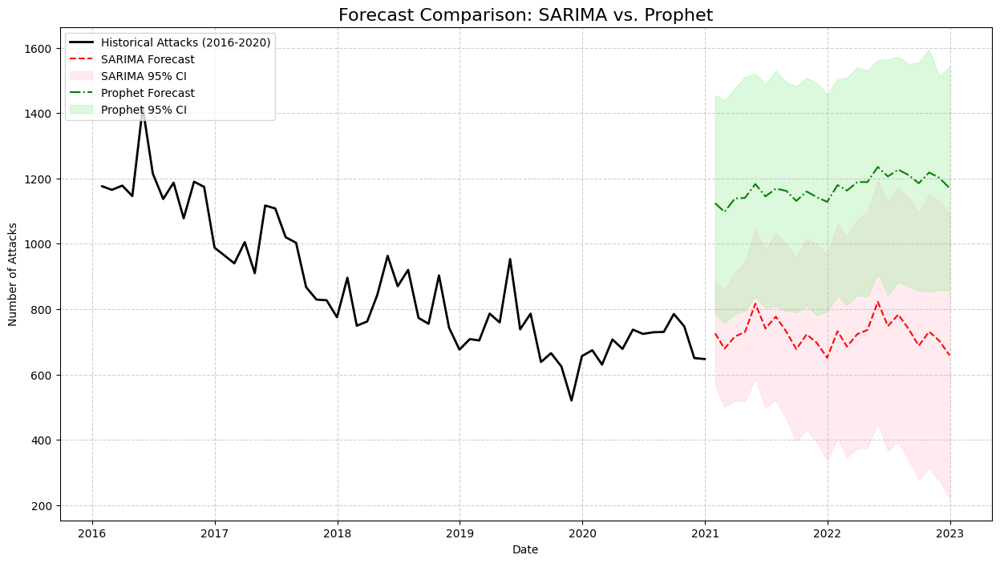

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.statespace.sarimax import SARIMAX
# **NEW**: Import Prophet
from prophet import Prophet
# from statsmodels.tsa.holtwinters import ExponentialSmoothing # Removed Holt-Winters
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import statsmodels.api as sm # For Q-Q plot
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings("ignore")

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Advanced Time Series Analysis script started (SARIMA vs Prophet).")

# --- 1. Load Data ---
log_message("Loading data...")
df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
log_message(f"Data loaded successfully with {len(df)} records.")

# --- 2. Prepare Time Series Data ---
log_message("Preparing monthly time series data...")
df['Month'] = df['Month'].replace(0, 1)
df['Date'] = pd.to_datetime(df[['Year', 'Month']].assign(Day=1))
monthly_attacks = df.set_index('Date').resample('M').size()
all_months = pd.date_range(start=monthly_attacks.index.min(), end=monthly_attacks.index.max(), freq='M')
monthly_attacks = monthly_attacks.reindex(all_months, fill_value=0)
log_message("Monthly attack counts prepared.")

# --- 3. Time Series Decomposition ---
log_message("Performing time series decomposition...")
decomposition = seasonal_decompose(monthly_attacks, model='additive', period=12)
fig_decomp = decomposition.plot()
fig_decomp.set_size_inches(14, 10)
plt.suptitle('Time Series Decomposition of Global Attacks', y=1.02, fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('timeseries_decomposition.png')
log_message("Decomposition plot saved.")
plt.close(fig_decomp)

# --- 4. SARIMA Model & Diagnostics ---
log_message("Training SARIMA model and generating diagnostics...")
sarima_forecast_df = None # Initialize in case of error
try:
    sarima_model = SARIMAX(monthly_attacks,
                           order=(1, 1, 1), seasonal_order=(1, 1, 1, 12),
                           enforce_stationarity=False, enforce_invertibility=False)
    sarima_results = sarima_model.fit(disp=False)
    log_message("SARIMA model training complete.")

    log_message("Generating SARIMA residual diagnostics...")
    fig_diag = sarima_results.plot_diagnostics(figsize=(15, 12))
    plt.suptitle('SARIMA Model Residual Diagnostics', y=1.02, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.98])
    plt.savefig('sarima_residual_diagnostics.png')
    log_message("SARIMA residual diagnostics plot saved.")
    plt.close(fig_diag)

    # Generate SARIMA forecast
    forecast_steps = 24
    sarima_forecast_obj = sarima_results.get_forecast(steps=forecast_steps)
    sarima_forecast_index = pd.date_range(start=monthly_attacks.index[-1] + pd.DateOffset(months=1), periods=forecast_steps, freq='M')
    sarima_forecast_df = pd.DataFrame({
        'SARIMA Forecast': sarima_forecast_obj.predicted_mean,
        'SARIMA Lower CI': sarima_forecast_obj.conf_int().iloc[:, 0],
        'SARIMA Upper CI': sarima_forecast_obj.conf_int().iloc[:, 1]
    }, index=sarima_forecast_index)
    log_message("SARIMA forecast generated.")

except Exception as e:
    log_message(f"An error occurred during SARIMA: {e}")


# --- 5. Alternative Model: Prophet ---
log_message("Training Prophet model...")
prophet_forecast_df = None # Initialize in case of error
try:
    # Prophet requires columns named 'ds' (datetime) and 'y' (value)
    prophet_df = monthly_attacks.reset_index()
    prophet_df.columns = ['ds', 'y']

    # Initialize and fit the model
    # Prophet automatically detects yearly seasonality
    prophet_model = Prophet(interval_width=0.95) # 95% confidence interval
    prophet_model.fit(prophet_df)
    log_message("Prophet model training complete.")

    # Create future dataframe for predictions
    future = prophet_model.make_future_dataframe(periods=forecast_steps, freq='M')
    # Generate Prophet forecast
    prophet_forecast = prophet_model.predict(future)
    log_message("Prophet forecast generated.")

    # Extract the forecast and CIs for the future periods
    prophet_forecast_df = prophet_forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(forecast_steps)
    prophet_forecast_df = prophet_forecast_df.set_index('ds')
    prophet_forecast_df.columns = ['Prophet Forecast', 'Prophet Lower CI', 'Prophet Upper CI']

    # --- Optional: Plot Prophet components ---
    log_message("Generating Prophet components plot...")
    fig_prophet_comp = prophet_model.plot_components(prophet_forecast)
    plt.suptitle('Prophet Model Components (Trend & Seasonality)', y=1.02, fontsize=16)
    plt.savefig('prophet_components.png')
    log_message("Prophet components plot saved.")
    plt.close(fig_prophet_comp)


except Exception as e:
    log_message(f"An error occurred during Prophet: {e}")


# --- 6. Final Comparison Plot ---
log_message("Generating final forecast comparison plot...")
plt.figure(figsize=(15, 8))
# Plot historical data (last 5 years)
plt.plot(monthly_attacks.loc['2016':], label='Historical Attacks (2016-2020)', color='black', linewidth=2)

# Plot SARIMA forecast and CI (if available)
if sarima_forecast_df is not None:
    plt.plot(sarima_forecast_df['SARIMA Forecast'], label='SARIMA Forecast', color='red', linestyle='--')
    plt.fill_between(sarima_forecast_df.index,
                     sarima_forecast_df['SARIMA Lower CI'],
                     sarima_forecast_df['SARIMA Upper CI'], color='pink', alpha=0.3, label='SARIMA 95% CI')

# Plot Prophet forecast and CI (if available)
if prophet_forecast_df is not None:
     plt.plot(prophet_forecast_df['Prophet Forecast'], label='Prophet Forecast', color='green', linestyle='-.')
     plt.fill_between(prophet_forecast_df.index,
                      prophet_forecast_df['Prophet Lower CI'],
                      prophet_forecast_df['Prophet Upper CI'], color='lightgreen', alpha=0.3, label='Prophet 95% CI')


plt.title('Forecast Comparison: SARIMA vs. Prophet', fontsize=16)
plt.xlabel('Date')
plt.ylabel('Number of Attacks')
plt.legend(loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.savefig('forecast_comparison_sarima_prophet.png')
log_message("Forecast comparison plot saved as 'forecast_comparison_sarima_prophet.png'.")


log_message("Advanced Time Series Analysis script finished.")

In [21]:
import pandas as pd
import networkx as nx
from pyvis.network import Network
from collections import defaultdict
from itertools import combinations
from datetime import datetime
import warnings
import re
import matplotlib.cm as cm
import matplotlib.colors as mcolors

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column."""
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Improved Network Analysis script started.")

    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    df = standardize_group_names(df)

    # Filter out 'Unknown' and select relevant columns
    df_known = df[df['GroupName'] != 'Unknown'][['GroupName', 'Region', 'Country']].copy()

    # Identify Top N groups
    N_TOP_GROUPS = 20
    top_groups = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS).index.tolist()
    df_top = df_known[df_known['GroupName'].isin(top_groups)]
    log_message(f"Focusing network analysis on the top {N_TOP_GROUPS} known groups.")

    # Calculate group sizes (total attacks) for node scaling
    group_sizes = df_top['GroupName'].value_counts()

    # Find COUNTRIES where each top group operates
    group_countries = df_top.groupby('GroupName')['Country'].apply(set).to_dict()

    # Find the PRIMARY REGION for each group (for node coloring)
    group_primary_region = df_top.groupby('GroupName')['Region'].agg(lambda x: x.mode()[0] if not x.mode().empty else 'Unknown').to_dict()

    # Create a color map for regions
    unique_regions = sorted(df_top['Region'].unique())
    colors = cm.get_cmap('tab20', len(unique_regions))
    region_color_map = {region: mcolors.rgb2hex(colors(i)) for i, region in enumerate(unique_regions)}

    # Calculate co-occurrence based on shared COUNTRIES
    co_occurrence = defaultdict(int)
    for group1, group2 in combinations(top_groups, 2):
        if group1 in group_countries and group2 in group_countries:
            shared_countries = len(group_countries[group1].intersection(group_countries[group2]))
            if shared_countries > 0:
                co_occurrence[(group1, group2)] = shared_countries
        else:
             if group1 not in group_countries: log_message(f"Warning: Missing country data for {group1}")
             if group2 not in group_countries: log_message(f"Warning: Missing country data for {group2}")

    log_message("Calculated geographic co-occurrence based on shared COUNTRIES.")

    # --- Build the Network Graph ---
    log_message("Building the network graph...")
    G = nx.Graph()

    # Add nodes (groups) with size and COLOR
    min_size, max_size = 8, 35
    min_attacks, max_attacks = group_sizes.min(), group_sizes.max()
    for group in top_groups:
        node_size = min_size + (max_size - min_size) * (
            (group_sizes[group] - min_attacks) / (max_attacks - min_attacks + 1)
        ) if max_attacks > min_attacks else (min_size + max_size) / 2
        primary_region = group_primary_region.get(group, 'Unknown')
        node_color = region_color_map.get(primary_region, '#808080')
        G.add_node(group,
                   size=node_size,
                   color=node_color,
                   title=f"{group}\nRegion: {primary_region}\nAttacks: {group_sizes[group]}")

    # Add edges (links) with weight based on shared COUNTRIES
    min_weight, max_weight = 1, 10
    if co_occurrence:
        min_shared, max_shared = 1, max(co_occurrence.values())
        for (group1, group2), shared_count in co_occurrence.items():
            edge_width = min_weight + (max_weight - min_weight) * (
                 (shared_count - min_shared) / (max_shared - min_shared + 1)
            ) if max_shared > min_shared else (min_weight + max_weight) / 2
            G.add_edge(group1, group2, value=edge_width, title=f"Shared Countries: {shared_count}")
    else:
        log_message("No co-occurrences found to create edges.")

    log_message("Network graph constructed.")

    # --- Visualize with Pyvis ---
    log_message("Generating interactive network visualization...")
    # **CORRECTED**: Removed the explicit 'heading' parameter
    net = Network(notebook=False, height="800px", width="100%", bgcolor="#FFFFFF", font_color="black")

    net.from_nx(G)

    # Improve layout
    net.force_atlas_2based(gravity=-60, central_gravity=0.015, spring_length=150, spring_strength=0.05, damping=0.5)
    net.show_buttons(filter_=['physics', 'nodes', 'edges'])

    output_filename = "terrorist_group_network_improved.html"
    net.save_graph(output_filename)
    log_message(f"Improved interactive network graph saved as '{output_filename}'. Open this file in a browser.")

    # --- Add Legend Explanation ---
    legend_html = "<div style='position: absolute; top: 10px; left: 10px; background-color: rgba(255,255,255,0.8); padding: 10px; border-radius: 5px; border: 1px solid #ccc; font-family: sans-serif; font-size: 10px;'><h4>Network Info</h4><ul>"
    # Add Region Legend items
    legend_html += "<h5>Region Colors:</h5>"
    for region, color in region_color_map.items():
        legend_html += f"<li style='color: {color};'>■ {region}</li>"
    legend_html += "</ul><small>Node size ~ Total Attacks<br>Edge thickness ~ Shared Countries</small></div>"


    # Inject legend HTML into the generated file
    try:
        with open(output_filename, 'r+') as f:
            content = f.read()
            body_end_index = content.rfind('</body>')
            if body_end_index != -1:
                # Insert title and legend
                title_html = f"<h2 style='text-align: center; font-family: sans-serif;'>Network of Top {N_TOP_GROUPS} Terrorist Groups (Links = Shared Countries, Color = Primary Region)</h2>"
                content = content[:body_end_index] + title_html + legend_html + content[body_end_index:]
                f.seek(0)
                f.write(content)
                f.truncate()
                log_message("Added title and legend to the HTML file.")
            else:
                log_message("Could not find </body> tag to insert title/legend.")
    except Exception as e:
        log_message(f"Error adding title/legend to HTML: {e}")

    log_message("Network Analysis script finished.")

[2025-10-24 08:18:23] Improved Network Analysis script started.
[2025-10-24 08:18:23] Standardizing group names...
[2025-10-24 08:18:30] Group name standardization complete.
[2025-10-24 08:18:30] Focusing network analysis on the top 20 known groups.
[2025-10-24 08:18:30] Calculated geographic co-occurrence based on shared COUNTRIES.
[2025-10-24 08:18:30] Building the network graph...
[2025-10-24 08:18:30] Network graph constructed.
[2025-10-24 08:18:30] Generating interactive network visualization...
[2025-10-24 08:18:30] Improved interactive network graph saved as 'terrorist_group_network_improved.html'. Open this file in a browser.
[2025-10-24 08:18:30] Added title and legend to the HTML file.
[2025-10-24 08:18:30] Network Analysis script finished.


In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings
import re
import os
import io
import base64
import numpy as np # Needed for decade calculation

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column."""
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

def get_plot_as_base64_string(plt):
    """Saves the current plt figure to a base64 string."""
    buffer = io.BytesIO()
    plt.savefig(buffer, format='png', bbox_inches='tight')
    buffer.seek(0)
    img_data = base64.b64encode(buffer.read()).decode('utf-8')
    plt.close()
    return img_data

def generate_profile_html_enhanced(df, profile_column, profile_value):
    """
    Generates a full profile including time trends and returns it as an HTML string.
    """
    log_message(f"--- Generating Enhanced HTML profile for: {profile_column} = {profile_value} ---")
    html_snippets = []
    profile_df = df[df[profile_column] == profile_value].copy()
    if profile_df.empty: return ""
    log_message(f"Found {len(profile_df)} records.")

    plot_configs = {
        'GroupName': {'color': 'crimson', 'analysis_cols': ['AttackType', 'TargetType', 'WeaponType']},
        'WeaponType': {'color': 'blue', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType']},
        'TargetType': {'color': 'green', 'analysis_cols': ['GroupName', 'AttackType', 'WeaponType']},
        'AttackType': {'color': 'purple', 'analysis_cols': ['GroupName', 'TargetType', 'WeaponType']},
    }
    config = plot_configs.get(profile_column, {'color': 'grey', 'analysis_cols': ['GroupName', 'AttackType', 'TargetType', 'WeaponType']})

    # --- VIS 1: Timeline ---
    activity_by_year = profile_df['Year'].value_counts().sort_index()
    if not activity_by_year.empty:
        plt.figure(figsize=(12, 6)); activity_by_year.plot(kind='line', marker='o', color=config['color'])
        title = f'Timeline of Activity for {profile_value}'; plt.title(title, fontsize=16)
        plt.xlabel('Year'); plt.ylabel('Number of Incidents'); plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout()
        img_html = get_plot_as_base64_string(plt); html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

    # --- VIS 2-N: Top 5 Associated Categories (Overall) ---
    analysis_cols_to_plot = [col for col in config['analysis_cols'] if col != profile_column]
    for analysis_col in analysis_cols_to_plot:
        if analysis_col in profile_df.columns:
            top_items = profile_df[analysis_col].value_counts().nlargest(5)
            if not top_items.empty:
                plt.figure(figsize=(10, 6)); sns.barplot(x=top_items.values, y=top_items.index, palette='viridis', orient='h')
                clean_analysis_col = analysis_col.replace('Type', '').replace('Name', ''); title = f'Overall Top 5 {clean_analysis_col}s for {profile_value}'
                plt.title(title, fontsize=16); plt.xlabel('Number of Incidents'); plt.ylabel(clean_analysis_col); plt.tight_layout()
                img_html = get_plot_as_base64_string(plt); html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

    # --- **NEW**: VIS N+1 - N+M: Trends Over Time (Decades) ---
    profile_df['Decade'] = (profile_df['Year'] // 10) * 10 # Create Decade column
    decades = sorted(profile_df['Decade'].unique())

    if len(decades) > 1: # Only plot trends if there's data across multiple decades
        log_message(f"Generating time trends for {profile_value}...")
        for analysis_col in analysis_cols_to_plot:
            if analysis_col in profile_df.columns:
                # Calculate percentage distribution per decade
                decade_dist = profile_df.groupby('Decade')[analysis_col].value_counts(normalize=True).unstack(fill_value=0) * 100
                
                # Identify the overall top 3-5 items in this category for this profile
                overall_top_items = profile_df[analysis_col].value_counts().nlargest(5).index
                
                # Filter the decade distribution to only show trends for these top items
                trends_to_plot = decade_dist.loc[:, decade_dist.columns.isin(overall_top_items)]

                if not trends_to_plot.empty and len(trends_to_plot.columns) > 0:
                    plt.figure(figsize=(12, 7))
                    trends_to_plot.plot(kind='line', marker='.')
                    clean_analysis_col = analysis_col.replace('Type', '').replace('Name', '')
                    title = f'Trend of Top {clean_analysis_col}s for {profile_value} (by Decade)'
                    plt.title(title, fontsize=16)
                    plt.xlabel('Decade')
                    plt.ylabel(f'% of {profile_value} Incidents')
                    plt.legend(title=clean_analysis_col, bbox_to_anchor=(1.05, 1), loc='upper left')
                    plt.xticks(decades)
                    plt.grid(True, linestyle='--', alpha=0.6); plt.tight_layout(rect=[0, 0, 0.85, 1]) # Adjust layout for legend
                    img_html = get_plot_as_base64_string(plt); html_snippets.append(f'<h3>{title}</h3><img src="data:image/png;base64,{img_html}">')

    log_message(f"--- Enhanced Profile for {profile_value} complete. ---")
    return f"<h2>Profile: {profile_column} - {profile_value}</h2>" + "".join(html_snippets)

def create_html_report(all_html_content, filename='profiling_report_enhanced.html'):
    """Wraps all generated HTML snippets in a full, styled HTML document."""
    body_content = "".join([f"<section>{content}</section>" for content in all_html_content])
    final_html = f"""
    <html><head><title>Enhanced Profiling Report</title><style>
        body {{ font-family: sans-serif; line-height: 1.6; margin: 0; padding: 0; background-color: #f9f9f9; }}
        .container {{ max-width: 1200px; margin: 20px auto; padding: 20px; background-color: #fff; box-shadow: 0 0 10px rgba(0,0,0,0.1); border-radius: 8px; }}
        h1 {{ color: #333; border-bottom: 2px solid #eee; padding-bottom: 10px; }} h2 {{ color: #444; border-bottom: 1px solid #ccc; padding-bottom: 5px; margin-top: 40px; }} h3 {{ color: #555; }}
        img {{ max-width: 95%; height: auto; border: 1px solid #ddd; border-radius: 4px; margin: 10px auto; display: block; }}
        section {{ margin-bottom: 40px; border-bottom: 2px solid #eee; padding-bottom: 20px; }}
    </style></head><body><div class="container"><h1>Enhanced Profiling Report (with Time Trends)</h1>{body_content}</div></body></html>"""
    with open(filename, 'w', encoding='utf-8') as f: f.write(final_html)

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Enhanced HTML Profiler script started.")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    df = standardize_group_names(df)
    N_TOP_ITEMS = 10
    all_html_profiles = []

    # --- Profile Top N Groups ---
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Groups (with trends) ===")
    top_groups = df[df['GroupName'] != 'Unknown']['GroupName'].value_counts().nlargest(N_TOP_ITEMS).index
    for group in top_groups: all_html_profiles.append(generate_profile_html_enhanced(df, 'GroupName', group))
    # --- Profile Top N Weapon Types ---
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Weapon Types (with trends) ===")
    top_weapons = df['WeaponType'].value_counts().nlargest(N_TOP_ITEMS).index
    for weapon in top_weapons: all_html_profiles.append(generate_profile_html_enhanced(df, 'WeaponType', weapon))
    # --- Profile Top N Target Types ---
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Target Types (with trends) ===")
    top_targets = df['TargetType'].value_counts().nlargest(N_TOP_ITEMS).index
    for target in top_targets: all_html_profiles.append(generate_profile_html_enhanced(df, 'TargetType', target))
    # --- Profile Top N Attack Types ---
    log_message(f"\n=== Profiling Top {N_TOP_ITEMS} Attack Types (with trends) ===")
    top_attacks = df['AttackType'].value_counts().nlargest(N_TOP_ITEMS).index
    for attack in top_attacks: all_html_profiles.append(generate_profile_html_enhanced(df, 'AttackType', attack))
    # --- Profile 'Unknown' Group ---
    log_message("\n=== Profiling 'Unknown' Group (with trends) ===")
    all_html_profiles.append(generate_profile_html_enhanced(df, 'GroupName', 'Unknown'))
    # --- Create Final Report ---
    create_html_report(all_html_profiles, 'profiling_report_enhanced.html')
    log_message(f"All profiling tasks complete. Enhanced report saved to 'profiling_report_enhanced.html'.")

[2025-10-24 08:27:35] Enhanced HTML Profiler script started.
[2025-10-24 08:27:35] Standardizing group names...
[2025-10-24 08:27:42] Group name standardization complete.
[2025-10-24 08:27:42] 
=== Profiling Top 10 Groups (with trends) ===
[2025-10-24 08:27:43] --- Generating Enhanced HTML profile for: GroupName = Taliban ---
[2025-10-24 08:27:43] Found 13516 records.
[2025-10-24 08:27:43] Generating time trends for Taliban...
[2025-10-24 08:27:44] --- Enhanced Profile for Taliban complete. ---
[2025-10-24 08:27:44] --- Generating Enhanced HTML profile for: GroupName = Islamic State Of Iraq And The Levant (Isil) ---
[2025-10-24 08:27:44] Found 9563 records.
[2025-10-24 08:27:45] Generating time trends for Islamic State Of Iraq And The Levant (Isil)...
[2025-10-24 08:27:46] --- Enhanced Profile for Islamic State Of Iraq And The Levant (Isil) complete. ---
[2025-10-24 08:27:46] --- Generating Enhanced HTML profile for: GroupName = Shining Path (Sl) ---
[2025-10-24 08:27:46] Found 4564 re

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

<Figure size 1200x700 with 0 Axes>

In [25]:
import pandas as pd
import networkx as nx
from pyvis.network import Network
from collections import Counter
from datetime import datetime
import warnings
import re
import math
import matplotlib.cm as cm
import matplotlib.colors as mcolors

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Improved Tactical Network Analysis (Weapon vs. Target) script started.")

    # Load data
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message(f"Data loaded successfully with {len(df)} records.")

    # --- 1. Prepare Data ---
    df_net = df[['WeaponType', 'TargetType']].dropna().copy()
    # Optional: Keep or remove 'Unknown' categories
    # df_net = df_net[(df_net['WeaponType'] != 'Unknown') & (df_net['TargetType'] != 'Unknown')]
    log_message(f"Prepared data with {len(df_net)} valid Weapon-Target pairs.")

    # --- 2. Calculate Co-occurrence Frequency ---
    weapon_target_pairs = list(zip(df_net['WeaponType'], df_net['TargetType']))
    pair_counts = Counter(weapon_target_pairs)
    log_message(f"Calculated co-occurrence frequency for {len(pair_counts)} unique pairs.")

    # --- 3. Build the Network Graph ---
    log_message("Building the improved tactical network graph...")
    G = nx.Graph()

    # Get unique weapons and targets involved in frequent pairs
    EDGE_THRESHOLD = 100 # **IMPROVEMENT 1: Set a threshold for co-occurrence**
    log_message(f"Filtering edges: Only showing connections with frequency > {EDGE_THRESHOLD}")

    frequent_weapons = set()
    frequent_targets = set()
    valid_pairs = {}
    for (weapon, target), count in pair_counts.items():
        if count > EDGE_THRESHOLD:
            frequent_weapons.add(weapon)
            frequent_targets.add(target)
            valid_pairs[(weapon, target)] = count

    # Calculate total usage for node sizing *based on filtered data*
    weapon_usage = df_net[df_net['WeaponType'].isin(frequent_weapons)]['WeaponType'].value_counts()
    target_usage = df_net[df_net['TargetType'].isin(frequent_targets)]['TargetType'].value_counts()
    
    # Handle cases where usage might be empty after filtering
    max_usage = max(weapon_usage.max() if not weapon_usage.empty else 1, 
                    target_usage.max() if not target_usage.empty else 1)
    min_usage = min(weapon_usage.min() if not weapon_usage.empty else 1, 
                    target_usage.min() if not target_usage.empty else 1)


    # Add nodes: Weapons (Blue), Targets (Red)
    min_node_size, max_node_size = 8, 30 # Adjusted size range
    for weapon in frequent_weapons:
        usage = weapon_usage.get(weapon, 1)
        # **IMPROVEMENT 2: Refined Logarithmic Scaling for Node Size**
        node_size = min_node_size + (max_node_size - min_node_size) * (math.log1p(usage - min_usage + 1) / math.log1p(max_usage - min_usage + 1)) if max_usage > min_usage else (min_node_size + max_node_size) / 2
        G.add_node(weapon, type='Weapon', color='#2b7ce9', size=node_size, title=f"Weapon: {weapon}\nUsed in Filtered Pairs: {usage} times")

    for target in frequent_targets:
        usage = target_usage.get(target, 1)
        node_size = min_node_size + (max_node_size - min_node_size) * (math.log1p(usage - min_usage + 1) / math.log1p(max_usage - min_usage + 1)) if max_usage > min_usage else (min_node_size + max_node_size) / 2
        G.add_node(target, type='Target', color='#e03a3e', size=node_size, title=f"Target: {target}\nAttacked in Filtered Pairs: {usage} times")

    # Add edges based on co-occurrence (only if count > threshold)
    min_edge_width, max_edge_width = 1, 12 # Adjusted width range
    
    # Calculate min/max counts *from the filtered pairs*
    valid_counts = list(valid_pairs.values())
    min_pair_count = min(valid_counts) if valid_counts else 1
    max_pair_count = max(valid_counts) if valid_counts else 1

    for (weapon, target), count in valid_pairs.items():
        # **IMPROVEMENT 2: Refined Logarithmic Scaling for Edge Width**
        if max_pair_count > min_pair_count:
             edge_width = min_edge_width + (max_edge_width - min_edge_width) * (math.log1p(count - min_pair_count + 1) / math.log1p(max_pair_count - min_pair_count + 1))
        else:
             edge_width = (min_edge_width + max_edge_width) / 2
             
        # Check again if nodes exist (might have been filtered out if only involved in weak links)
        if weapon in G and target in G:
             G.add_edge(weapon, target, value=edge_width, title=f"{weapon} -> {target}\nFrequency: {count}", color='#cccccc')

    log_message("Network graph constructed with filtered edges and improved scaling.")

    # --- 4. Visualize with Pyvis ---
    log_message("Generating interactive network visualization...")
    net = Network(notebook=False, height="800px", width="100%", bgcolor="#FFFFFF", font_color="black", heading=f"Tactical Network: Weapon vs. Target (Frequency > {EDGE_THRESHOLD})")

    net.from_nx(G)
    net.force_atlas_2based(gravity=-55, central_gravity=0.01, spring_length=120, spring_strength=0.06, damping=0.45)
    net.show_buttons(filter_=['physics', 'nodes', 'edges'])

    output_filename = "tactical_network_weapon_target_improved.html"
    net.save_graph(output_filename)
    log_message(f"Improved interactive tactical network saved as '{output_filename}'.")
    
    # --- Add Legend Explanation ---
    legend_html = "<div style='position: absolute; top: 10px; left: 10px; background-color: rgba(255,255,255,0.8); padding: 10px; border-radius: 5px; border: 1px solid #ccc; font-family: sans-serif; font-size: 10px;'><h4>Node Legend</h4><ul>"
    legend_html += "<li style='color: #2b7ce9;'>■ Weapon Type</li>"
    legend_html += "<li style='color: #e03a3e;'>■ Target Type</li>"
    legend_html += f"</ul><small>Node size ~ Usage frequency (Log scaled)<br>Edge thickness ~ Co-occurrence (> {EDGE_THRESHOLD}, Log scaled)</small></div>"
    
    try:
        with open(output_filename, 'r+') as f:
            content = f.read(); body_end_index = content.rfind('</body>')
            if body_end_index != -1:
                content = content[:body_end_index] + legend_html + content[body_end_index:]
                f.seek(0); f.write(content); f.truncate()
                log_message("Added legend to the HTML file.")
            else: log_message("Could not find </body> tag to insert legend.")
    except Exception as e: log_message(f"Error adding legend to HTML: {e}")

    log_message("Improved Tactical Network Analysis script finished.")

[2025-10-24 08:33:02] Improved Tactical Network Analysis (Weapon vs. Target) script started.
[2025-10-24 08:33:03] Data loaded successfully with 209706 records.
[2025-10-24 08:33:03] Prepared data with 209706 valid Weapon-Target pairs.
[2025-10-24 08:33:03] Calculated co-occurrence frequency for 189 unique pairs.
[2025-10-24 08:33:03] Building the improved tactical network graph...
[2025-10-24 08:33:03] Filtering edges: Only showing connections with frequency > 100
[2025-10-24 08:33:03] Network graph constructed with filtered edges and improved scaling.
[2025-10-24 08:33:03] Generating interactive network visualization...
[2025-10-24 08:33:03] Improved interactive tactical network saved as 'tactical_network_weapon_target_improved.html'.
[2025-10-24 08:33:03] Added legend to the HTML file.
[2025-10-24 08:33:03] Improved Tactical Network Analysis script finished.


In [1]:
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.preprocessing import LabelEncoder
import joblib
import warnings
from datetime import datetime
import re # Ensure re is imported

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column."""
    log_message("Standardizing group names...")
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df


# --- Main Execution ---
if __name__ == "__main__":
    log_message("Final CatBoost Predictive Model Training Script started.")

    # --- 1. Load Data ---
    log_message("Loading the full dataset...")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message(f"Data loaded successfully with {len(df)} records.")

    # --- 2. Standardize Names & Refine Dataset (Top 20 Known Groups) ---
    df = standardize_group_names(df)
    log_message("Refining the dataset to focus on the top 20 most active known groups...")
    df_known = df[df['GroupName'] != 'Unknown'].copy() # Exclude Unknown first
    top_n_groups = 20
    top_groups = df_known['GroupName'].value_counts().nlargest(top_n_groups).index
    df_final = df_known[df_known['GroupName'].isin(top_groups)].copy() # Filter for top known groups
    log_message(f"Dataset finalized to {len(df_final)} records for the top {top_n_groups} known groups.")

    # --- 3. Prepare Data for Final Training ---
    log_message("Preparing the final, refined dataset for training...")
    X = df_final.drop('GroupName', axis=1)
    y = df_final['GroupName']

    # Identify categorical features for CatBoost
    categorical_features = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
    categorical_features_indices = [X.columns.get_loc(col) for col in categorical_features if col in X.columns]
    log_message(f"Identified categorical feature indices: {categorical_features_indices}")

    # Encode the target variable and save the encoder for future use
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    joblib.dump(le, 'final_label_encoder.pkl')
    log_message("Target variable encoded and label encoder saved as 'final_label_encoder.pkl'.")

    # --- 4. Train the Final CatBoost Model ---
    log_message("Training the final CatBoost model on the ENTIRE refined dataset...")
    final_model = CatBoostClassifier(
        iterations=500, # You might increase this slightly for final model if desired
        learning_rate=0.1,
        depth=10,
        loss_function='MultiClass',
        verbose=100,
        cat_features=categorical_features_indices,
        task_type='GPU', # Use GPU
        random_seed=42
    )

    final_model.fit(X, y_encoded) # Train on all of X and y_encoded
    log_message("Final model training complete.")

    # --- 5. Save the Final Model ---
    log_message("Saving the final trained model...")
    final_model.save_model('final_catboost_model.cbm')
    log_message("Final model saved as 'final_catboost_model.cbm'.")

    # --- 6. Example of How to Use the Model for a New Prediction ---
    log_message("Demonstrating how to make a new prediction...")

    def predict_new_attack(attack_data, model_path='final_catboost_model.cbm', encoder_path='final_label_encoder.pkl'):
        """Loads the trained model and encoder to predict the group for a new attack."""
        try:
            loaded_model = CatBoostClassifier()
            loaded_model.load_model(model_path)
            loaded_encoder = joblib.load(encoder_path)
        except Exception as e:
            log_message(f"Error loading model or encoder: {e}")
            return "Error loading resources"

        # Convert the new data into a DataFrame with correct column order
        try:
            # Ensure the DataFrame has the same columns as the training data X
            new_attack_df = pd.DataFrame([attack_data])
            # Reindex to match training columns, fill missing with NaN (CatBoost handles NaN in numerics)
            # Make sure X used for training is available or define expected columns explicitly
            expected_columns = list(X.columns) # Use columns from the X used in training
            new_attack_df = new_attack_df.reindex(columns=expected_columns)

            # Important for CatBoost: Convert categorical columns back to string/object if needed
            # (CatBoost handles this internally during predict if trained correctly)

            prediction_encoded = loaded_model.predict(new_attack_df)[0]
            prediction_group_name = loaded_encoder.inverse_transform([prediction_encoded])[0]
            return prediction_group_name

        except Exception as e:
            log_message(f"Error during prediction: {e}")
            return "Error during prediction"


    # Create a sample of a new, unseen attack
    new_attack_sample = {
        'Year': 2024, 'Month': 10, 'Country': 'Iraq', 'Region': 'Middle East & North Africa',
        'Latitude': 33.3152, 'Longitude': 44.3661, 'AttackType': 'Bombing/Explosion',
        'TargetType': 'Military', 'WeaponType': 'Explosives', 'suicide': 0
    }

    predicted_group = predict_new_attack(new_attack_sample)

    log_message("Prediction example complete.")
    print("\n--- NEW ATTACK PREDICTION ---")
    print(f"Data for the new attack: {new_attack_sample}")
    print(f"--> The model predicts the responsible group is: **{predicted_group}**")
    print("-----------------------------\n")

    log_message("Full predictive model script finished successfully.")

[2025-10-25 06:43:41] Final CatBoost Predictive Model Training Script started.
[2025-10-25 06:43:41] Loading the full dataset...
[2025-10-25 06:43:41] Data loaded successfully with 209706 records.
[2025-10-25 06:43:41] Standardizing group names...
[2025-10-25 06:43:48] Group name standardization complete.
[2025-10-25 06:43:48] Refining the dataset to focus on the top 20 most active known groups...
[2025-10-25 06:43:48] Dataset finalized to 68523 records for the top 20 known groups.
[2025-10-25 06:43:48] Preparing the final, refined dataset for training...
[2025-10-25 06:43:48] Identified categorical feature indices: [2, 3, 6, 7, 8]
[2025-10-25 06:43:48] Target variable encoded and label encoder saved as 'final_label_encoder.pkl'.
[2025-10-25 06:43:48] Training the final CatBoost model on the ENTIRE refined dataset...
0:	learn: 1.6133696	total: 249ms	remaining: 2m 4s
100:	learn: 0.1046110	total: 11.9s	remaining: 47.1s
200:	learn: 0.0786206	total: 23.5s	remaining: 35s
300:	learn: 0.06441

[2025-10-25 06:48:42] Training CatBoost on Top 100 Known Groups script started.
[2025-10-25 06:48:42] Loading the full dataset...
[2025-10-25 06:48:42] Data loaded successfully with 209706 records.
[2025-10-25 06:48:42] Standardizing group names...
[2025-10-25 06:48:49] Group name standardization complete.
[2025-10-25 06:48:49] Filtering dataset to include only known groups...
[2025-10-25 06:48:49] Dataset finalized to 93055 records covering the top 100 known groups (with >1 attack).
[2025-10-25 06:48:49] Preparing the final dataset for training...
[2025-10-25 06:48:49] Identified categorical feature indices: [2, 3, 6, 7, 8]
[2025-10-25 06:48:49] Target variable encoded and label encoder saved.
[2025-10-25 06:48:49] Splitting data into training and testing sets...
[2025-10-25 06:48:49] Data split successfully.
[2025-10-25 06:48:49] Training CatBoost model on Top 100 known groups...
0:	learn: 1.8124694	total: 1.58s	remaining: 13m 7s
100:	learn: 0.3218707	total: 2m 38s	remaining: 10m 27s

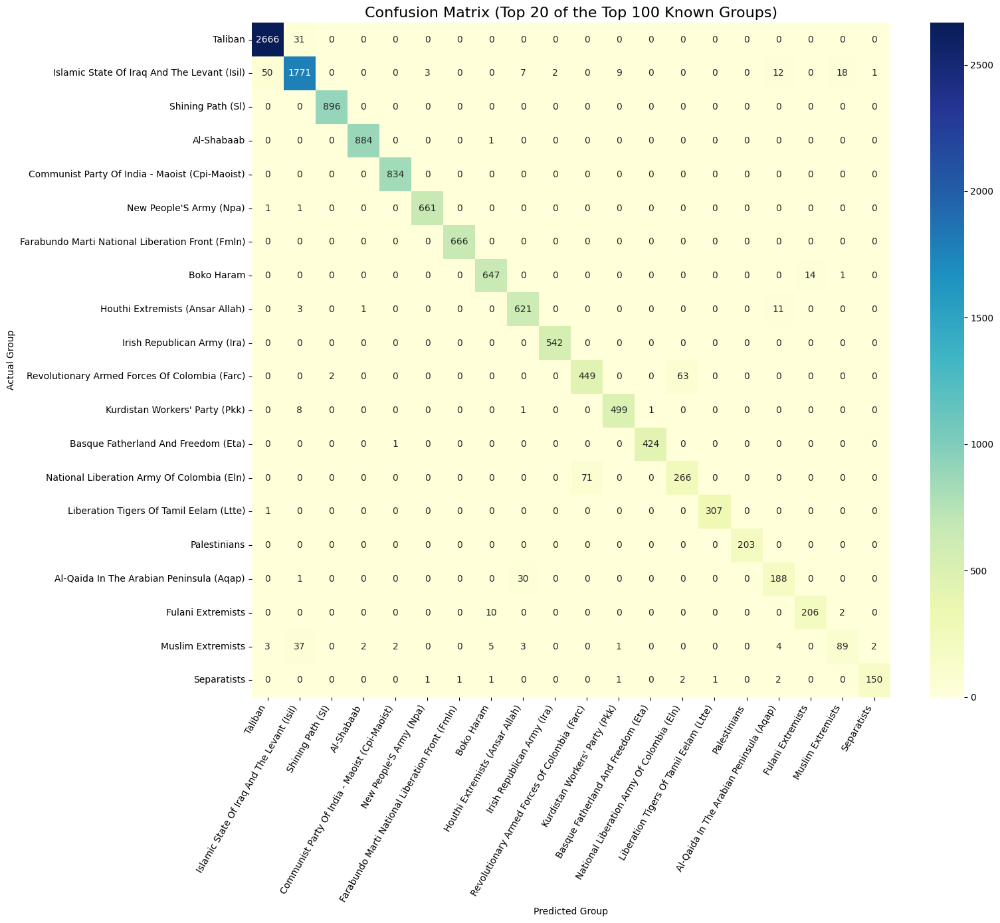

In [1]:
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import joblib
import warnings
from datetime import datetime
import re
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    """Cleans and standardizes the GroupName column."""
    log_message("Standardizing group names...")
    # (Using the same standardization function as before)
    name_map = {
        r'.*al-shabaab.*': 'Al-Shabaab', r'.*al shabaab.*': 'Al-Shabaab',
        r'.*taliban.*': 'Taliban',
        r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*islamic state.*': 'Islamic State of Iraq and the Levant (ISIL)',
        r'.*boko haram.*': 'Boko Haram', r'.*ahlis sunna lidda\'awati.*': 'Boko Haram',
        r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)',
        r'.*new people\'s army.*': 'New People\'s Army (NPA)',
        r'.*shining path.*': 'Shining Path (SL)',
        r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)',
        r'.*irish republican army.*': 'Irish Republican Army (IRA)',
        r'.*eta.*': 'Basque Fatherland and Freedom (ETA)',
        r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)',
        r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)',
        r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)',
        r'.*eln.*': 'National Liberation Army of Colombia (ELN)',
        r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)',
        r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'
    }
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown')
    df['Standardized_Group'].replace(name_map, regex=True, inplace=True)
    known_standard_names = set(name_map.values())
    df['Standardized_Group'] = df.apply(
        lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(),
        axis=1
    )
    df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown')
    df = df.drop(columns=['GroupName'], errors='ignore')
    df = df.rename(columns={'Standardized_Group': 'GroupName'})
    log_message("Group name standardization complete.")
    return df

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Training CatBoost on Top 100 Known Groups script started.")

    # --- 1. Load Data ---
    log_message("Loading the full dataset...")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message(f"Data loaded successfully with {len(df)} records.")

    # --- 2. Standardize Names & Filter for Top N KNOWN Groups ---
    df = standardize_group_names(df)
    log_message("Filtering dataset to include only known groups...")
    df_known = df[df['GroupName'] != 'Unknown'].copy()

    # **MODIFIED**: Focus on Top 100 known groups
    N_TOP_GROUPS = 100
    top_groups_list = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS).index
    df_final = df_known[df_known['GroupName'].isin(top_groups_list)].copy()

    # Filter out groups with only 1 attack (unlikely for Top 100, but good practice)
    group_counts = df_final['GroupName'].value_counts()
    groups_to_keep = group_counts[group_counts > 1].index
    df_final = df_final[df_final['GroupName'].isin(groups_to_keep)].copy()
    num_groups = df_final['GroupName'].nunique()
    log_message(f"Dataset finalized to {len(df_final)} records covering the top {num_groups} known groups (with >1 attack).")

    # --- 3. Prepare Data for Training ---
    log_message("Preparing the final dataset for training...")
    X = df_final.drop('GroupName', axis=1)
    y = df_final['GroupName']

    # Identify categorical features
    categorical_features = ['Country', 'Region', 'AttackType', 'TargetType', 'WeaponType']
    categorical_features_indices = [X.columns.get_loc(col) for col in categorical_features if col in X.columns]
    log_message(f"Identified categorical feature indices: {categorical_features_indices}")

    # Encode the target variable
    le = LabelEncoder()
    y_encoded = le.fit_transform(y)
    joblib.dump(le, f'top_{N_TOP_GROUPS}_known_groups_label_encoder.pkl')
    log_message("Target variable encoded and label encoder saved.")

    # --- 4. Split Data ---
    log_message("Splitting data into training and testing sets...")
    X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(
        X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded
    )
    y_test = le.inverse_transform(y_test_encoded)
    log_message("Data split successfully.")

    # --- 5. Train CatBoost Model ---
    log_message(f"Training CatBoost model on Top {N_TOP_GROUPS} known groups...")
    # Parameters might need slight adjustment compared to Top 20
    model = CatBoostClassifier(
        iterations=500, # Start with 500, maybe increase later if needed
        learning_rate=0.1,
        depth=10,
        loss_function='MultiClass',
        verbose=100,
        cat_features=categorical_features_indices,
        task_type='GPU',
        random_seed=42
    )

    model.fit(X_train, y_train_encoded)
    log_message("Model training complete.")

    # --- 6. Save the Model ---
    log_message("Saving the trained model...")
    model_filename = f'catboost_top_{N_TOP_GROUPS}_known_groups_model.cbm'
    model.save_model(model_filename)
    log_message(f"Model saved as '{model_filename}'.")

    # --- 7. Evaluation ---
    log_message("Evaluating model performance on the test set...")
    y_pred_encoded = model.predict(X_test).flatten()
    y_pred = le.inverse_transform(y_pred_encoded)

    accuracy = accuracy_score(y_test, y_pred)
    # Get labels present in the test set for the report
    present_labels = np.unique(y_test)
    report = classification_report(y_test, y_pred, zero_division=0, labels=present_labels, target_names=present_labels)

    log_message(f"Overall Accuracy on Top {N_TOP_GROUPS} Known Groups: {accuracy:.4f}")
    print("\n--- Classification Report Summary (Full report saved to file) ---")
    report_dict = classification_report(y_test, y_pred, zero_division=0, output_dict=True)
    report_df = pd.DataFrame(report_dict).transpose()
    print("Averages:")
    print(report_df.loc[['accuracy', 'macro avg', 'weighted avg']])
    print("-----------------------------------------------------------------\n")

    # Save the full report to a file
    report_filename = f'classification_report_top_{N_TOP_GROUPS}_known_groups.txt'
    with open(report_filename, 'w') as f:
        f.write(f"Overall Accuracy: {accuracy:.4f}\n\nFull Classification Report (Top {N_TOP_GROUPS}):\n")
        f.write(report)
    log_message(f"Full classification report saved to '{report_filename}'.")

    # --- 8. Optional: Confusion Matrix for Top N classes within this set ---
    log_message(f"Generating confusion matrix for the Top 20 most frequent groups within this Top {N_TOP_GROUPS} set...")
    # Find the top 20 groups *within the current y_test*
    top_n_cm = 20
    counts_in_test = pd.Series(y_test).value_counts()
    top_groups_for_cm = counts_in_test.nlargest(top_n_cm).index.tolist()

    # Filter y_test and y_pred to include only these top groups for a readable CM
    mask = pd.Series(y_test).isin(top_groups_for_cm)
    cm = confusion_matrix(pd.Series(y_test)[mask], pd.Series(y_pred)[mask], labels=top_groups_for_cm)

    plt.figure(figsize=(16, 14))
    sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu',
                xticklabels=top_groups_for_cm, yticklabels=top_groups_for_cm)
    plt.title(f'Confusion Matrix (Top {top_n_cm} of the Top {N_TOP_GROUPS} Known Groups)', fontsize=16)
    plt.ylabel('Actual Group'); plt.xlabel('Predicted Group')
    plt.xticks(rotation=60, ha='right'); plt.yticks(rotation=0)
    plt.tight_layout(); plt.savefig(f'confusion_matrix_top{N_TOP_GROUPS}_known_top20subset.png')
    log_message("Confusion matrix saved.")


    log_message(f"Training on Top {N_TOP_GROUPS} Known Groups script finished.")

In [3]:
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import joblib
import warnings
from datetime import datetime
import re

warnings.filterwarnings('ignore')

# (Include log_message and standardize_group_names functions as defined previously)
def log_message(message):
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    log_message("Standardizing group names...")
    name_map = { r'.*al-shabaab.*': 'Al-Shabaab', r'.*taliban.*': 'Taliban', r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*boko haram.*': 'Boko Haram', r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)', r'.*new people\'s army.*': 'New People\'s Army (NPA)', r'.*shining path.*': 'Shining Path (SL)', r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)', r'.*irish republican army.*': 'Irish Republican Army (IRA)', r'.*eta.*': 'Basque Fatherland and Freedom (ETA)', r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)', r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)', r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)', r'.*eln.*': 'National Liberation Army of Colombia (ELN)', r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)', r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'}
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown'); df['Standardized_Group'].replace(name_map, regex=True, inplace=True); known_standard_names = set(name_map.values()); df['Standardized_Group'] = df.apply(lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(), axis=1); df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown'); df = df.drop(columns=['GroupName'], errors='ignore'); df = df.rename(columns={'Standardized_Group': 'GroupName'}); log_message("Group name standardization complete."); return df


# --- Main Execution ---
if __name__ == "__main__":
    log_message("Training CatBoost to Predict WeaponType script started.")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    df = standardize_group_names(df)

    log_message("Filtering dataset for Top 100 known groups...")
    df_known = df[df['GroupName'] != 'Unknown'].copy()
    N_TOP_GROUPS = 100
    top_groups_list = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS).index
    df_intermediate = df_known[df_known['GroupName'].isin(top_groups_list)].copy()

    # Filter out rows where WeaponType is Unknown or missing
    df_intermediate = df_intermediate[df_intermediate['WeaponType'] != 'Unknown'].dropna(subset=['WeaponType'])

    # --- **FIX APPLIED HERE** ---
    log_message("Filtering out WeaponTypes that appear only once...")
    weapon_counts = df_intermediate['WeaponType'].value_counts()
    weapons_to_keep = weapon_counts[weapon_counts > 1].index
    df_final = df_intermediate[df_intermediate['WeaponType'].isin(weapons_to_keep)].copy()
    # --- End Fix ---

    num_groups = df_final['GroupName'].nunique()
    num_weapons = df_final['WeaponType'].nunique()
    log_message(f"Dataset finalized to {len(df_final)} records covering {num_groups} groups and {num_weapons} weapon types (with >1 instance).")

    log_message("Preparing data: Target = WeaponType")
    feature_cols = ['GroupName', 'Region', 'Year', 'TargetType', 'AttackType', 'suicide', 'Latitude', 'Longitude', 'Country']
    target_col = 'WeaponType'
    X = df_final[feature_cols].copy()
    y = df_final[target_col].copy()

    categorical_features_input = ['GroupName', 'Region', 'TargetType', 'AttackType', 'Country']
    categorical_features_indices = [X.columns.get_loc(col) for col in categorical_features_input if col in X.columns]

    weapon_le = LabelEncoder()
    y_encoded = weapon_le.fit_transform(y)
    joblib.dump(weapon_le, 'weapon_type_label_encoder.pkl')
    log_message("Target variable (WeaponType) encoded.")

    log_message("Splitting data...")
    X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(
        X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded # Stratify should now work
    )
    y_test_weapon = weapon_le.inverse_transform(y_test_encoded)
    log_message("Data split successfully.")

    log_message(f"Training CatBoost model to predict {target_col}...")
    model = CatBoostClassifier(iterations=500, learning_rate=0.1, depth=10, loss_function='MultiClass', verbose=100, cat_features=categorical_features_indices, task_type='GPU', random_seed=42)
    model.fit(X_train, y_train_encoded)
    log_message("Model training complete.")

    model_filename = 'catboost_predict_weapon_model.cbm'
    model.save_model(model_filename)
    log_message(f"Model saved as '{model_filename}'.")

    log_message("Evaluating model performance...")
    y_pred_encoded = model.predict(X_test).flatten()
    y_pred_weapon = weapon_le.inverse_transform(y_pred_encoded)
    accuracy = accuracy_score(y_test_weapon, y_pred_weapon)
    # Ensure labels for report match the actual unique values in y_test_weapon + y_pred_weapon
    report_labels = sorted(list(set(y_test_weapon) | set(y_pred_weapon)))
    report = classification_report(y_test_weapon, y_pred_weapon, zero_division=0, labels=report_labels, target_names=report_labels)
    log_message(f"Overall Accuracy predicting WeaponType: {accuracy:.4f}")
    report_filename = f'classification_report_predict_weapon.txt'
    with open(report_filename, 'w') as f: f.write(f"Accuracy: {accuracy:.4f}\n\nReport:\n{report}")
    log_message(f"Report saved to '{report_filename}'.")
    log_message("Training script for predicting WeaponType finished.")

[2025-10-25 07:43:05] Training CatBoost to Predict WeaponType script started.
[2025-10-25 07:43:05] Standardizing group names...
[2025-10-25 07:43:12] Group name standardization complete.
[2025-10-25 07:43:12] Filtering dataset for Top 100 known groups...
[2025-10-25 07:43:12] Filtering out WeaponTypes that appear only once...
[2025-10-25 07:43:12] Dataset finalized to 79235 records covering 100 groups and 9 weapon types (with >1 instance).
[2025-10-25 07:43:12] Preparing data: Target = WeaponType
[2025-10-25 07:43:12] Target variable (WeaponType) encoded.
[2025-10-25 07:43:12] Splitting data...
[2025-10-25 07:43:12] Data split successfully.
[2025-10-25 07:43:12] Training CatBoost model to predict WeaponType...
0:	learn: 1.5950133	total: 171ms	remaining: 1m 25s
100:	learn: 0.2325788	total: 6.34s	remaining: 25.1s
200:	learn: 0.2067601	total: 12.7s	remaining: 18.9s
300:	learn: 0.1877229	total: 19s	remaining: 12.5s
400:	learn: 0.1733937	total: 25.3s	remaining: 6.24s
499:	learn: 0.1612120	

In [4]:
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import joblib
import warnings
from datetime import datetime
import re

warnings.filterwarnings('ignore')

# (Include log_message and standardize_group_names functions as defined previously)
def log_message(message):
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    log_message("Standardizing group names...")
    name_map = { r'.*al-shabaab.*': 'Al-Shabaab', r'.*taliban.*': 'Taliban', r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*boko haram.*': 'Boko Haram', r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)', r'.*new people\'s army.*': 'New People\'s Army (NPA)', r'.*shining path.*': 'Shining Path (SL)', r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)', r'.*irish republican army.*': 'Irish Republican Army (IRA)', r'.*eta.*': 'Basque Fatherland and Freedom (ETA)', r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)', r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)', r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)', r'.*eln.*': 'National Liberation Army of Colombia (ELN)', r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)', r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'}
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown'); df['Standardized_Group'].replace(name_map, regex=True, inplace=True); known_standard_names = set(name_map.values()); df['Standardized_Group'] = df.apply(lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(), axis=1); df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown'); df = df.drop(columns=['GroupName'], errors='ignore'); df = df.rename(columns={'Standardized_Group': 'GroupName'}); log_message("Group name standardization complete."); return df


# --- Main Execution ---
if __name__ == "__main__":
    log_message("Training CatBoost to Predict AttackType script started.")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    df = standardize_group_names(df)

    log_message("Filtering dataset for Top 100 known groups...")
    df_known = df[df['GroupName'] != 'Unknown'].copy()
    N_TOP_GROUPS = 100
    top_groups_list = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS).index
    df_final = df_known[df_known['GroupName'].isin(top_groups_list)].copy()
    df_final = df_final[df_final['AttackType'] != 'Unknown'].dropna(subset=['AttackType']) # Target cannot be unknown
    log_message(f"Dataset finalized to {len(df_final)} records.")

    log_message("Preparing data: Target = AttackType")
    feature_cols = ['GroupName', 'Region', 'Year', 'TargetType', 'WeaponType', 'suicide', 'Latitude', 'Longitude', 'Country'] # Added Country
    target_col = 'AttackType'
    X = df_final[feature_cols].copy()
    y = df_final[target_col].copy()

    categorical_features_input = ['GroupName', 'Region', 'TargetType', 'WeaponType', 'Country'] # Added Country
    categorical_features_indices = [X.columns.get_loc(col) for col in categorical_features_input if col in X.columns]

    attack_le = LabelEncoder()
    y_encoded = attack_le.fit_transform(y)
    joblib.dump(attack_le, 'attack_type_label_encoder.pkl')
    log_message("Target variable (AttackType) encoded.")

    X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
    y_test_attack = attack_le.inverse_transform(y_test_encoded)

    log_message(f"Training CatBoost model to predict {target_col}...")
    model = CatBoostClassifier(iterations=500, learning_rate=0.1, depth=10, loss_function='MultiClass', verbose=100, cat_features=categorical_features_indices, task_type='GPU', random_seed=42)
    model.fit(X_train, y_train_encoded)

    model_filename = 'catboost_predict_attacktype_model.cbm'
    model.save_model(model_filename)
    log_message(f"Model saved as '{model_filename}'.")

    log_message("Evaluating model performance...")
    y_pred_encoded = model.predict(X_test).flatten()
    y_pred_attack = attack_le.inverse_transform(y_pred_encoded)
    accuracy = accuracy_score(y_test_attack, y_pred_attack)
    report = classification_report(y_test_attack, y_pred_attack, zero_division=0)
    log_message(f"Overall Accuracy predicting AttackType: {accuracy:.4f}")
    report_filename = f'classification_report_predict_attacktype.txt'
    with open(report_filename, 'w') as f: f.write(f"Accuracy: {accuracy:.4f}\n\nReport:\n{report}")
    log_message(f"Report saved to '{report_filename}'.")
    log_message("Training script for predicting AttackType finished.")

[2025-10-25 07:48:23] Training CatBoost to Predict AttackType script started.
[2025-10-25 07:48:24] Standardizing group names...
[2025-10-25 07:48:30] Group name standardization complete.
[2025-10-25 07:48:30] Filtering dataset for Top 100 known groups...
[2025-10-25 07:48:30] Dataset finalized to 84087 records.
[2025-10-25 07:48:30] Preparing data: Target = AttackType
[2025-10-25 07:48:30] Target variable (AttackType) encoded.
[2025-10-25 07:48:30] Training CatBoost model to predict AttackType...
0:	learn: 1.6684838	total: 112ms	remaining: 56s
100:	learn: 0.4703367	total: 5.98s	remaining: 23.6s
200:	learn: 0.4244651	total: 11.7s	remaining: 17.4s
300:	learn: 0.3920288	total: 17.8s	remaining: 11.8s
400:	learn: 0.3644142	total: 23.8s	remaining: 5.88s
499:	learn: 0.3423320	total: 30s	remaining: 0us
[2025-10-25 07:49:01] Model saved as 'catboost_predict_attacktype_model.cbm'.
[2025-10-25 07:49:01] Evaluating model performance...
[2025-10-25 07:49:02] Overall Accuracy predicting AttackType:

In [5]:
import pandas as pd
from catboost import CatBoostClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import joblib
import warnings
from datetime import datetime
import re

warnings.filterwarnings('ignore')

# (Include log_message and standardize_group_names functions as defined previously)
def log_message(message):
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

def standardize_group_names(df):
    log_message("Standardizing group names...")
    name_map = { r'.*al-shabaab.*': 'Al-Shabaab', r'.*taliban.*': 'Taliban', r'.*isil.*': 'Islamic State of Iraq and the Levant (ISIL)', r'.*boko haram.*': 'Boko Haram', r'.*cpi-maoist.*': 'Communist Party of India - Maoist (CPI-Maoist)', r'^maoists$': 'Communist Party of India - Maoist (CPI-Maoist)', r'.*new people\'s army.*': 'New People\'s Army (NPA)', r'.*shining path.*': 'Shining Path (SL)', r'.*farc.*': 'Revolutionary Armed Forces of Colombia (FARC)', r'.*irish republican army.*': 'Irish Republican Army (IRA)', r'.*eta.*': 'Basque Fatherland and Freedom (ETA)', r'.*pkk.*': 'Kurdistan Workers\' Party (PKK)', r'.*ltte.*': 'Liberation Tigers of Tamil Eelam (LTTE)', r'.*fmln.*': 'Farabundo Marti National Liberation Front (FMLN)', r'.*eln.*': 'National Liberation Army of Colombia (ELN)', r'.*ttp.*': 'Tehrik-i-Taliban Pakistan (TTP)', r'.*aqap.*': 'Al-Qaida in the Arabian Peninsula (AQAP)'}
    df['Standardized_Group'] = df['GroupName'].str.lower().fillna('unknown'); df['Standardized_Group'].replace(name_map, regex=True, inplace=True); known_standard_names = set(name_map.values()); df['Standardized_Group'] = df.apply(lambda row: row['Standardized_Group'] if row['Standardized_Group'] in known_standard_names else row['GroupName'].title(), axis=1); df['Standardized_Group'] = df['Standardized_Group'].fillna('Unknown').apply(lambda x: x.title() if isinstance(x, str) else 'Unknown'); df = df.drop(columns=['GroupName'], errors='ignore'); df = df.rename(columns={'Standardized_Group': 'GroupName'}); log_message("Group name standardization complete."); return df


# --- Main Execution ---
if __name__ == "__main__":
    log_message("Training CatBoost to Predict TargetType script started.")
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    df = standardize_group_names(df)

    log_message("Filtering dataset for Top 100 known groups...")
    df_known = df[df['GroupName'] != 'Unknown'].copy()
    N_TOP_GROUPS = 100
    top_groups_list = df_known['GroupName'].value_counts().nlargest(N_TOP_GROUPS).index
    df_final = df_known[df_known['GroupName'].isin(top_groups_list)].copy()
    df_final = df_final[df_final['TargetType'] != 'Unknown'].dropna(subset=['TargetType']) # Target cannot be unknown
    log_message(f"Dataset finalized to {len(df_final)} records.")

    log_message("Preparing data: Target = TargetType")
    feature_cols = ['GroupName', 'Region', 'Year', 'AttackType', 'WeaponType', 'suicide', 'Latitude', 'Longitude', 'Country'] # Added Country
    target_col = 'TargetType'
    X = df_final[feature_cols].copy()
    y = df_final[target_col].copy()

    categorical_features_input = ['GroupName', 'Region', 'AttackType', 'WeaponType', 'Country'] # Added Country
    categorical_features_indices = [X.columns.get_loc(col) for col in categorical_features_input if col in X.columns]

    target_le = LabelEncoder()
    y_encoded = target_le.fit_transform(y)
    joblib.dump(target_le, 'target_type_label_encoder.pkl')
    log_message("Target variable (TargetType) encoded.")

    X_train, X_test, y_train_encoded, y_test_encoded = train_test_split(X, y_encoded, test_size=0.2, random_state=42, stratify=y_encoded)
    y_test_target = target_le.inverse_transform(y_test_encoded)

    log_message(f"Training CatBoost model to predict {target_col}...")
    model = CatBoostClassifier(iterations=500, learning_rate=0.1, depth=10, loss_function='MultiClass', verbose=100, cat_features=categorical_features_indices, task_type='GPU', random_seed=42)
    model.fit(X_train, y_train_encoded)

    model_filename = 'catboost_predict_targettype_model.cbm'
    model.save_model(model_filename)
    log_message(f"Model saved as '{model_filename}'.")

    log_message("Evaluating model performance...")
    y_pred_encoded = model.predict(X_test).flatten()
    y_pred_target = target_le.inverse_transform(y_pred_encoded)
    accuracy = accuracy_score(y_test_target, y_pred_target)
    report = classification_report(y_test_target, y_pred_target, zero_division=0)
    log_message(f"Overall Accuracy predicting TargetType: {accuracy:.4f}")
    report_filename = f'classification_report_predict_targettype.txt'
    with open(report_filename, 'w') as f: f.write(f"Accuracy: {accuracy:.4f}\n\nReport:\n{report}")
    log_message(f"Report saved to '{report_filename}'.")
    log_message("Training script for predicting TargetType finished.")

[2025-10-25 07:52:31] Training CatBoost to Predict TargetType script started.
[2025-10-25 07:52:31] Standardizing group names...
[2025-10-25 07:52:37] Group name standardization complete.
[2025-10-25 07:52:37] Filtering dataset for Top 100 known groups...
[2025-10-25 07:52:38] Dataset finalized to 89737 records.
[2025-10-25 07:52:38] Preparing data: Target = TargetType
[2025-10-25 07:52:38] Target variable (TargetType) encoded.
[2025-10-25 07:52:38] Training CatBoost model to predict TargetType...
0:	learn: 2.6713228	total: 238ms	remaining: 1m 58s
100:	learn: 1.4485730	total: 13.7s	remaining: 54.1s
200:	learn: 1.3449081	total: 26.9s	remaining: 40.1s
300:	learn: 1.2671443	total: 40.5s	remaining: 26.8s
400:	learn: 1.2085896	total: 54.3s	remaining: 13.4s
499:	learn: 1.1605778	total: 1m 8s	remaining: 0us
[2025-10-25 07:53:47] Model saved as 'catboost_predict_targettype_model.cbm'.
[2025-10-25 07:53:47] Evaluating model performance...
[2025-10-25 07:53:48] Overall Accuracy predicting Target

[2025-11-01 04:18:31] Generating Known vs. Unknown pie chart...
[2025-11-01 04:18:31] Data loaded successfully.
[2025-11-01 04:18:31] Pie chart saved as 'known_vs_unknown_pie_chart.png'.
[2025-11-01 04:18:31] Script finished.


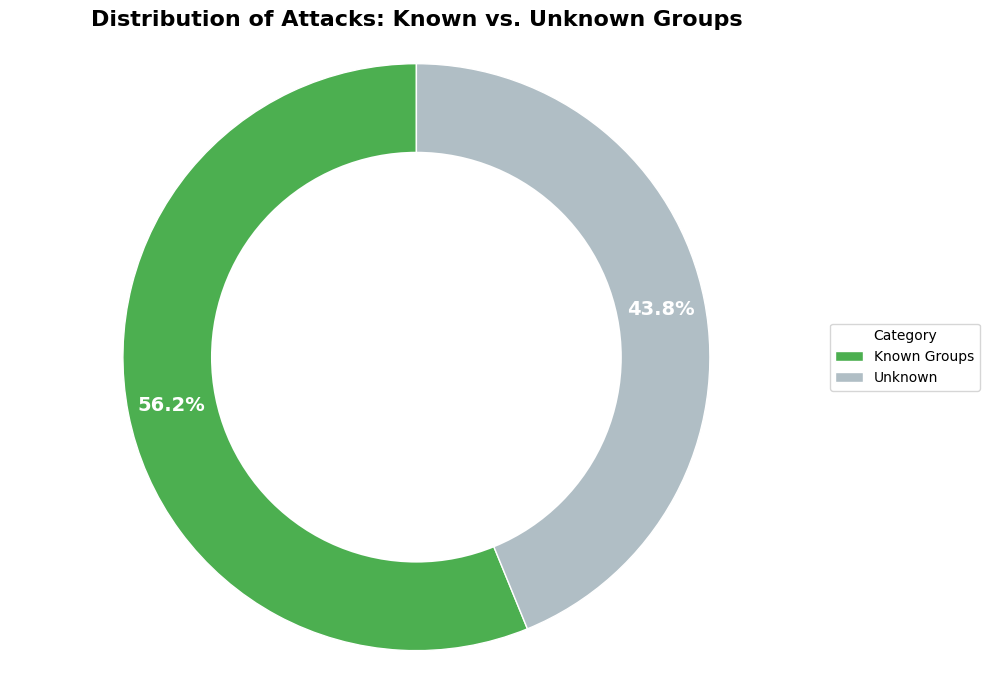

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Generating Known vs. Unknown pie chart...")

# Load data
try:
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message("Data loaded successfully.")
except FileNotFoundError:
    log_message("ERROR: 'Cleaned Dataset/globalterrorismdb_cleaned.csv' not found.")
    exit()

# Calculate counts
known_count = len(df[df['GroupName'] != 'Unknown'])
unknown_count = len(df[df['GroupName'] == 'Unknown'])
total = len(df)

# Prepare data for the pie chart
labels = ['Known Groups', 'Unknown']
sizes = [known_count, unknown_count]
percentages = [f'{(known_count/total)*100:.1f}%', f'{(unknown_count/total)*100:.1f}%']
colors = ['#4CAF50', '#B0BEC5'] # Green for Known, Grey for Unknown

# Create the plot
plt.figure(figsize=(10, 7))
patches, texts, autotexts = plt.pie(
    sizes,
    colors=colors,
    autopct='%1.1f%%',
    startangle=90,
    pctdistance=0.85,
    wedgeprops={'edgecolor': 'white'}
)

# Improve text appearance
for text in texts:
    text.set_color('black')
    text.set_fontsize(12)
for autotext in autotexts:
    autotext.set_color('white')
    autotext.set_fontweight('bold')
    autotext.set_fontsize(14)

# Add a circle at the center to make it a donut chart
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title('Distribution of Attacks: Known vs. Unknown Groups', fontsize=16, fontweight='bold')
plt.legend(labels, title="Category", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.axis('equal') # Equal aspect ratio ensures that pie is drawn as a circle.
plt.tight_layout()

# Save the plot
output_filename = 'known_vs_unknown_pie_chart.png'
plt.savefig(output_filename, bbox_inches='tight')
log_message(f"Pie chart saved as '{output_filename}'.")
log_message("Script finished.")

[2025-11-01 04:25:43] Generating Known vs. Unknown pie chart (for presentation)...
[2025-11-01 04:25:43] Data loaded successfully.
[2025-11-01 04:25:43] Pie chart saved as 'known_vs_unknown_pie_chart.png' with a transparent background.
[2025-11-01 04:25:43] Script finished.


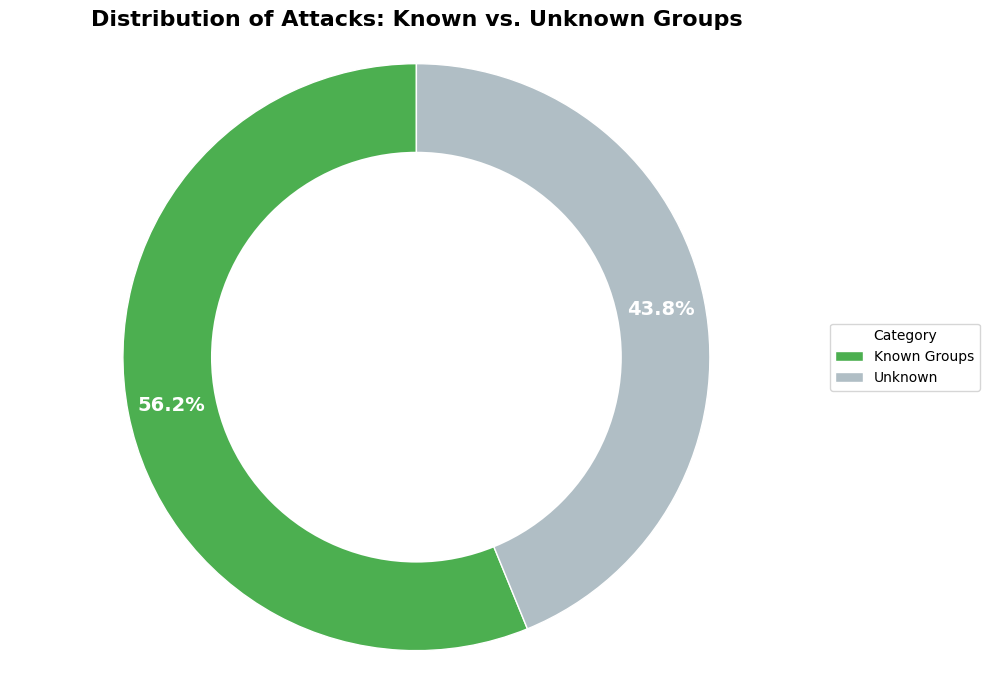

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings

warnings.filterwarnings('ignore')

def log_message(message):
    """Prints a message with a timestamp."""
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

log_message("Generating Known vs. Unknown pie chart (for presentation)...")

# Load data
try:
    # Make sure this path is correct in your environment
    df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
    log_message("Data loaded successfully.")
except FileNotFoundError:
    log_message("ERROR: 'Cleaned Dataset/globalterrorismdb_cleaned.csv' not found.")
    log_message("Please ensure the file is in the 'Cleaned Dataset' folder.")
    exit()

# Calculate counts
known_count = len(df[df['GroupName'] != 'Unknown'])
unknown_count = len(df[df['GroupName'] == 'Unknown'])
total = len(df)

# Prepare data for the pie chart
labels = ['Known Groups', 'Unknown']
sizes = [known_count, unknown_count]
percentages = [f'{(known_count/total)*100:.1f}%', f'{(unknown_count/total)*100:.1f}%']
colors = ['#4CAF50', '#B0BEC5'] # Green for Known, Grey for Unknown

# Create the plot
plt.figure(figsize=(10, 7))
patches, texts, autotexts = plt.pie(
    sizes,
    colors=colors,
    autopct='%1.1f%%',
    startangle=90,
    pctdistance=0.85,
    wedgeprops={'edgecolor': 'white'}
)

# Improve text appearance
for text in texts:
    text.set_color('black')
    text.set_fontsize(12)
for autotext in autotexts:
    autotext.set_color('white')
    autotext.set_fontweight('bold')
    autotext.set_fontsize(14)

# Add a circle at the center to make it a donut chart
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title('Distribution of Attacks: Known vs. Unknown Groups', fontsize=16, fontweight='bold')
plt.legend(labels, title="Category", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))
plt.axis('equal') # Equal aspect ratio ensures that pie is drawn as a circle.
plt.tight_layout()

# Save the plot
output_filename = 'known_vs_unknown_pie_chart.png'
# **NEW**: Save with a transparent background for presentations
plt.savefig(output_filename, bbox_inches='tight', transparent=True)
log_message(f"Pie chart saved as '{output_filename}' with a transparent background.")
log_message("Script finished.")


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from datetime import datetime
import warnings
import re

warnings.filterwarnings('ignore')

def log_message(message):
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {message}")

# --- Main Execution ---
if __name__ == "__main__":
    log_message("Generating EDA plots (for Slide 3)...")
    
    # Load data
    try:
        df = pd.read_csv('/kaggle/input/globalterrorismdata/globalterrorismdb_cleaned.csv', encoding='ISO-8859-1')
        log_message("Data loaded successfully.")
    except FileNotFoundError:
        log_message("ERROR: 'Cleaned Dataset/globalterrorismdb_cleaned.csv' not found.")
        exit()

    # --- 1. Generate Time Series Line Chart ---
    log_message("Generating time series line chart...")
    plt.figure(figsize=(15, 7))
    df['Year'].value_counts().sort_index().plot(kind='line', color='crimson')
    plt.title('Global Terrorist Attacks per Year (1970-2020)', fontsize=16)
    plt.xlabel('Year')
    plt.ylabel('Number of Attacks')
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.savefig('global_attacks_timeseries.png', transparent=True, bbox_inches='tight')
    log_message("Time series plot saved as 'global_attacks_timeseries.png'.")
    plt.close()

    # --- 2. Generate World Map HTML ---
    log_message("Generating interactive world map...")
    df_map = df.dropna(subset=['Latitude', 'Longitude']).copy()
    
    fig = px.scatter_mapbox(
        df_map,
        lat="Latitude",
        lon="Longitude",
        hover_name="Country",
        hover_data={"Year": True, "GroupName": True},
        mapbox_style="carto-dark",
        zoom=1,
        center={"lat": 20, "lon": 0},
        title="Global Terrorist Attack Hotspots (1970-2020)",
        opacity=0.5
    )
    fig.update_layout(
        margin={"r":0,"t":40,"l":0,"b":0},
        mapbox=dict(center=dict(lat=20, lon=0), zoom=1)
    )
    
    output_html_file = "world_attack_map.html"
    fig.write_html(output_html_file)
    log_message(f"Interactive world map saved as '{output_html_file}'. Take a screenshot of this file.")

    log_message("Script finished.")


[2025-11-01 04:51:18] Generating EDA plots (for Slide 3)...
[2025-11-01 04:51:18] Data loaded successfully.
[2025-11-01 04:51:18] Generating time series line chart...
[2025-11-01 04:51:18] Time series plot saved as 'global_attacks_timeseries.png'.
[2025-11-01 04:51:18] Generating interactive world map...
[2025-11-01 04:51:21] Interactive world map saved as 'world_attack_map.html'. Take a screenshot of this file.
[2025-11-01 04:51:21] Script finished.
